In [50]:
from ultralytics import SAM

# Load a model
model = SAM("sam_b.pt")

# Display model information (optional)
model.info()


Model summary: 173 layers, 93,735,472 parameters, 93,735,472 gradients


(173, 93735472, 93735472, 0.0)

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import ffmpeg
import shutil


def extract_frames(video_path, output_folder, interval):
    os.makedirs(output_folder, exist_ok=True)
    ffmpeg.input(video_path, ss=0).output(
        f"{output_folder}frame_%03d.png", vf=f"fps=1/{interval}"
    ).run()

def medial_axis_transform(binary_image):
    binary = (binary_image > 0).astype(np.uint8) * 255
    kernel = cv2.getStructuringElement(cv2.MORPH_CROSS, (3,3))
    skeleton = np.zeros(binary.shape, dtype=np.uint8)
    temp = binary.copy()
    
    while cv2.countNonZero(temp) > 0:
        eroded = cv2.erode(temp, kernel)
        opened = cv2.dilate(eroded, kernel)
        subtract = cv2.subtract(temp, opened)
        skeleton = cv2.bitwise_or(skeleton, subtract)
        temp = eroded.copy()
    
    return skeleton

def create_SAM_mask(image_path, point):
    frame =  cv2.imread(image_path)
    results = model(image_path, points=point, labels=[1])
    b_mask = np.zeros(frame.shape[:2], np.uint8)

    contour = results[0].masks.xy.pop()
    contour = contour.astype(np.int32)
    contour = contour.reshape(-1, 1, 2)
    _ = cv2.drawContours(b_mask, [contour], -1, (255, 255, 255), cv2.FILLED)
    
    return b_mask

def compute_distance_map(skeleton, point):
    skeleton_binary = (skeleton > 0).astype(np.uint8)
    y, x = np.indices(skeleton_binary.shape)
    distance_map = np.sqrt(
        (x - point[0])**2 + 
        (y - point[1])**2
    )
    display_map = np.zeros_like(distance_map, dtype=np.float32)
    display_map[skeleton_binary > 0] = distance_map[skeleton_binary > 0]
    return display_map
    
def track_actuator_tip(
    frame_folder,
    start_frame,
    anchor_point,
    output_file,
    end_frame=None,
    maximum_tip_travel_between_frames = 50 * 10,
    edge_cushion =60, # cushion the edges of the image since SAM defines masks there too
    tip_margin=1,
):
    frames = sorted(
        [
            os.path.join(frame_folder, f)
            for f in os.listdir(frame_folder)
            if f.endswith((".png", ".jpg"))
        ]
    )

    start_frame = max(0, start_frame)
    end_frame = min(len(frames), end_frame if end_frame is not None else len(frames))
    print(f"Analyzing frames {start_frame} to {end_frame-1}")
    print(f"Total frames used: {end_frame - start_frame}")

    frames = frames[start_frame:end_frame]

    tip_positions = []
    frame_times = []
    prev_corner = None

    plt.figure(figsize=(12, 10))
    wandering_point = anchor_point
    for i, frame_path in enumerate(frames):
        frame = cv2.imread(frame_path)
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        b_mask = create_SAM_mask(frame_path, wandering_point)
        total_image_y_len, total_image_x_len = b_mask.shape
    
        # Extract white pixels (y, x format)
        white_pixels = np.column_stack(np.where(b_mask == 255))
        # Keep the wandering point at the top of the finger of bacterial leather
        filtered_pixels = white_pixels[
            (white_pixels[:, 1] >= edge_cushion) & 
            (white_pixels[:, 1] <= total_image_x_len - edge_cushion) &
            (white_pixels[:, 0] >= 0) & 
            (white_pixels[:, 0] <= edge_cushion)
        ]
        cy, cx = np.mean(filtered_pixels, axis=0).astype(int)
        

        kernel = np.ones((3,3), np.uint8)
        cleaned_b_mask = cv2.morphologyEx(b_mask, cv2.MORPH_OPEN, kernel, iterations=5)
        skeleton = medial_axis_transform(cleaned_b_mask)
        distance_map = compute_distance_map(skeleton, wandering_point)
        result = frame_rgb.copy()
        tip_point = NotImplementedError

        # Create a figure with subplots for visualization
        fig, axes = plt.subplots(2, 3, figsize=(15, 10))

        axes[0, 0].imshow(frame_rgb)
        axes[0, 0].set_title("Frame")
        axes[0, 0].axis("off")
        axes[0, 1].imshow(frame_rgb)  
        axes[0, 1].set_title("Frame with Point Selected")
        size = 10  # Size of the "X"
        thickness = 2  # Thickness of the lines
        axes[0, 1].plot([wandering_point[0] - size, wandering_point[0] + size], 
                        [wandering_point[1] - size, wandering_point[1] + size], 
                        color='green', linewidth=thickness)
        axes[0, 1].plot([wandering_point[0] - size, wandering_point[0] + size], 
                        [wandering_point[1] + size, wandering_point[1] - size], 
                        color='green', linewidth=thickness)
        axes[0, 1].axis('off')
        axes[0, 2].imshow(b_mask, cmap="gray")
        axes[0, 2].set_title("Binary Mask")
        axes[0, 2].axis("off")
        axes[1, 0].imshow(cleaned_b_mask, cmap="gray")
        axes[1, 0].set_title("Cleaned Binary Mask")
        axes[1, 0].axis("off")
        axes[1, 1].imshow(skeleton, cmap="gray")
        axes[1, 1].set_title("Skeleton")
        axes[1, 1].axis("off")
        axes[1, 2].imshow(distance_map)
        axes[1, 2].set_title("Distance Mapped Skeleton")
        axes[1, 2].axis("off")
        plt.tight_layout()
        plt.show()
        wandering_point = (cx, cy)
        
        if i == 0:
            max_distance = np.max(distance_map)
            max_points = np.column_stack(np.where(distance_map == max_distance))
            # Filter points within a small margin of the maximum distance
            near_max_points = max_points[distance_map[max_points[:, 0], max_points[:, 1]] >= (max_distance - tip_margin)]

            # Select the bottom-right point among these near-max points
            prev_corner = near_max_points[
                np.lexsort((near_max_points[:, 1], near_max_points[:, 0]))[-1]
            ][::-1]  # Convert to (x, y)

            tip_point = tuple(prev_corner)

        else:
            # Find the point with maximum distance within a search window
            # centered around the previous point
            x, y = prev_corner
            
            # Define search window
            y_min = max(edge_cushion, y - maximum_tip_travel_between_frames // 2)
            y_max = min(distance_map.shape[0] - edge_cushion, y + maximum_tip_travel_between_frames // 2)
            x_min = max(edge_cushion, x - maximum_tip_travel_between_frames // 2)
            x_max = min(distance_map.shape[1] - edge_cushion, x + maximum_tip_travel_between_frames // 2)
            
            # Crop the distance map to the search window
            window = distance_map[y_min:y_max, x_min:x_max]
            
            # Find the maximum point in the window
            if np.any(~np.isnan(window)):
                # Find max points within the window
                max_window_distance = np.max(window)
                max_window_points = np.column_stack(np.where(window == max_window_distance))
                
                # Filter points within a small margin of the maximum distance
                near_max_window_points = max_window_points[window[max_window_points[:, 0], max_window_points[:, 1]] >= (max_window_distance - tip_margin)]
                
                # Select the bottom-right point among these near-max points
                local_max_idx = near_max_window_points[
                    np.lexsort((near_max_window_points[:, 1], near_max_window_points[:, 0]))[-1]
                ]
                
                # Translate local coordinates back to full image coordinates
                tip_point = (
                    x_min + local_max_idx[1], 
                    y_min + local_max_idx[0]
                )
                prev_corner = tip_point
            else:
                raise Exception("No valid points found in search window")

        if tip_point is not None:
            cv2.circle(result, tip_point, 5, (0, 0, 255), -1)

        if tip_point is not None:
            tip_positions.append(tip_point)
            frame_times.append(i)
            cv2.circle(result, tuple(tip_point), 10, (255, 0, 0), -1)
            cv2.putText(
                result,
                f"Tip ({tip_point[0]}, {tip_point[1]})",
                (tip_point[0] + 15, tip_point[1]),
                cv2.FONT_HERSHEY_SIMPLEX,
                0.7,
                (255, 0, 0),
                2,
            )

        plt.figure(figsize=(12, 5))
        plt.subplot(1, 2, 1)
        plt.imshow(result)
        plt.title(f"Frame {i} - Detected Tip")
        plt.axis("off")

        if len(tip_positions) > 1:
            tip_array = np.array(tip_positions)
            plt.subplot(1, 2, 2)
            plt.plot(tip_array[:, 0], tip_array[:, 1], "b-o")
            plt.scatter(tip_array[-1, 0], tip_array[-1, 1], color="red", s=100)
            plt.gca().invert_yaxis()
            plt.title("Tip Trajectory")
            plt.xlabel("X Position (pixels)")
            plt.ylabel("Y Position (pixels)")
            plt.grid(True)

        plt.tight_layout()
        plt.draw()
        plt.pause(0.1)
        plt.close()

    if tip_positions:
        tip_array = np.array(tip_positions)
        np.savetxt(
            output_file,
            np.column_stack((frame_times, tip_array)),
            delimiter=",",
            header="minutes,x,y",
            comments="",
        )

        plt.figure(figsize=(10, 8))
        plt.plot(tip_array[:, 0], tip_array[:, 1], "b-o")
        plt.gca().invert_yaxis()
        plt.title("Complete Tip Trajectory")
        plt.xlabel("X Position (pixels)")
        plt.ylabel("Y Position (pixels)")
        plt.grid(True)
        plt.savefig("tip_trajectory.png")
        plt.show()

    return tip_positions, frame_times

ffmpeg version 7.0.1 Copyright (c) 2000-2024 the FFmpeg developers
  built with Apple clang version 15.0.0 (clang-1500.3.9.4)
  configuration: --prefix=/usr/local/Cellar/ffmpeg/7.0.1 --enable-shared --enable-pthreads --enable-version3 --cc=clang --host-cflags= --host-ldflags='-Wl,-ld_classic' --enable-ffplay --enable-gnutls --enable-gpl --enable-libaom --enable-libaribb24 --enable-libbluray --enable-libdav1d --enable-libharfbuzz --enable-libjxl --enable-libmp3lame --enable-libopus --enable-librav1e --enable-librist --enable-librubberband --enable-libsnappy --enable-libsrt --enable-libssh --enable-libsvtav1 --enable-libtesseract --enable-libtheora --enable-libvidstab --enable-libvmaf --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lzma --enable-libfontconfig --enable-libfreetype --enable-frei0r --enable-libass --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-libspeex --ena

Analyzing frames 3 to 97
Total frames used: 95



[out#0/image2 @ 0x7ff548b04b40] video:8882KiB audio:0KiB subtitle:0KiB other streams:0KiB global headers:0KiB muxing overhead: unknown
frame=   98 fps=0.0 q=-0.0 Lsize=N/A time=00:00:58.80 bitrate=N/A speed= 115x    


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_004.png: 1024x1024 1 0, 13189.9ms
Speed: 96.2ms preprocess, 13189.9ms inference, 23.2ms postprocess per image at shape (1, 3, 1024, 1024)


<Figure size 1200x1000 with 0 Axes>

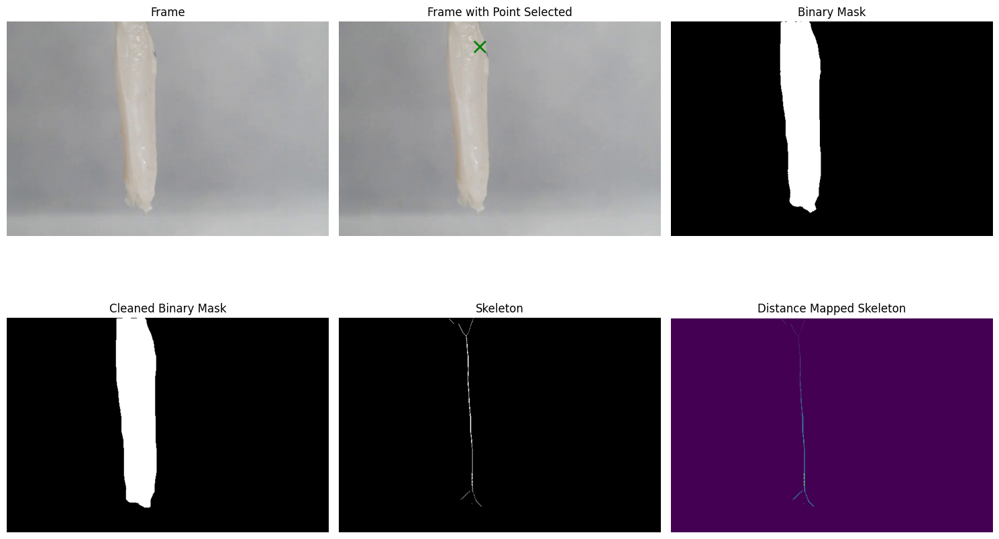

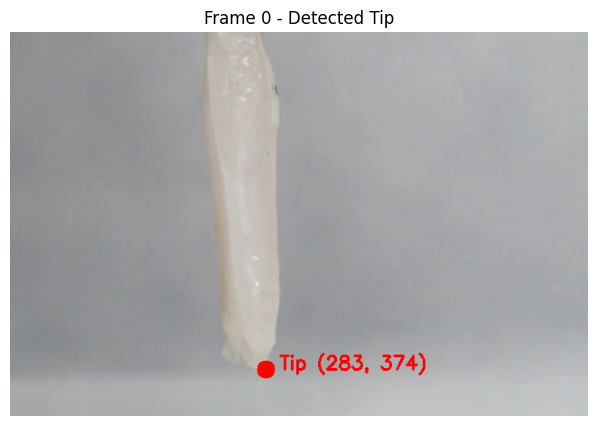


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_005.png: 1024x1024 1 0, 8120.5ms
Speed: 20.6ms preprocess, 8120.5ms inference, 1.3ms postprocess per image at shape (1, 3, 1024, 1024)


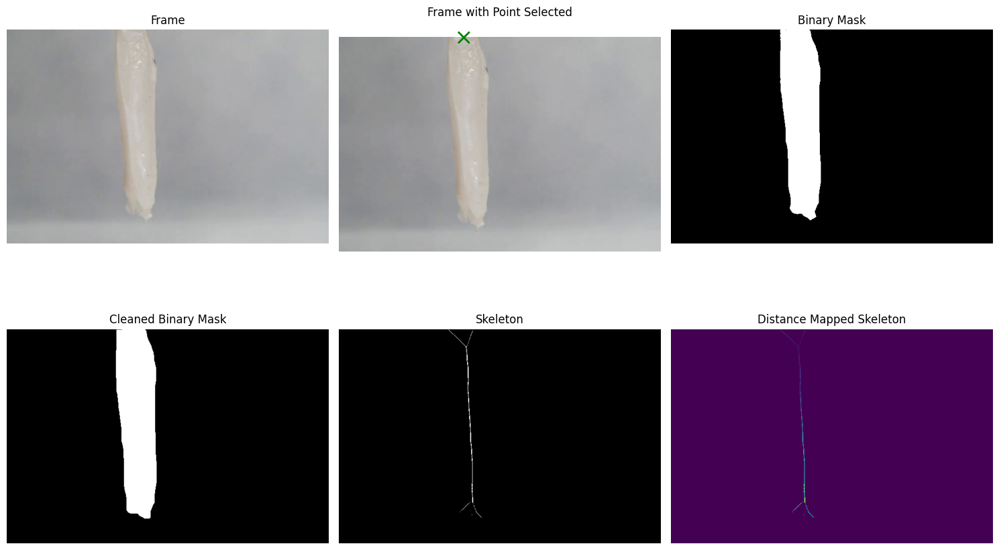

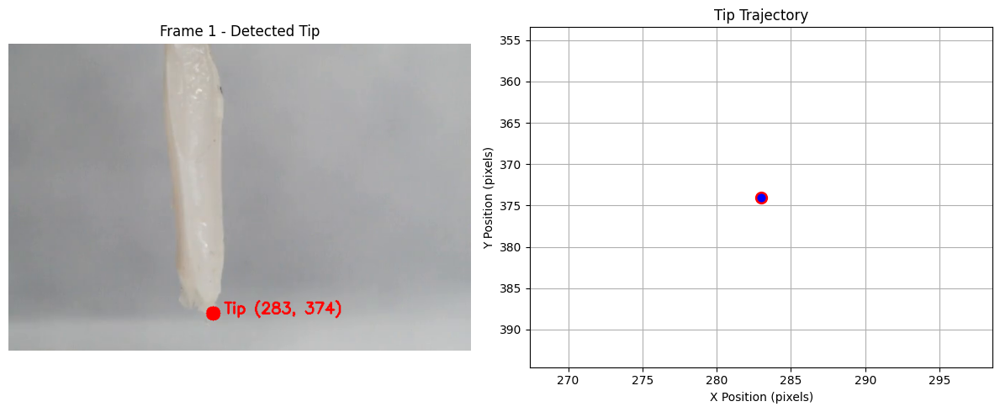


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_006.png: 1024x1024 1 0, 7485.3ms
Speed: 22.6ms preprocess, 7485.3ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


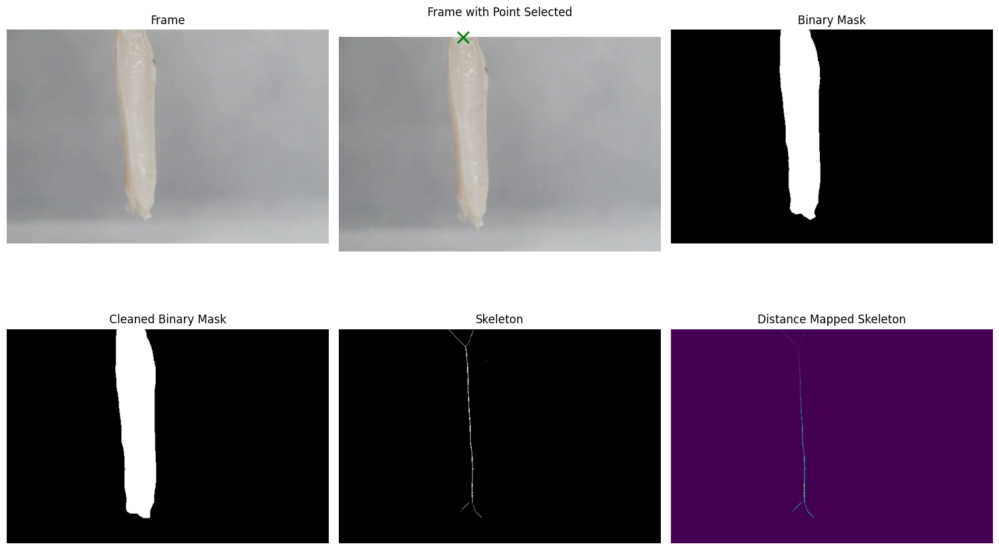

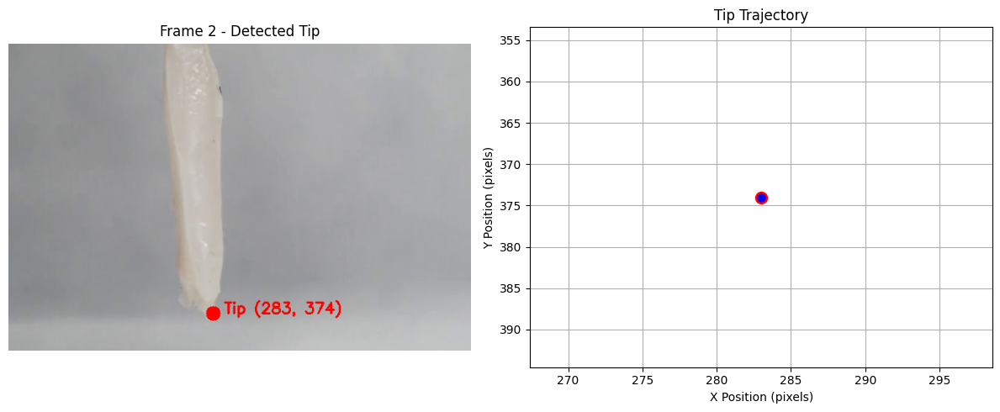


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_007.png: 1024x1024 1 0, 7412.0ms
Speed: 27.7ms preprocess, 7412.0ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)


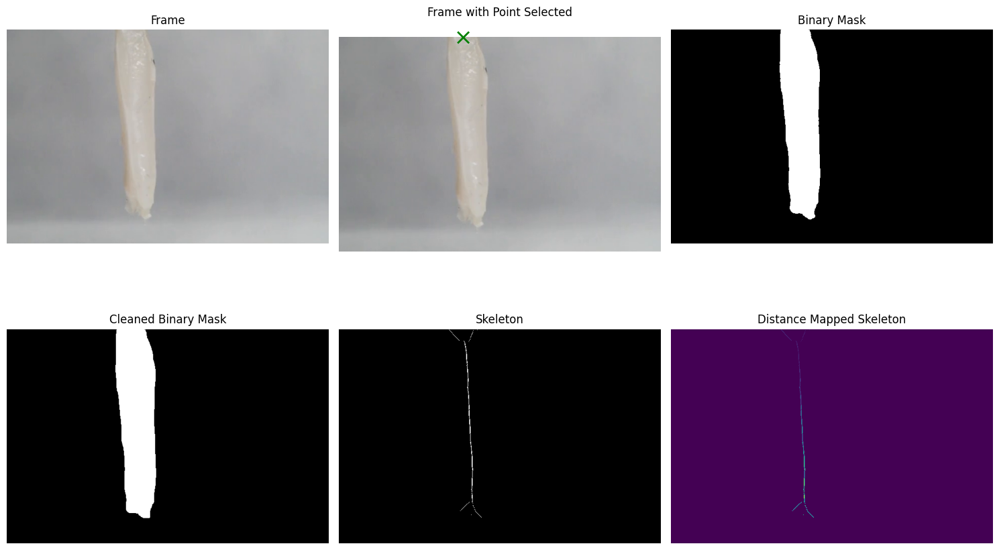

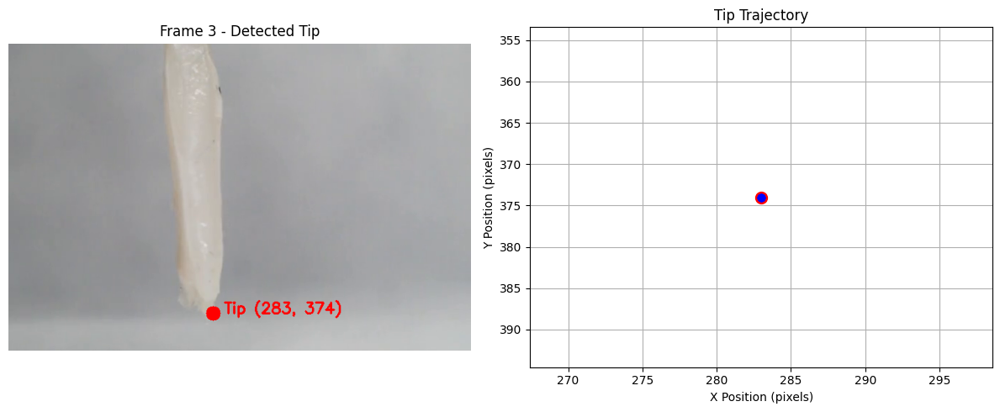


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_008.png: 1024x1024 1 0, 10012.7ms
Speed: 25.0ms preprocess, 10012.7ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)


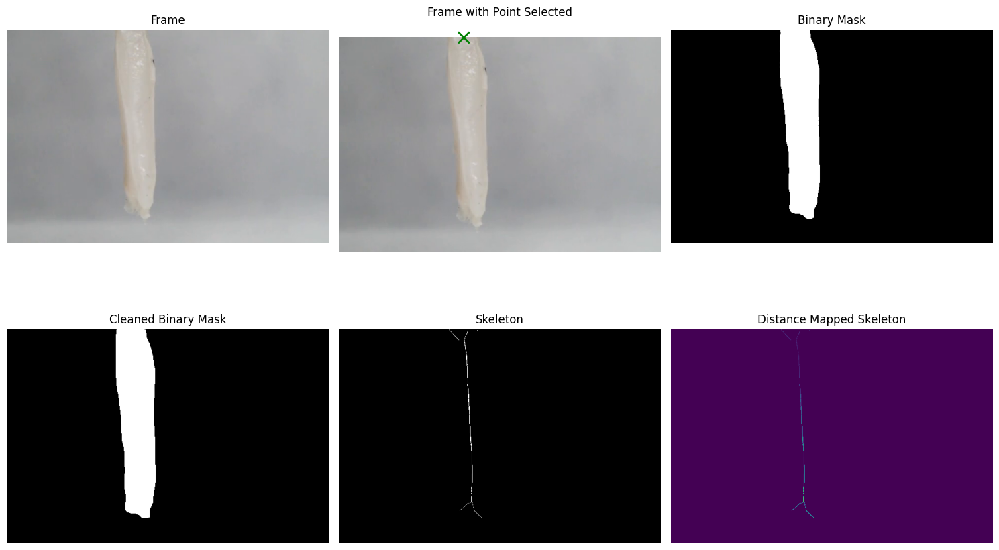

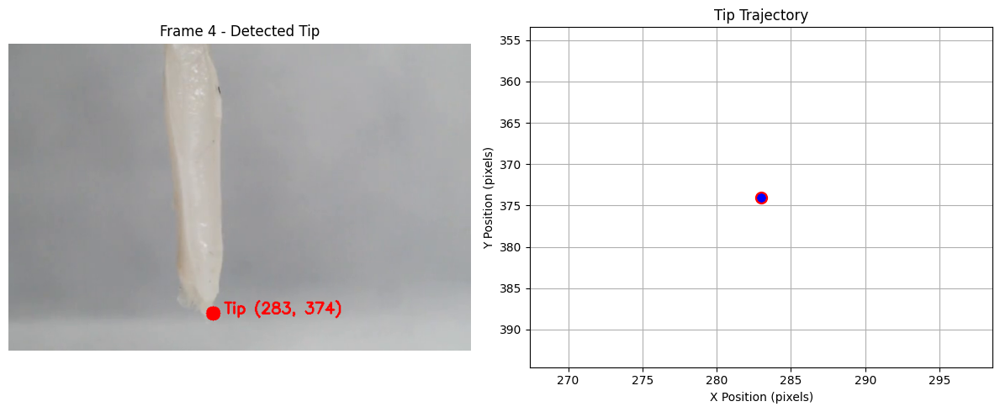


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_009.png: 1024x1024 1 0, 7589.6ms
Speed: 21.4ms preprocess, 7589.6ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


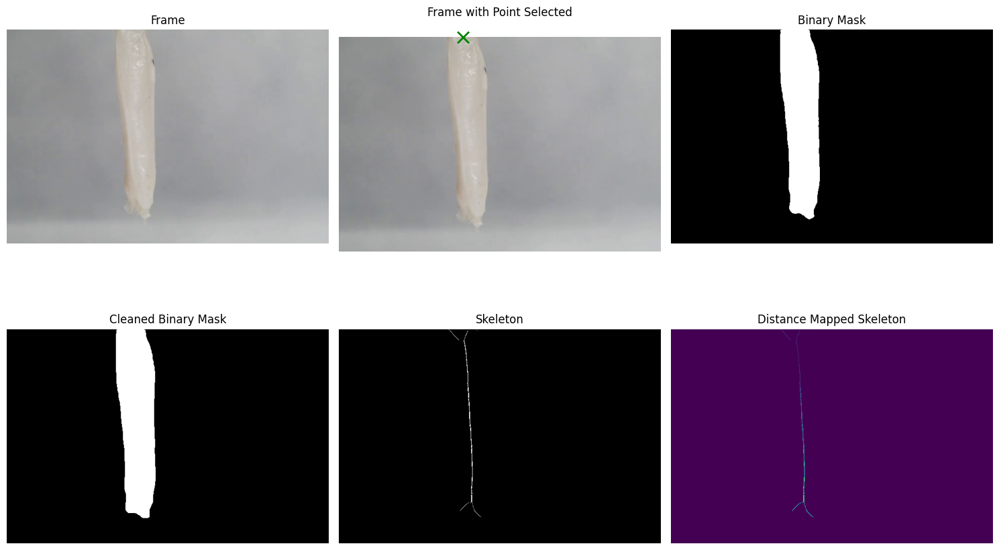

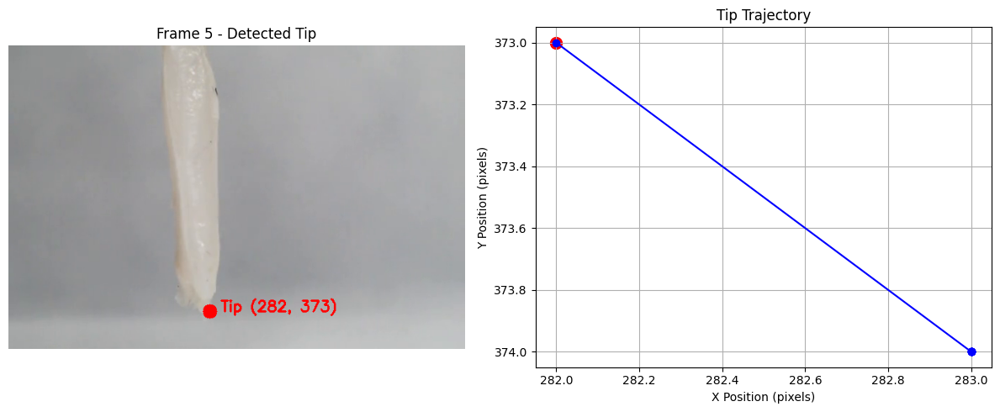


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_010.png: 1024x1024 1 0, 8347.7ms
Speed: 24.3ms preprocess, 8347.7ms inference, 1.4ms postprocess per image at shape (1, 3, 1024, 1024)


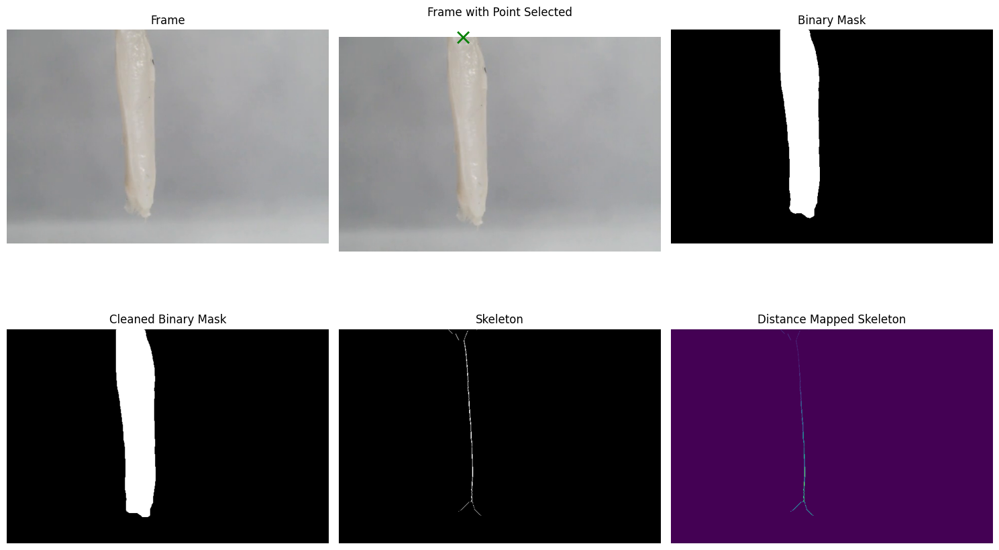

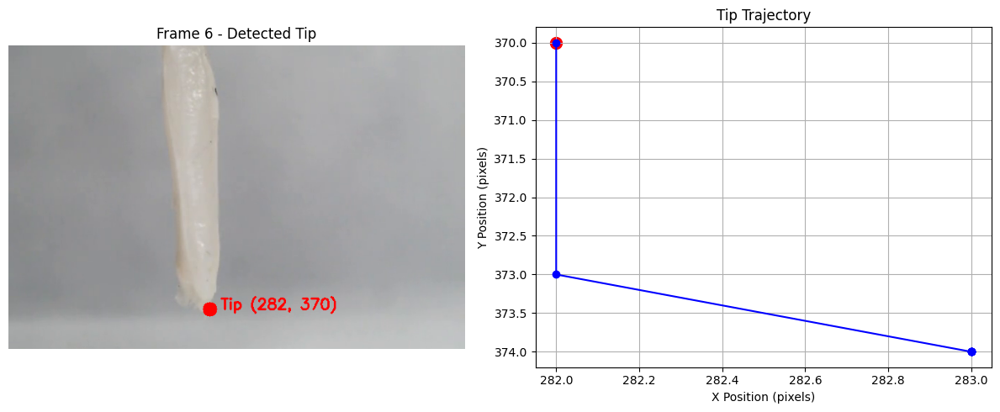


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_011.png: 1024x1024 1 0, 9752.7ms
Speed: 23.3ms preprocess, 9752.7ms inference, 4.2ms postprocess per image at shape (1, 3, 1024, 1024)


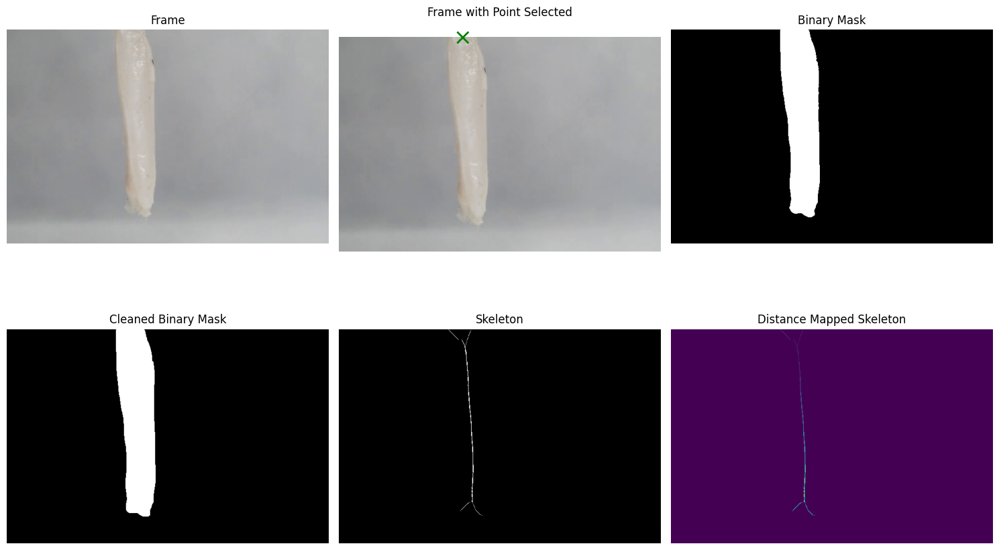

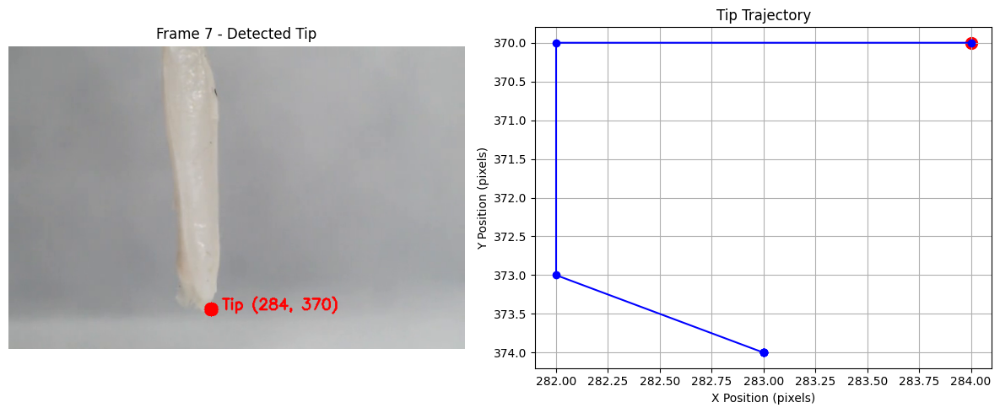


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_012.png: 1024x1024 1 0, 9528.0ms
Speed: 25.6ms preprocess, 9528.0ms inference, 1.9ms postprocess per image at shape (1, 3, 1024, 1024)


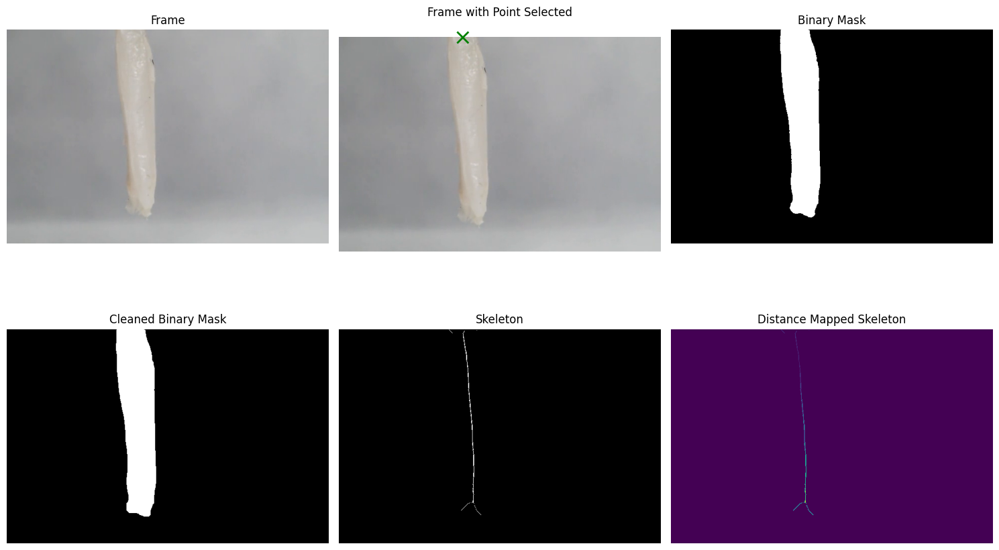

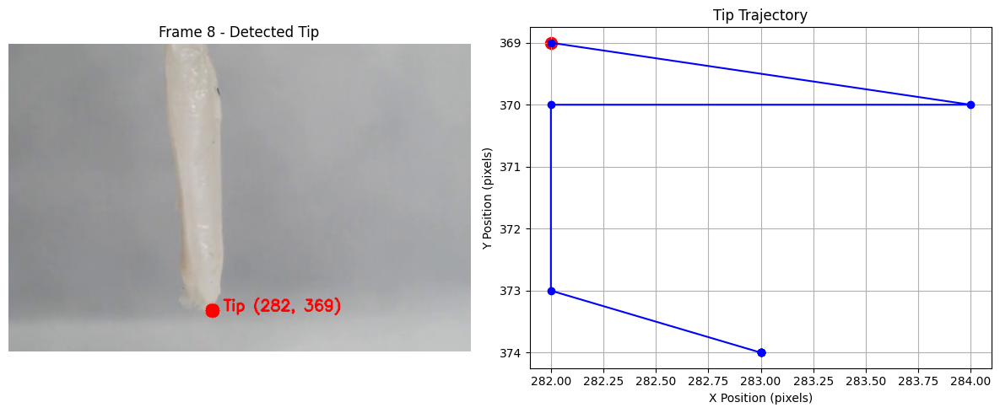


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_013.png: 1024x1024 1 0, 7852.4ms
Speed: 23.9ms preprocess, 7852.4ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


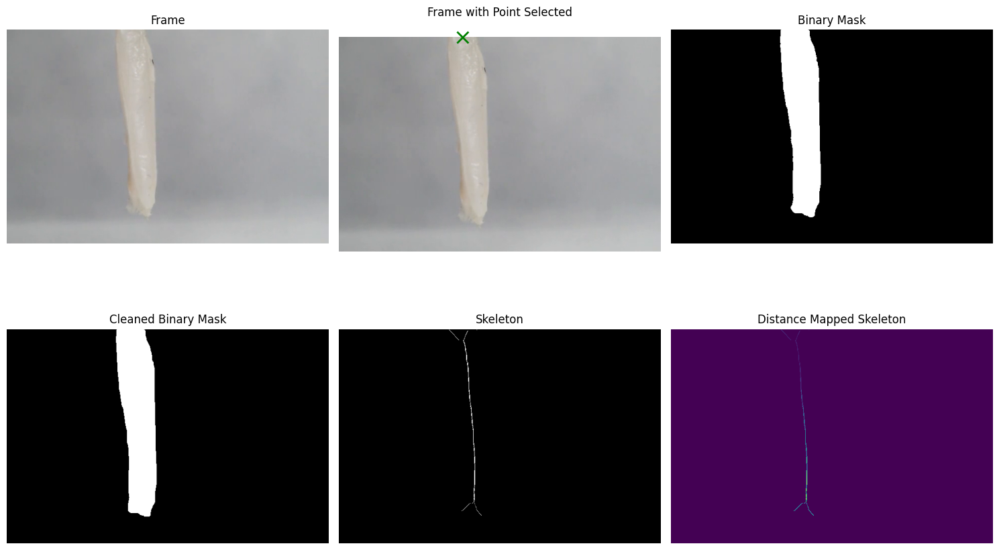

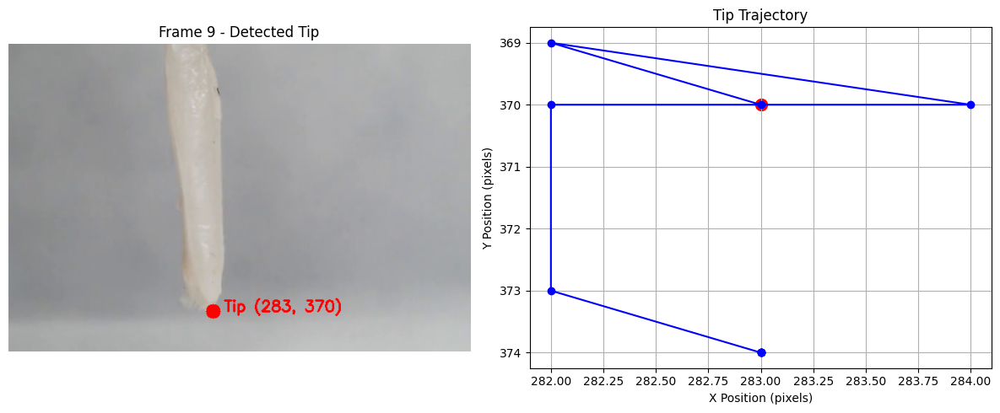


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_014.png: 1024x1024 1 0, 10759.6ms
Speed: 26.2ms preprocess, 10759.6ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


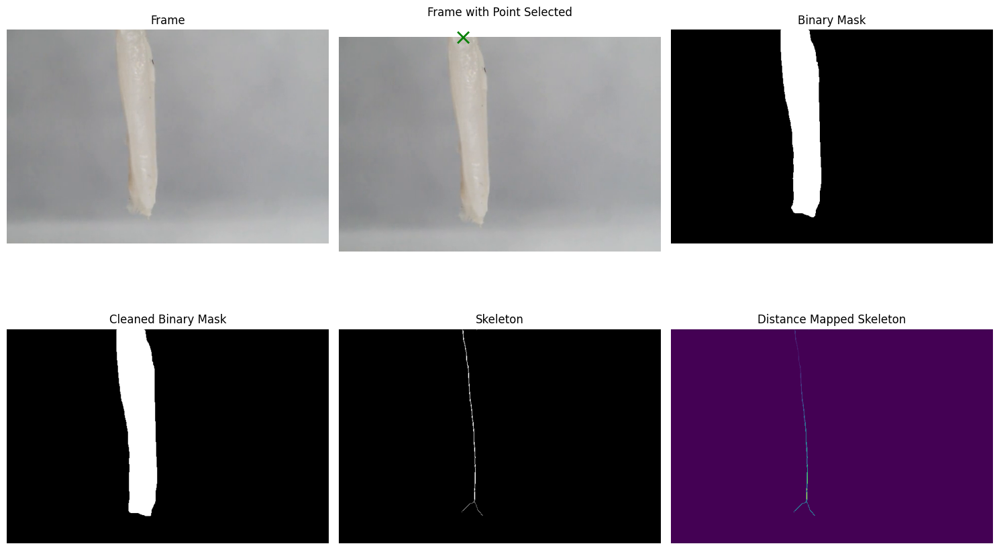

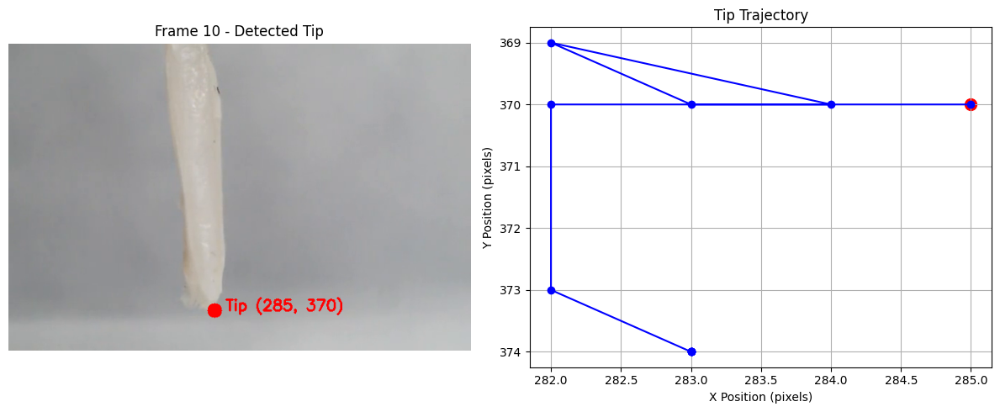


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_015.png: 1024x1024 1 0, 9802.4ms
Speed: 93.9ms preprocess, 9802.4ms inference, 1.4ms postprocess per image at shape (1, 3, 1024, 1024)


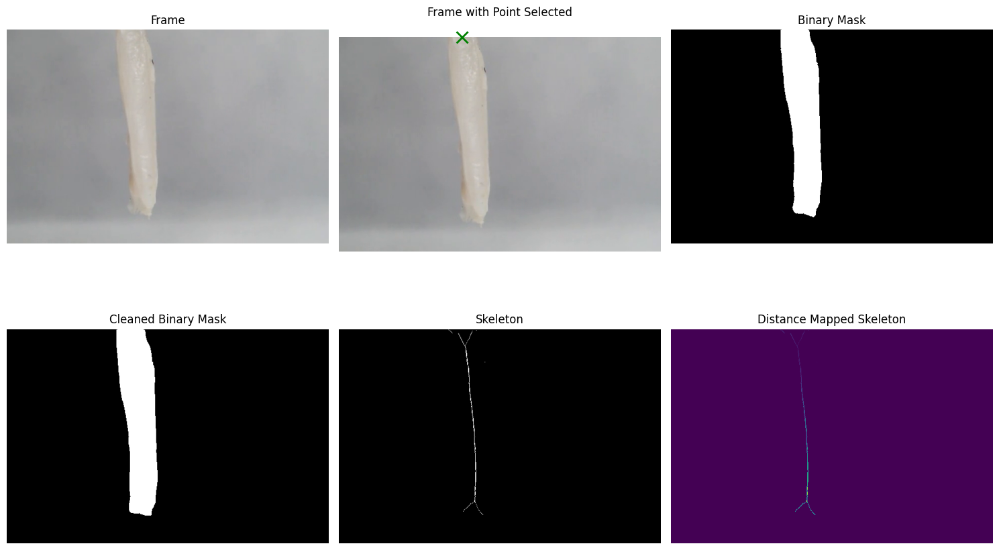

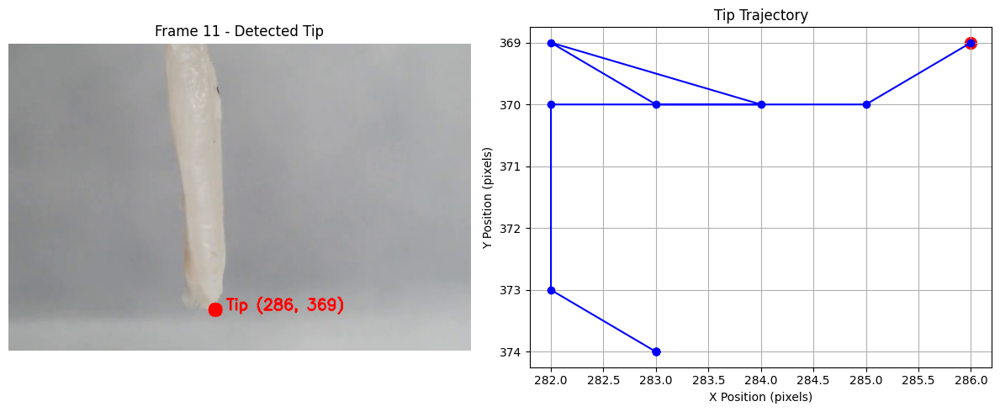


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_016.png: 1024x1024 1 0, 8041.9ms
Speed: 26.0ms preprocess, 8041.9ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


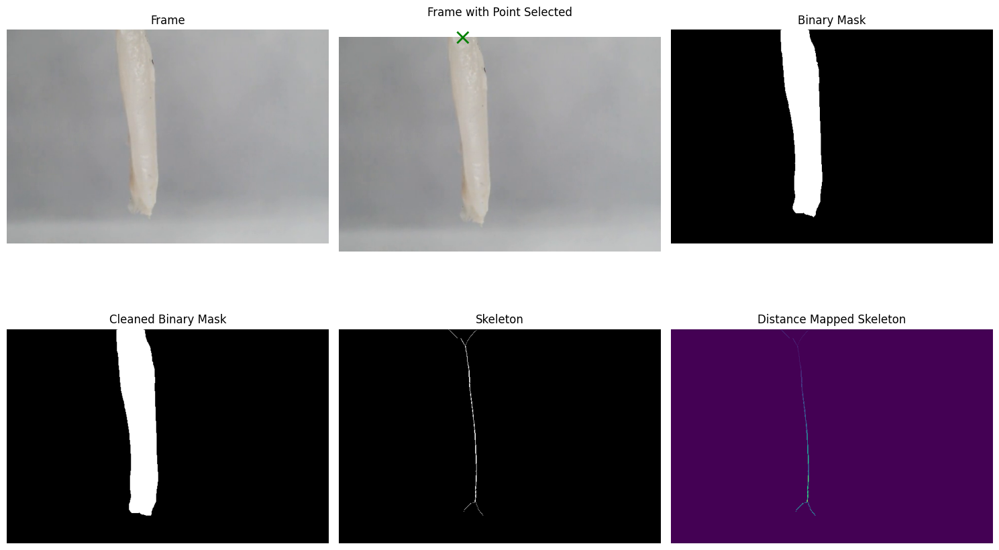

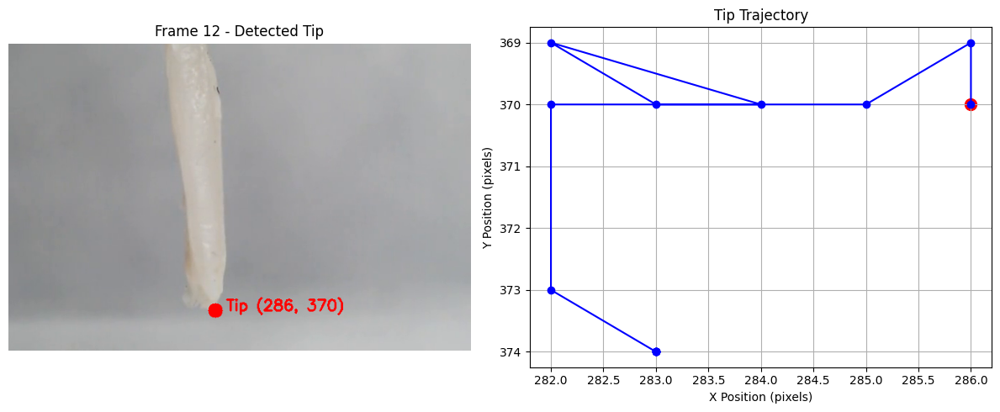


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_017.png: 1024x1024 1 0, 8497.1ms
Speed: 65.0ms preprocess, 8497.1ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


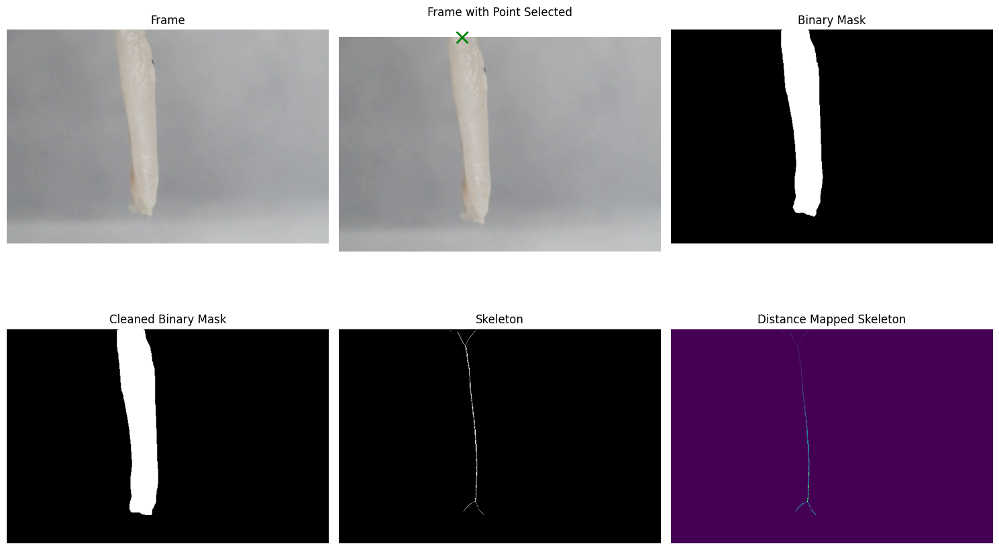

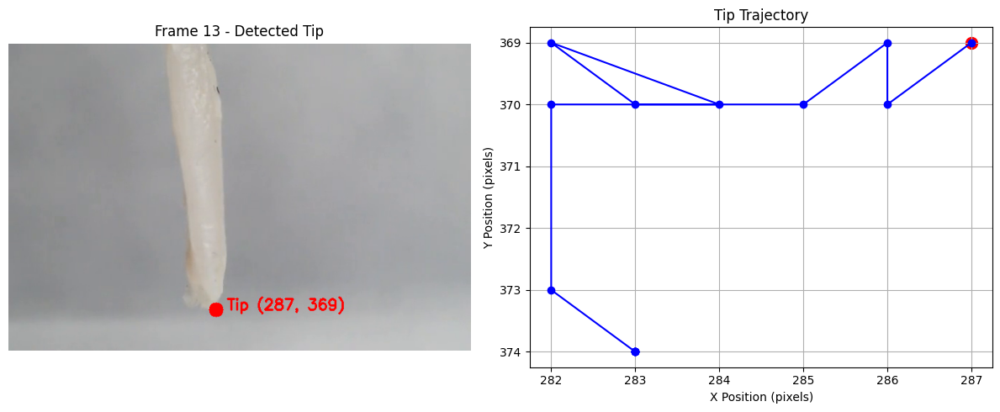


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_018.png: 1024x1024 1 0, 9081.0ms
Speed: 97.5ms preprocess, 9081.0ms inference, 2.4ms postprocess per image at shape (1, 3, 1024, 1024)


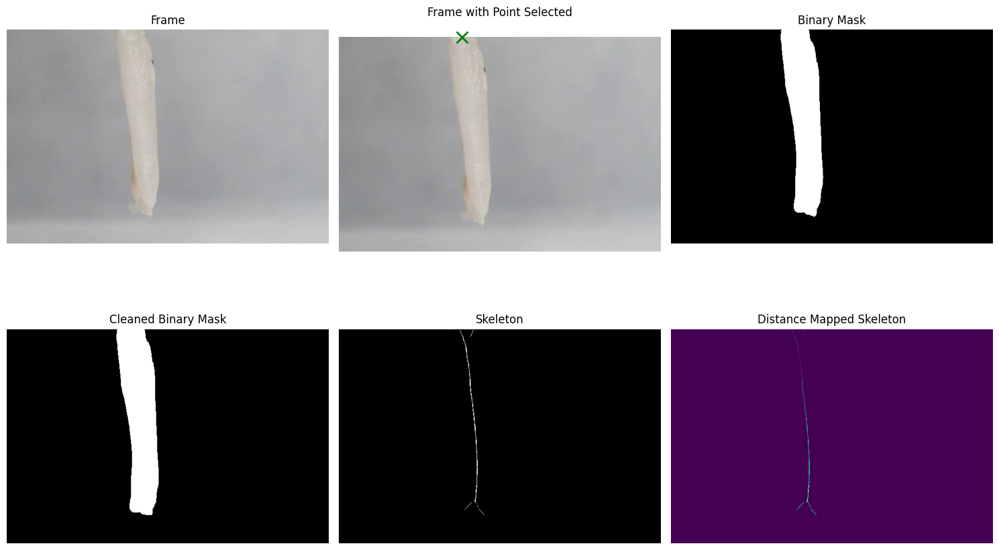

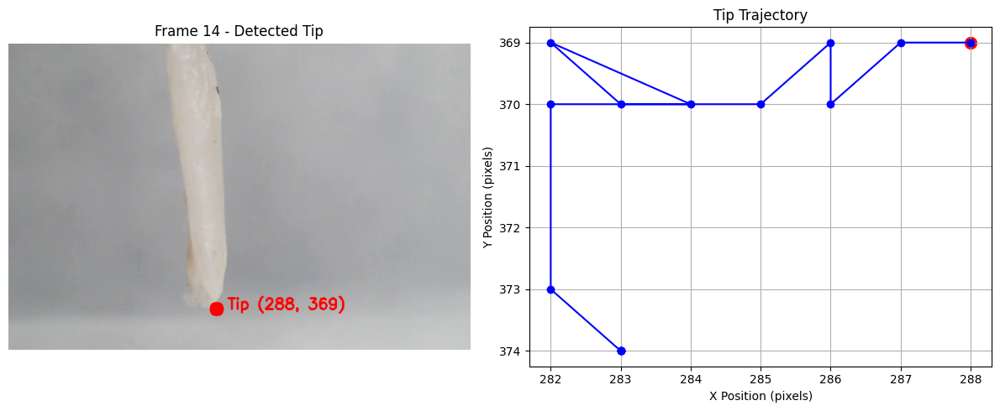


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_019.png: 1024x1024 1 0, 11570.0ms
Speed: 28.0ms preprocess, 11570.0ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


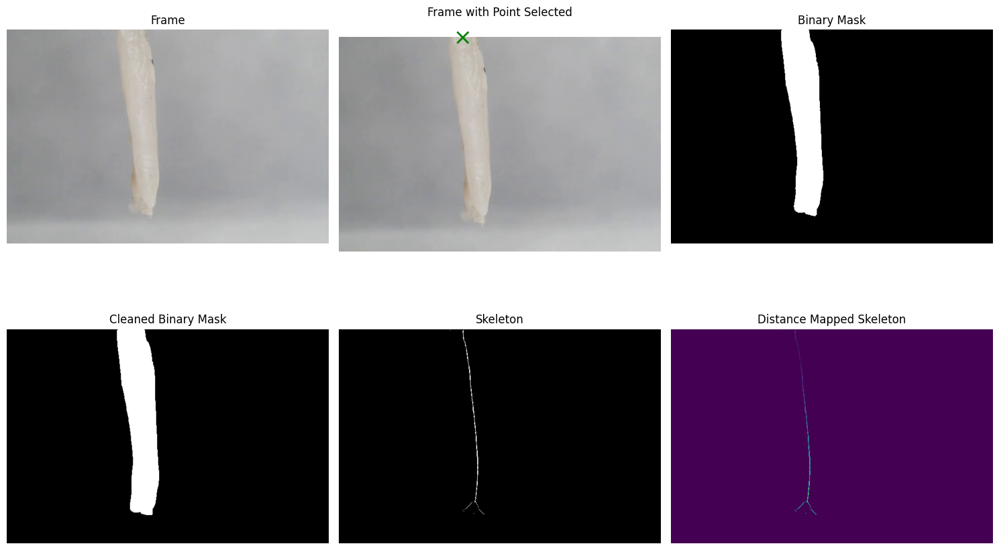

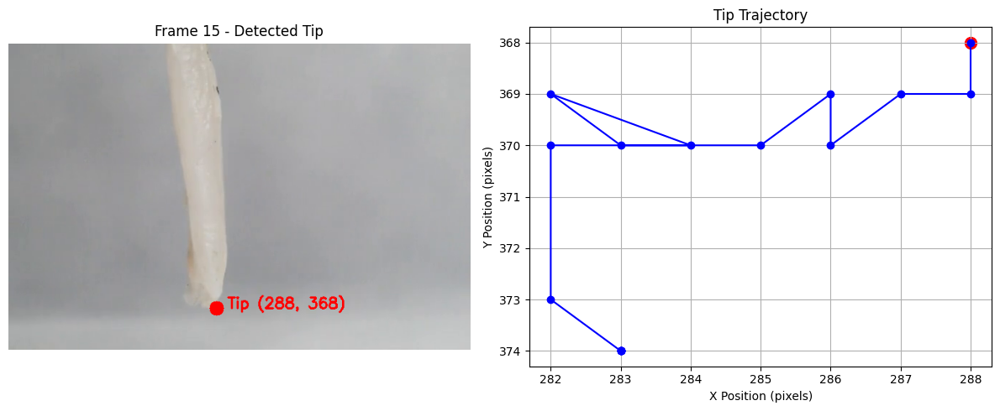


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_020.png: 1024x1024 1 0, 14857.9ms
Speed: 27.2ms preprocess, 14857.9ms inference, 2.5ms postprocess per image at shape (1, 3, 1024, 1024)


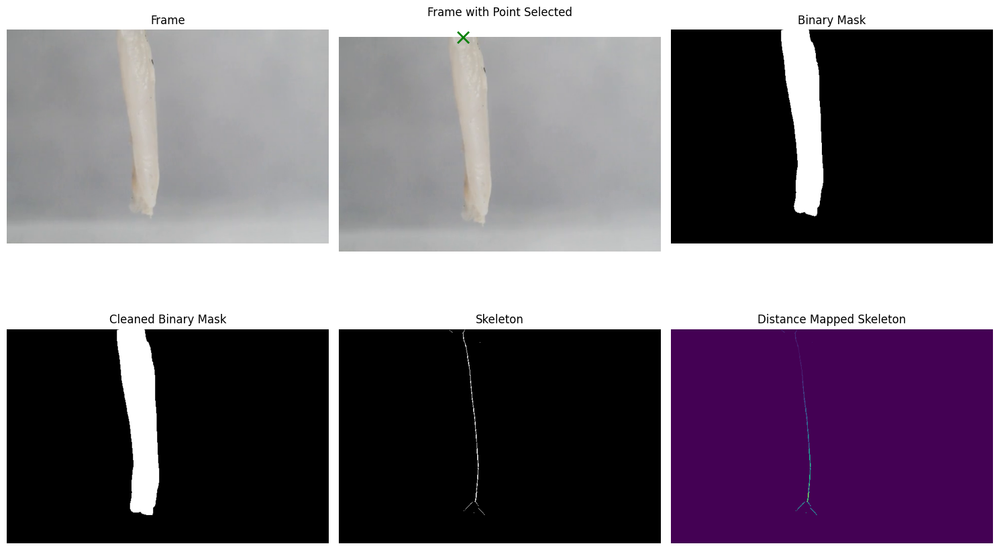

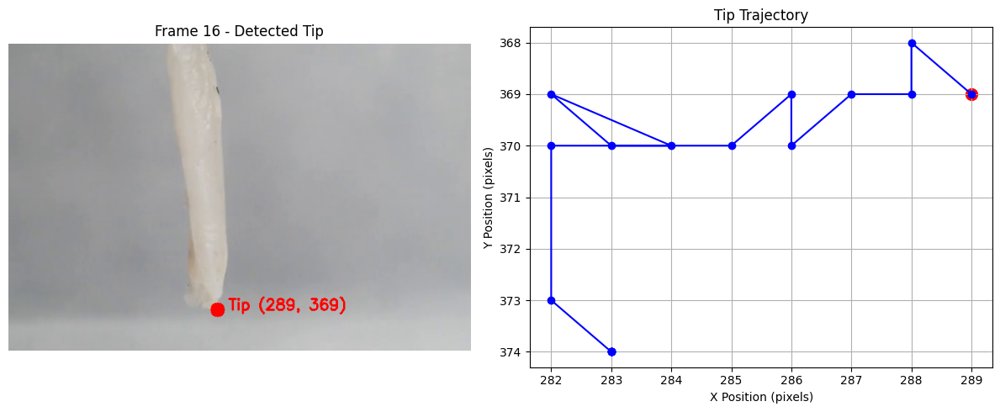


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_021.png: 1024x1024 1 0, 15904.5ms
Speed: 32.7ms preprocess, 15904.5ms inference, 3.6ms postprocess per image at shape (1, 3, 1024, 1024)


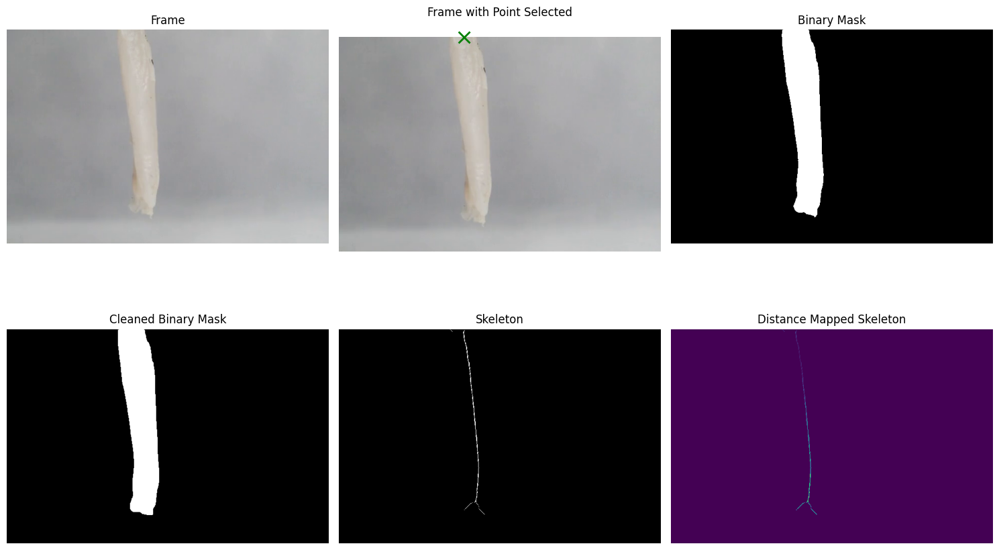

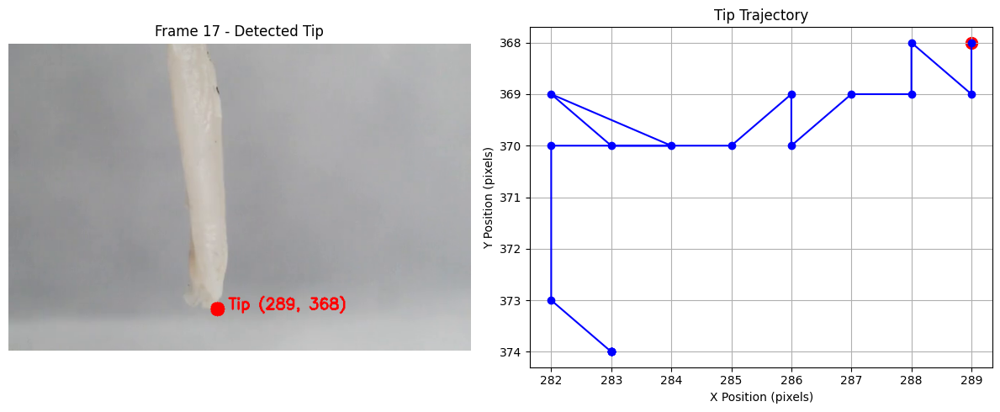


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_022.png: 1024x1024 1 0, 11226.8ms
Speed: 56.4ms preprocess, 11226.8ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


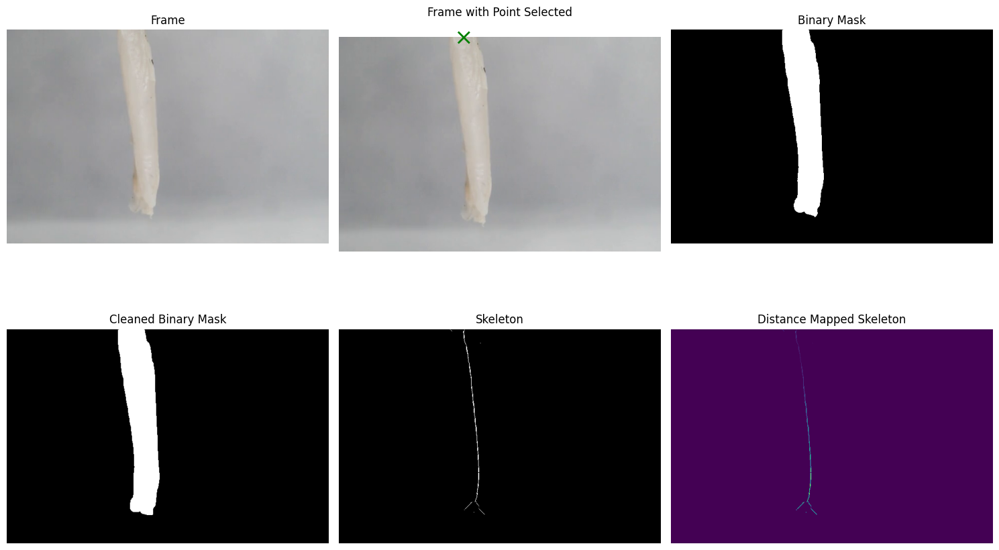

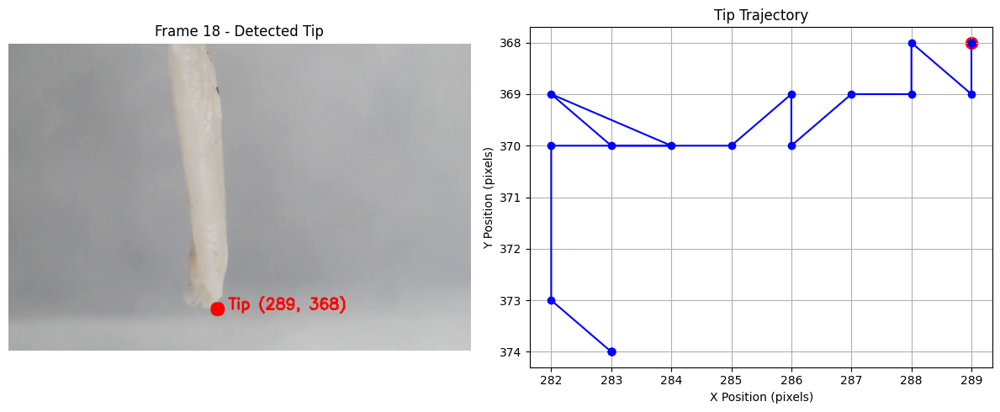


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_023.png: 1024x1024 1 0, 10381.9ms
Speed: 123.7ms preprocess, 10381.9ms inference, 3.6ms postprocess per image at shape (1, 3, 1024, 1024)


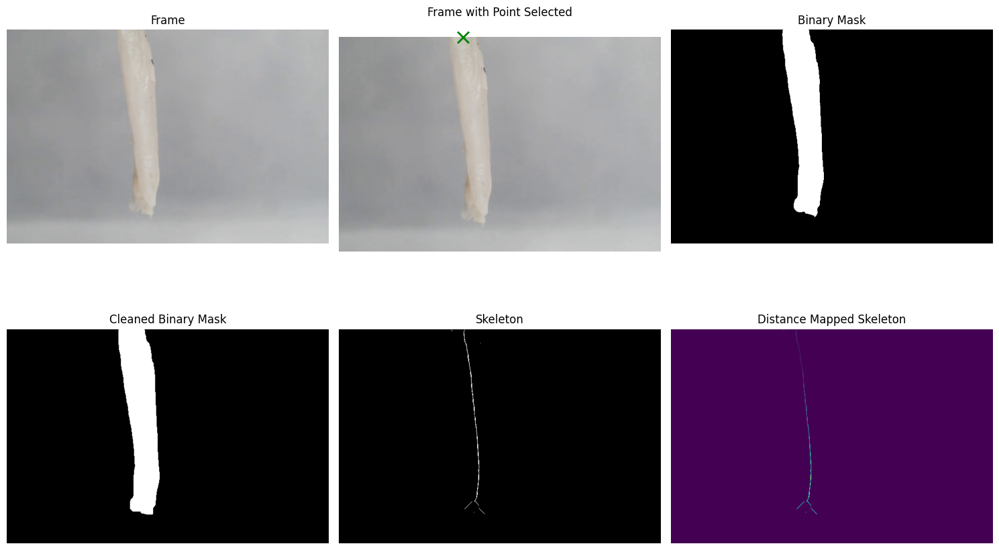

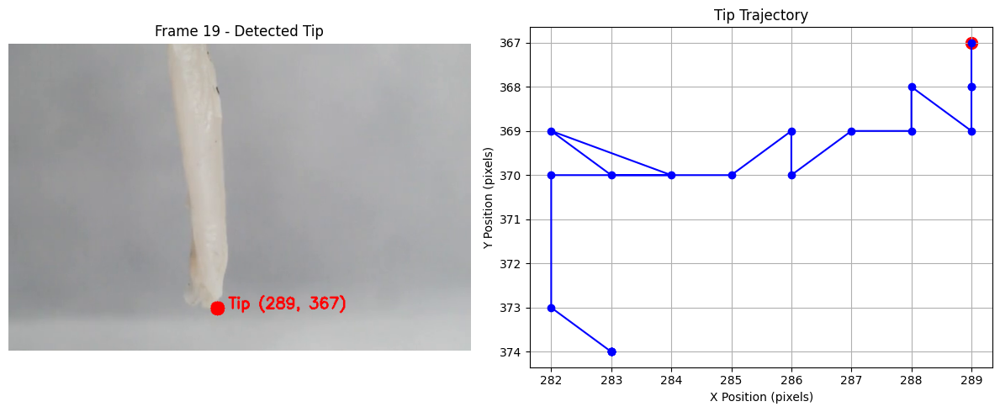


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_024.png: 1024x1024 1 0, 8883.7ms
Speed: 26.7ms preprocess, 8883.7ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


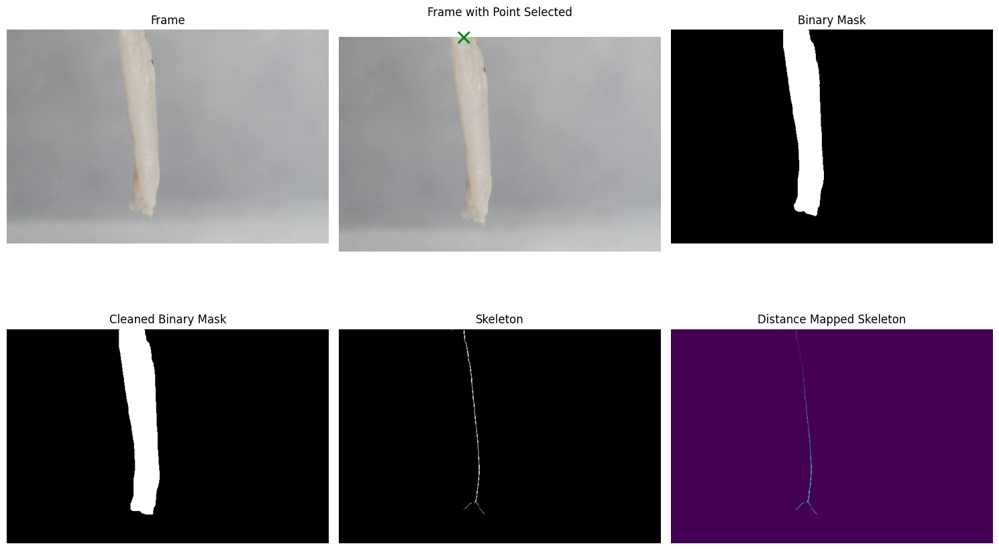

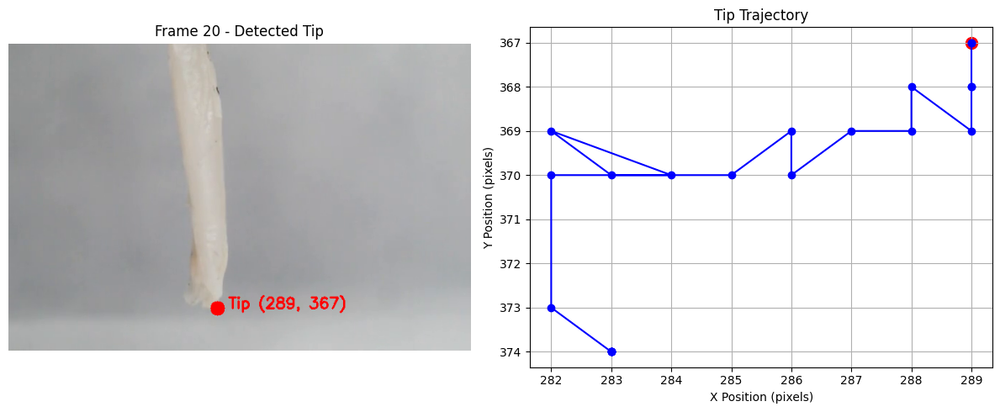


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_025.png: 1024x1024 1 0, 9529.6ms
Speed: 27.5ms preprocess, 9529.6ms inference, 2.7ms postprocess per image at shape (1, 3, 1024, 1024)


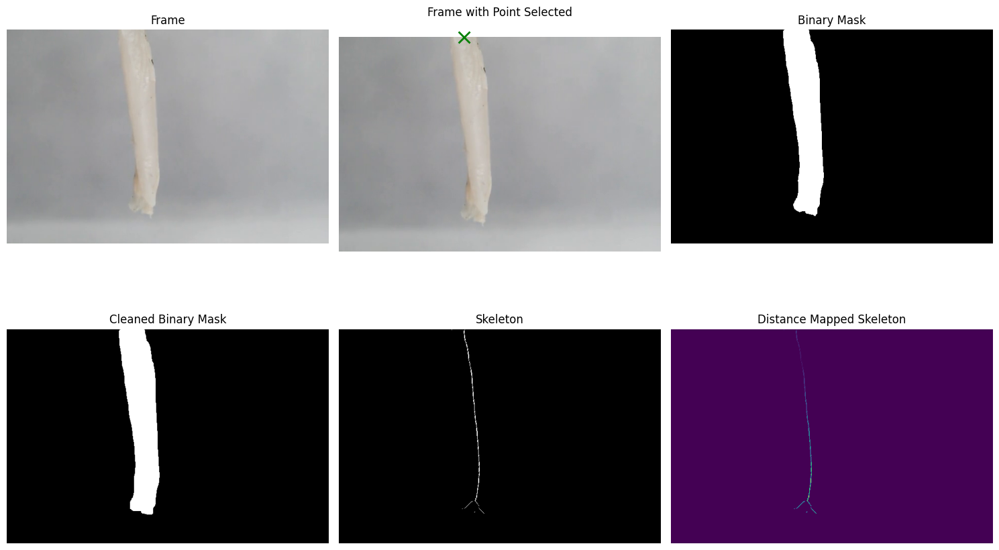

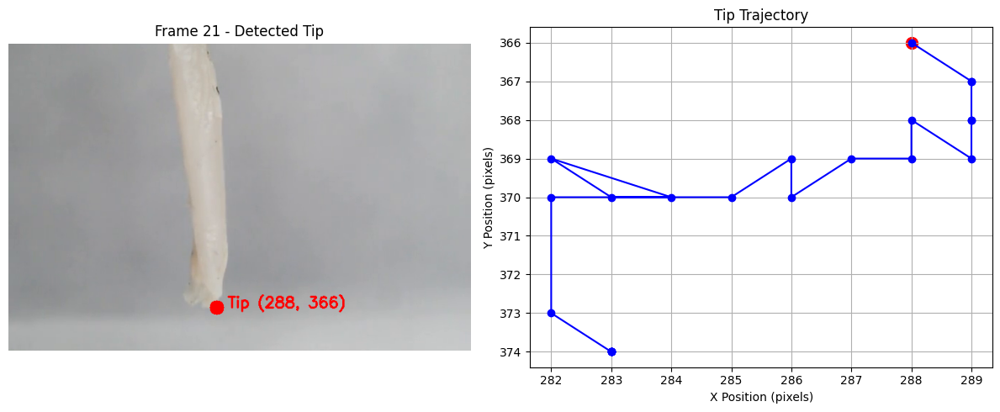


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_026.png: 1024x1024 1 0, 10760.0ms
Speed: 29.0ms preprocess, 10760.0ms inference, 2.1ms postprocess per image at shape (1, 3, 1024, 1024)


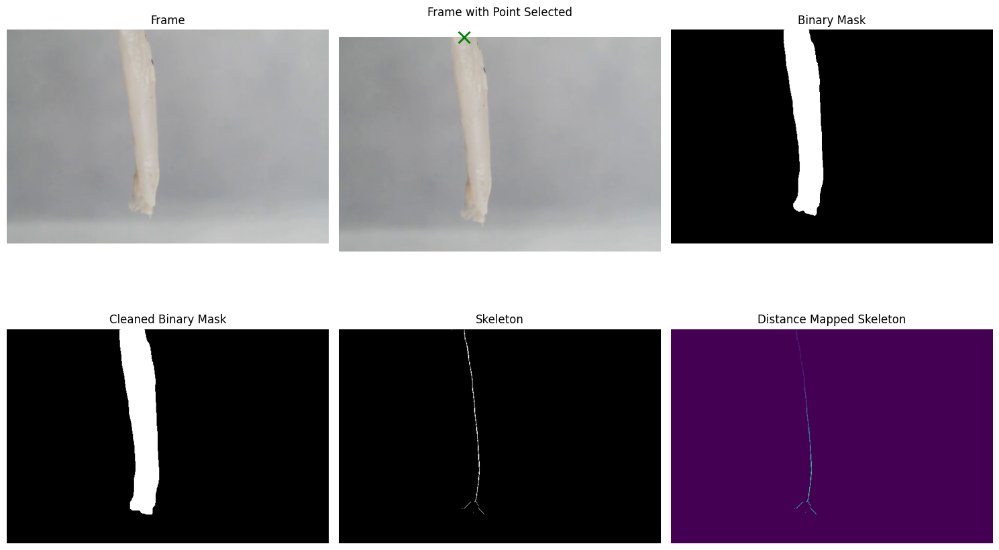

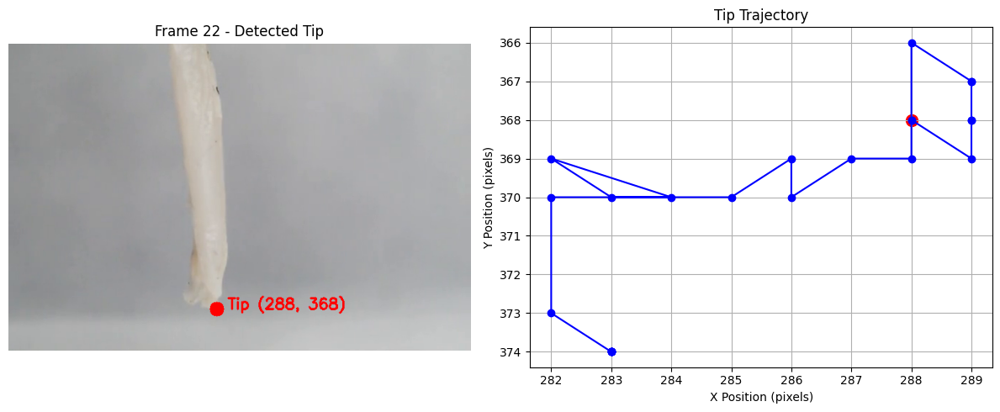


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_027.png: 1024x1024 1 0, 8442.2ms
Speed: 23.3ms preprocess, 8442.2ms inference, 2.2ms postprocess per image at shape (1, 3, 1024, 1024)


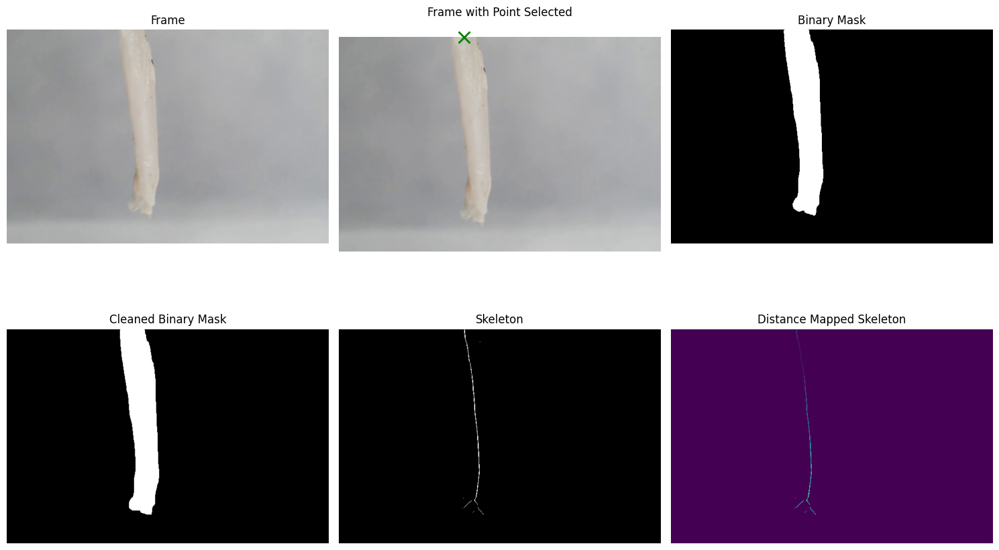

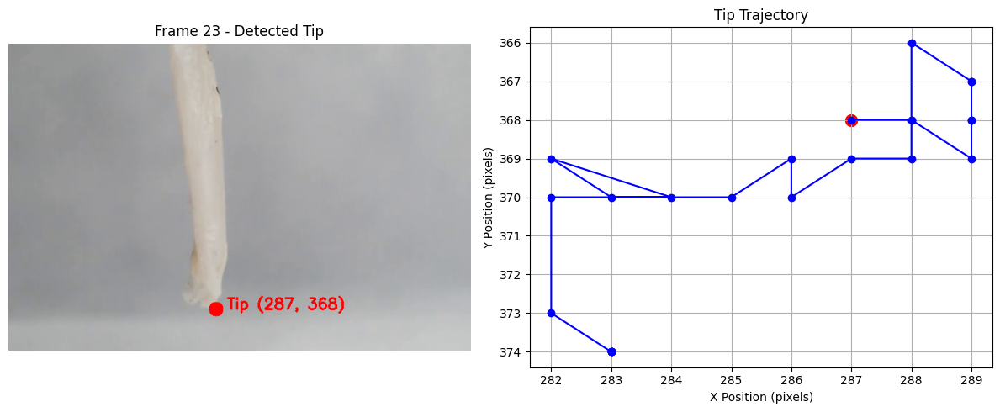


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_028.png: 1024x1024 1 0, 8643.0ms
Speed: 27.0ms preprocess, 8643.0ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


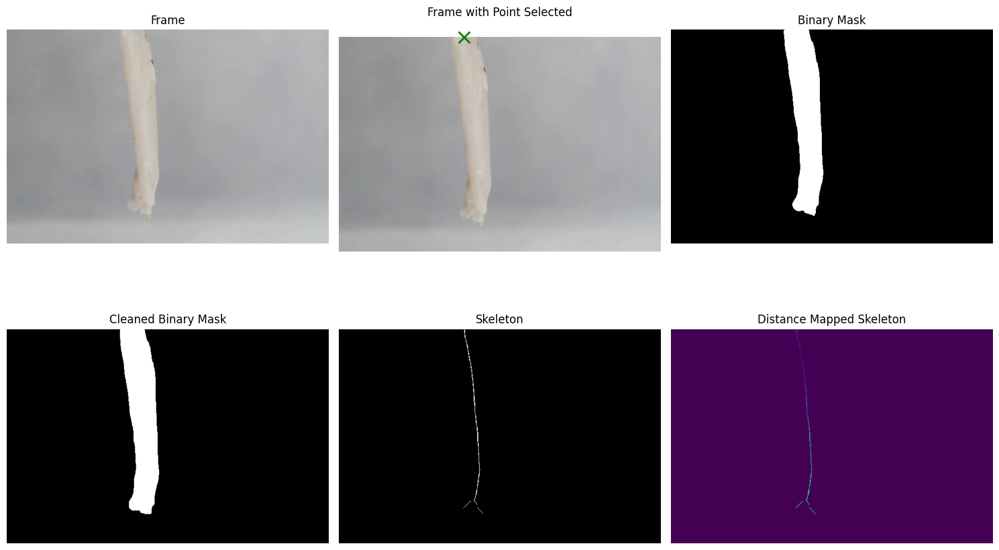

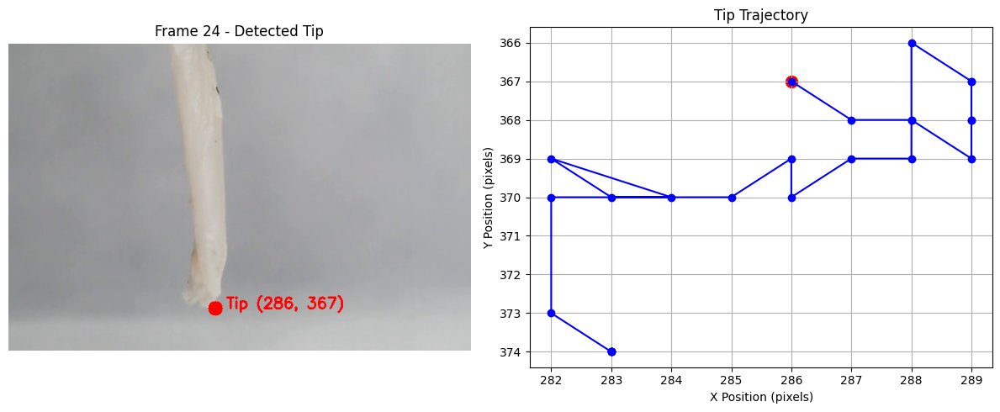


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_029.png: 1024x1024 1 0, 13005.8ms
Speed: 28.1ms preprocess, 13005.8ms inference, 4.0ms postprocess per image at shape (1, 3, 1024, 1024)


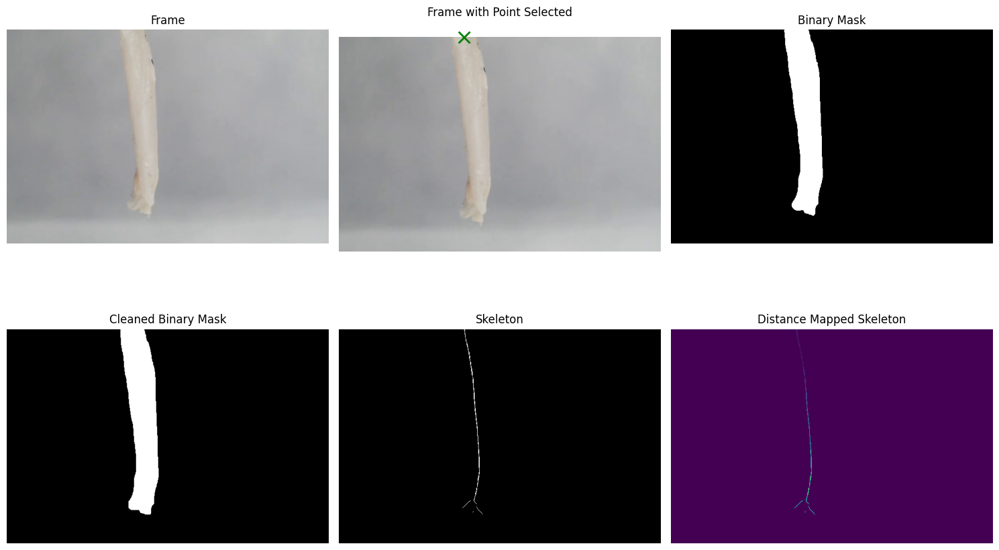

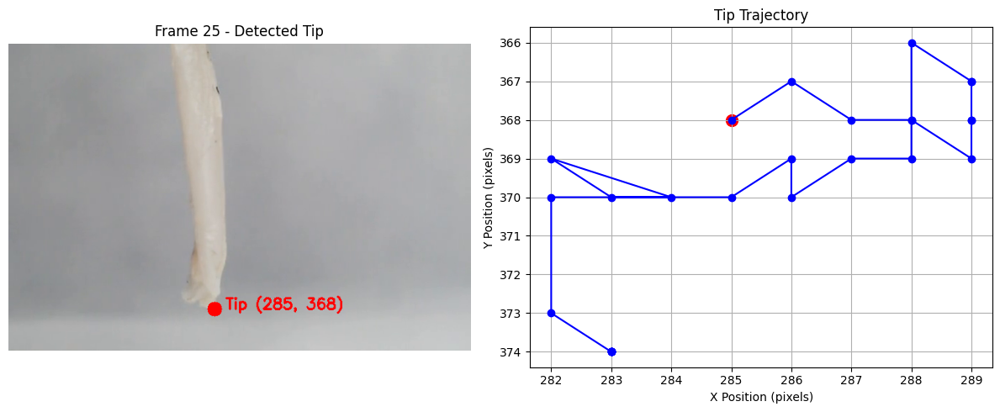


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_030.png: 1024x1024 1 0, 10274.4ms
Speed: 24.8ms preprocess, 10274.4ms inference, 2.4ms postprocess per image at shape (1, 3, 1024, 1024)


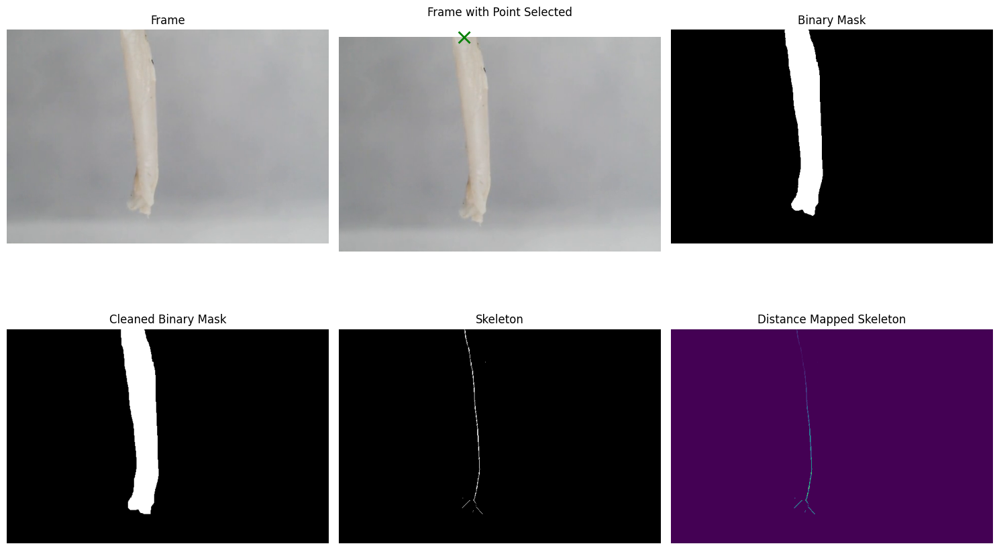

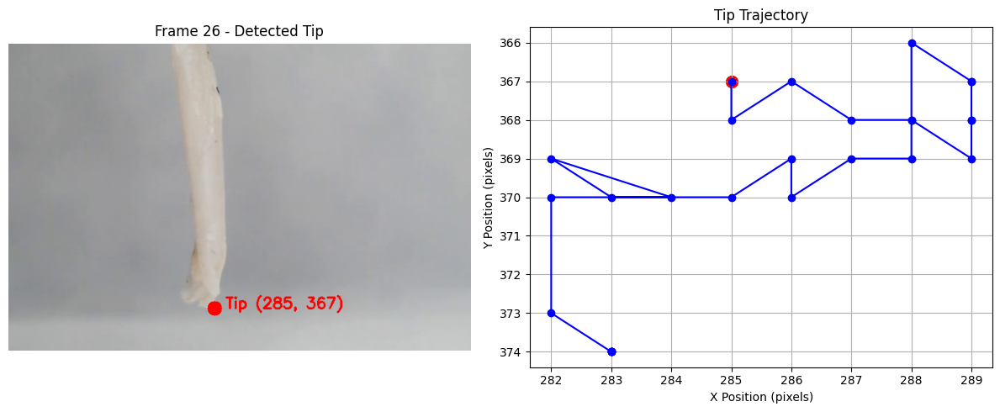


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_031.png: 1024x1024 1 0, 9323.7ms
Speed: 28.6ms preprocess, 9323.7ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


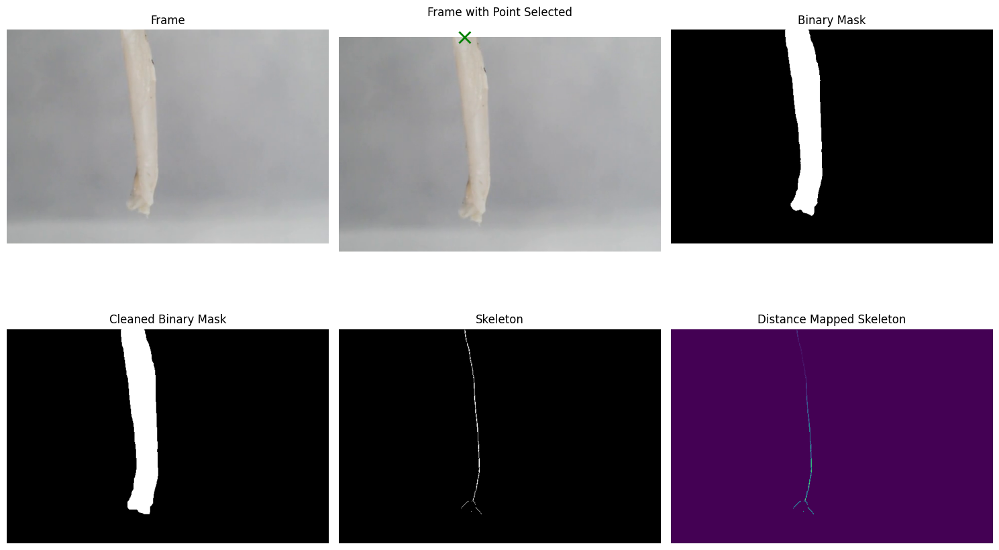

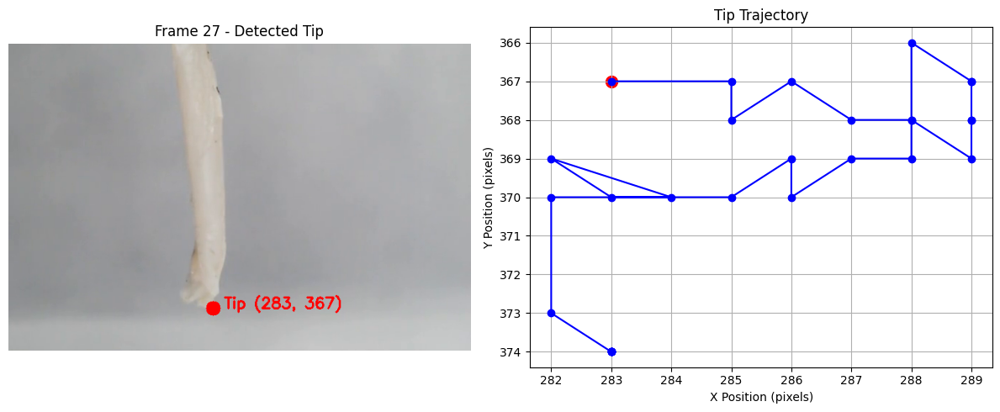


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_032.png: 1024x1024 1 0, 8045.3ms
Speed: 29.3ms preprocess, 8045.3ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


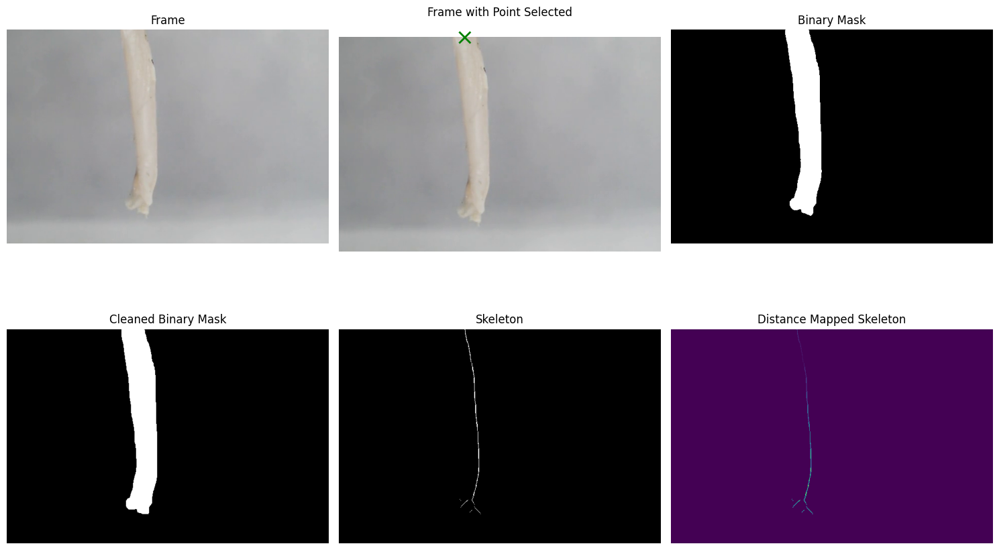

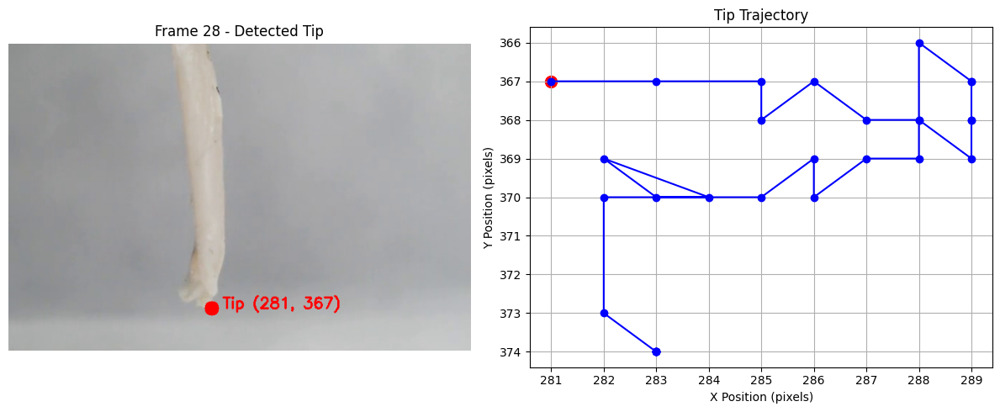


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_033.png: 1024x1024 1 0, 8201.2ms
Speed: 25.1ms preprocess, 8201.2ms inference, 2.1ms postprocess per image at shape (1, 3, 1024, 1024)


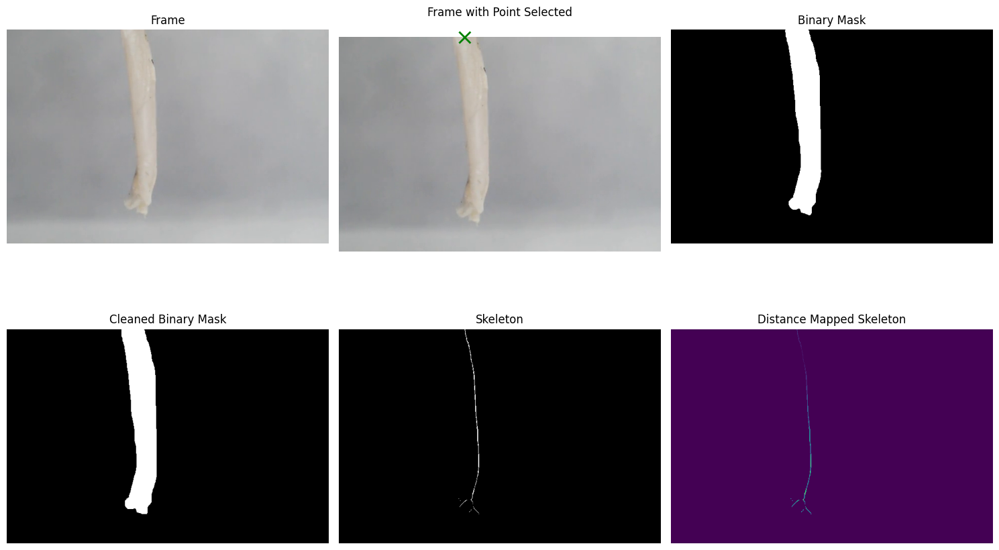

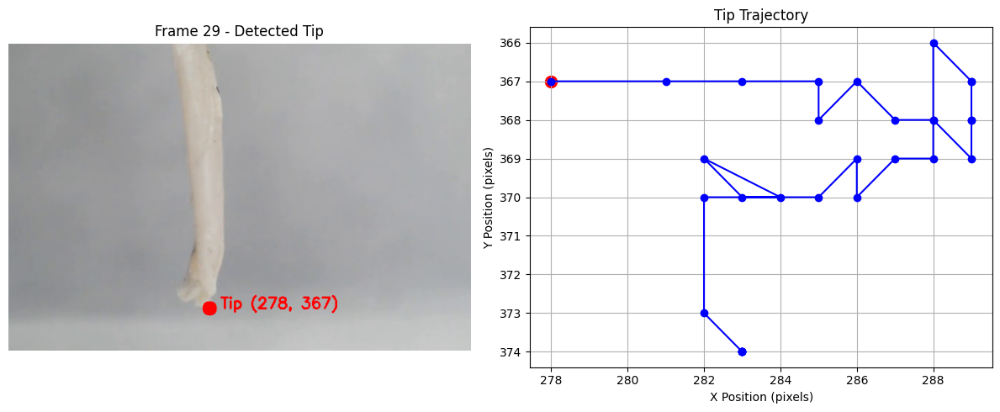


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_034.png: 1024x1024 1 0, 9321.8ms
Speed: 24.3ms preprocess, 9321.8ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


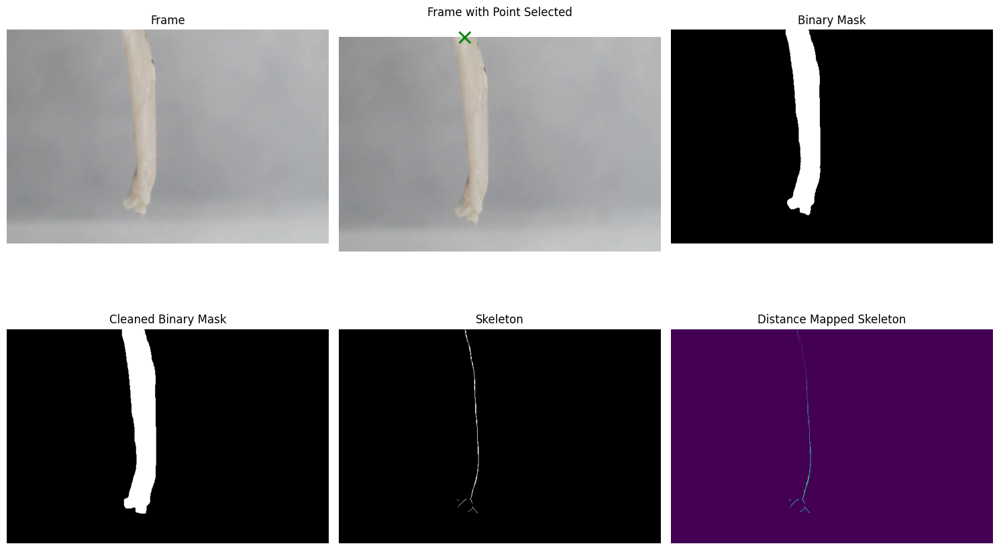

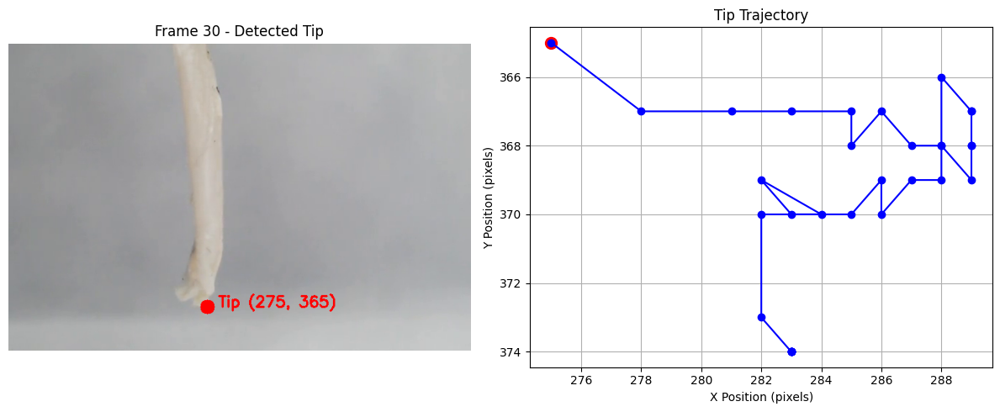


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_035.png: 1024x1024 1 0, 12979.9ms
Speed: 27.2ms preprocess, 12979.9ms inference, 3.3ms postprocess per image at shape (1, 3, 1024, 1024)


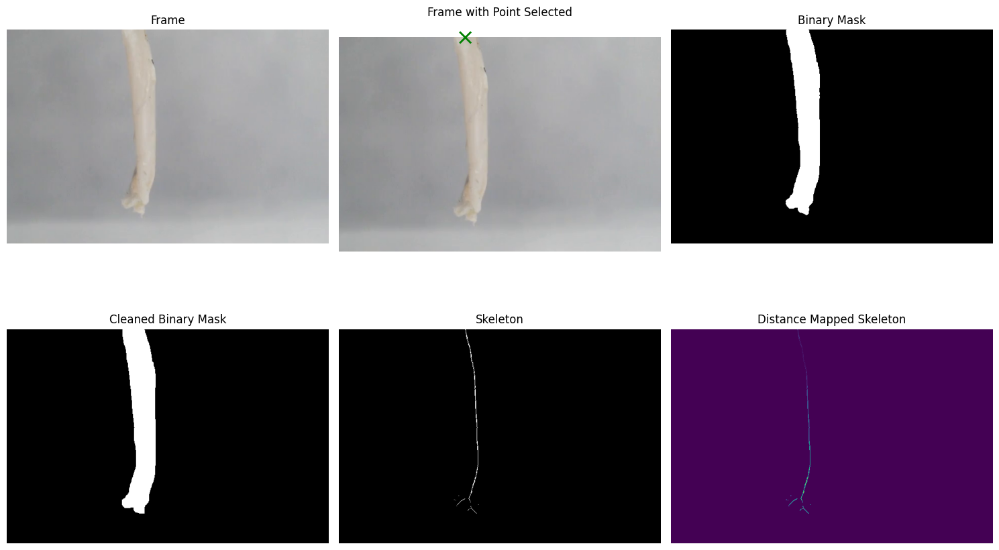

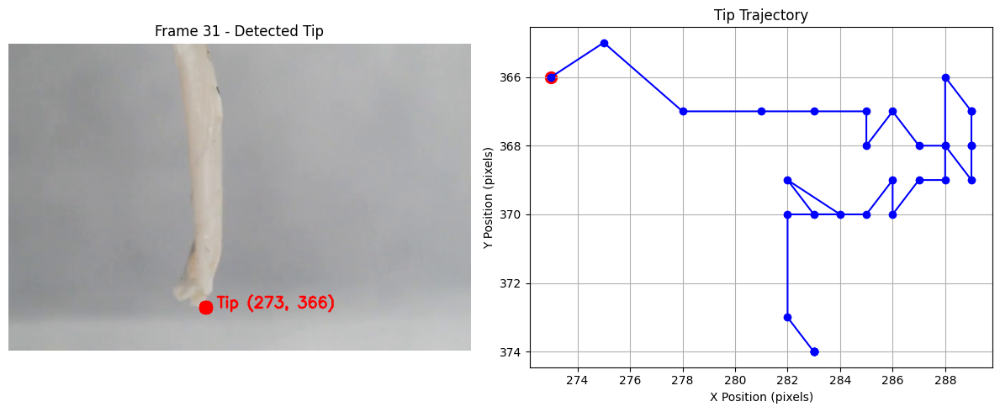


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_036.png: 1024x1024 1 0, 10062.8ms
Speed: 26.3ms preprocess, 10062.8ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


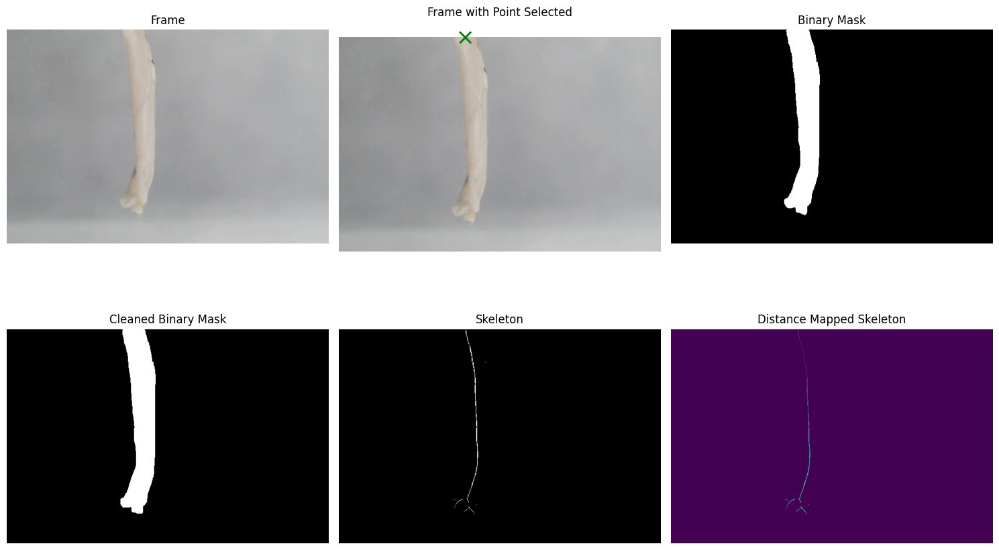

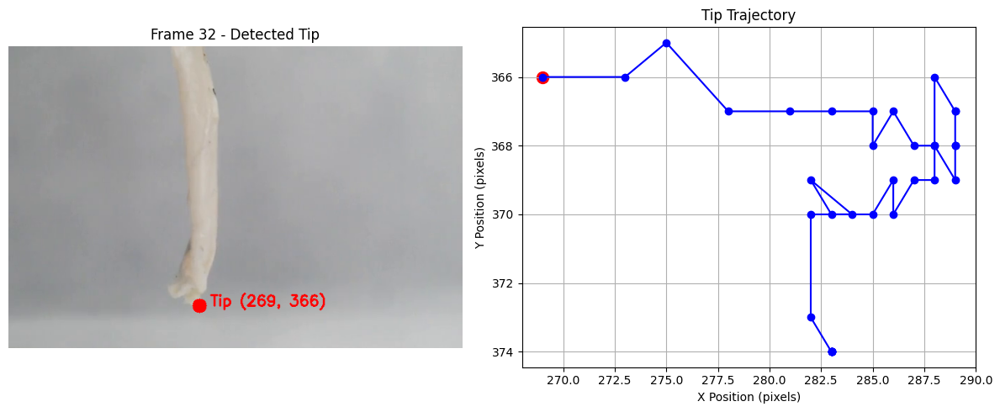


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_037.png: 1024x1024 1 0, 10848.5ms
Speed: 30.4ms preprocess, 10848.5ms inference, 1.9ms postprocess per image at shape (1, 3, 1024, 1024)


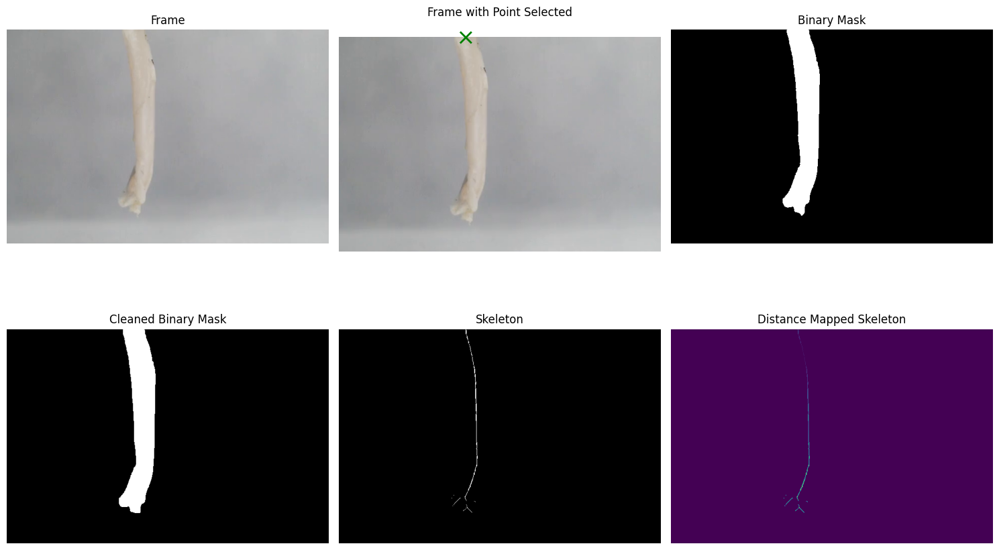

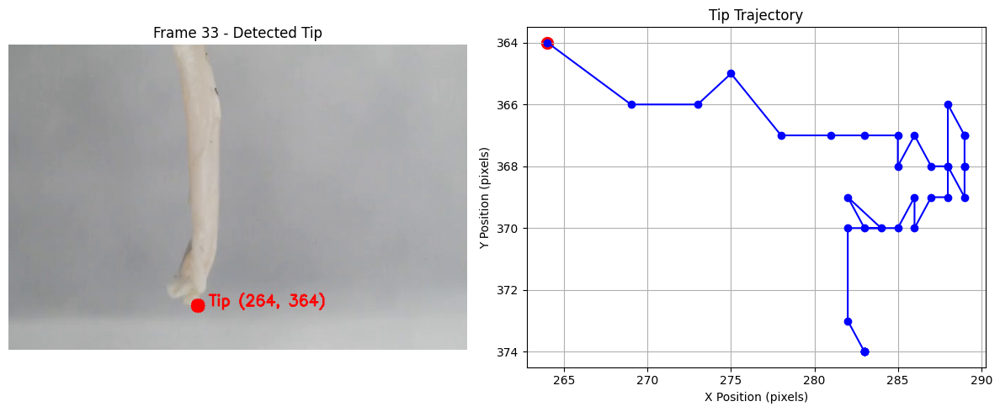


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_038.png: 1024x1024 1 0, 14096.6ms
Speed: 41.7ms preprocess, 14096.6ms inference, 4.3ms postprocess per image at shape (1, 3, 1024, 1024)


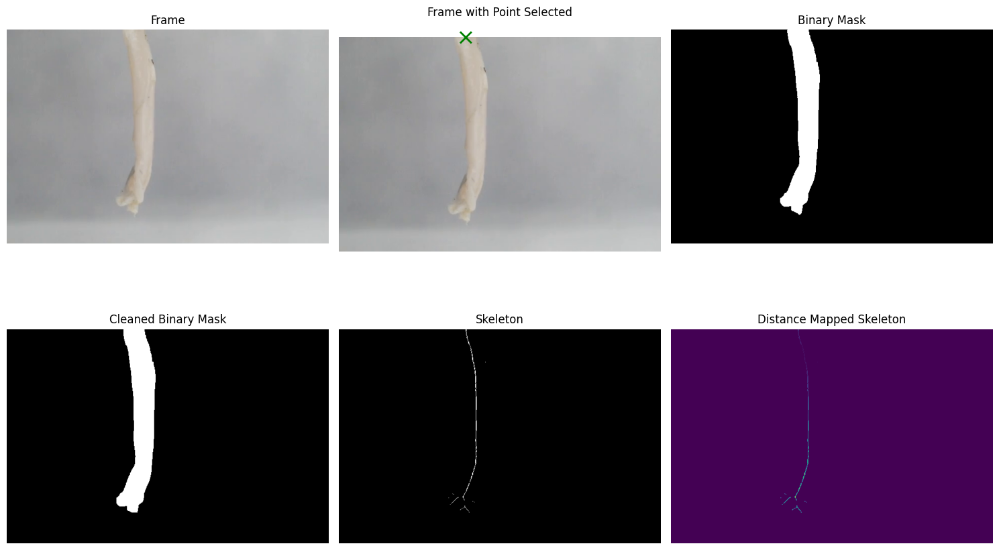

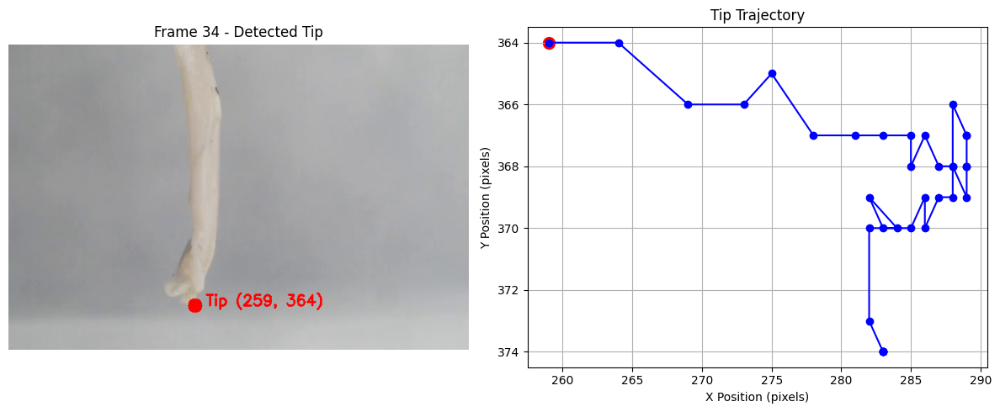


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_039.png: 1024x1024 1 0, 11307.5ms
Speed: 31.3ms preprocess, 11307.5ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


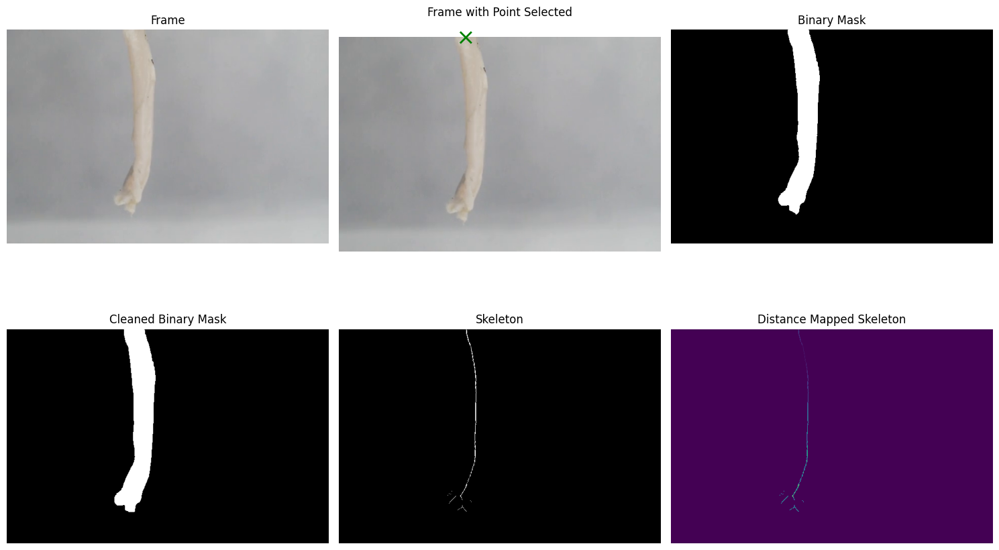

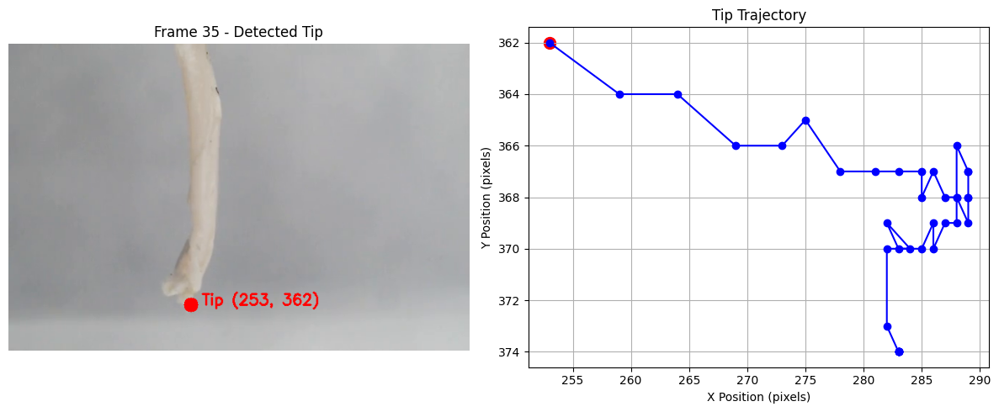


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_040.png: 1024x1024 1 0, 14408.9ms
Speed: 45.5ms preprocess, 14408.9ms inference, 6.3ms postprocess per image at shape (1, 3, 1024, 1024)


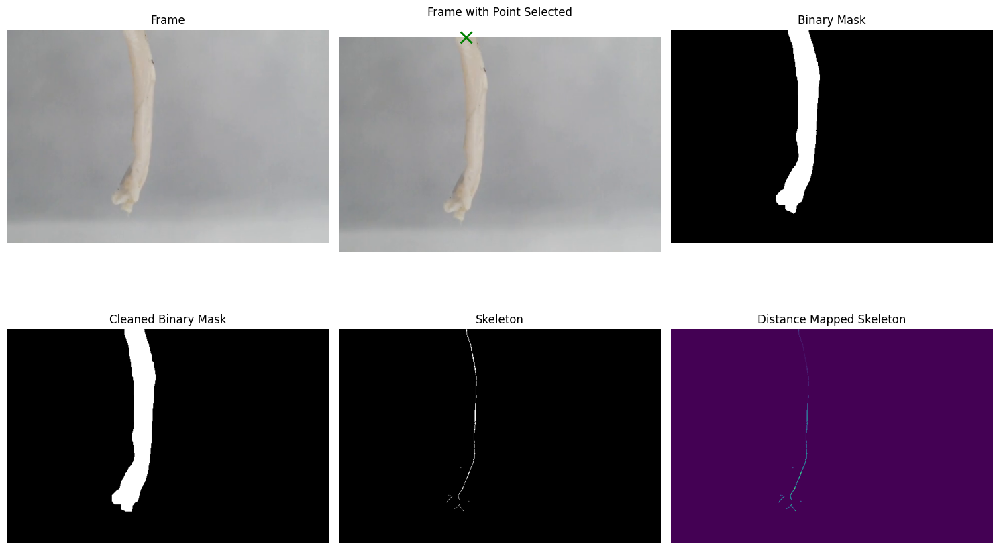

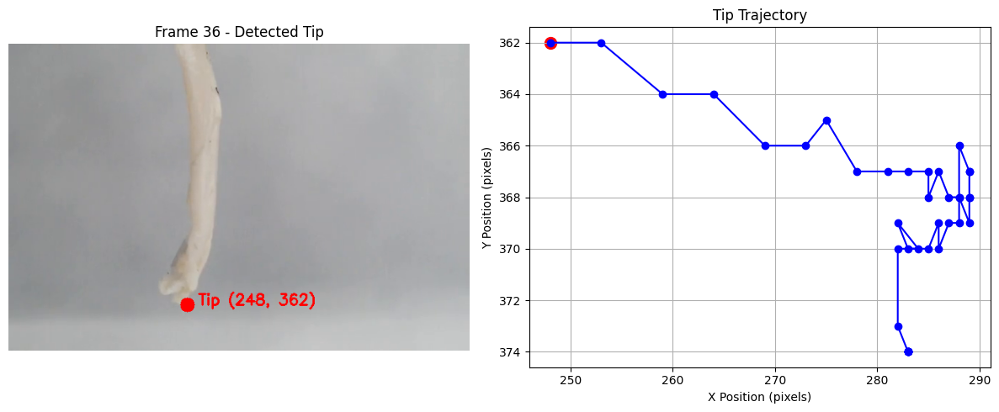


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_041.png: 1024x1024 1 0, 12516.5ms
Speed: 36.8ms preprocess, 12516.5ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


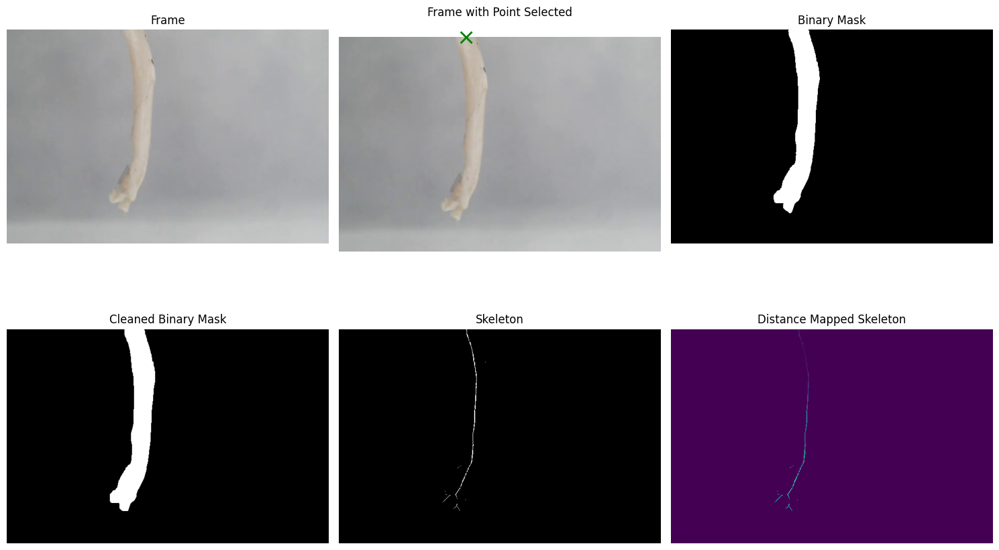

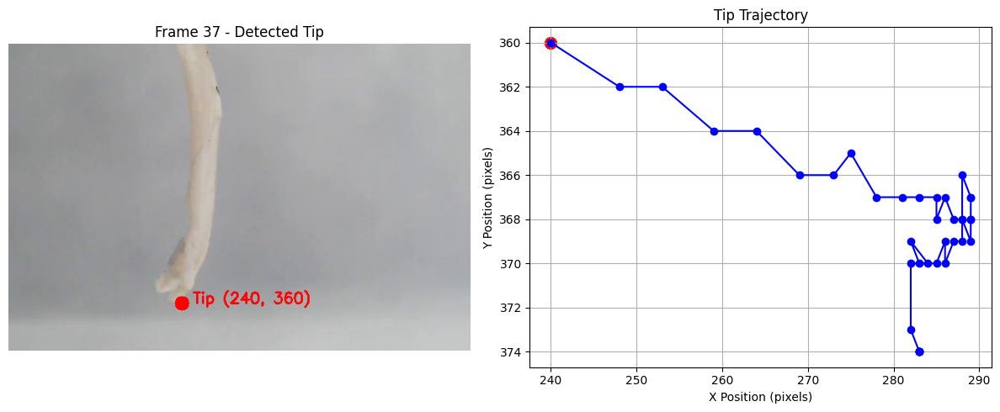


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_042.png: 1024x1024 1 0, 8368.5ms
Speed: 25.3ms preprocess, 8368.5ms inference, 2.0ms postprocess per image at shape (1, 3, 1024, 1024)


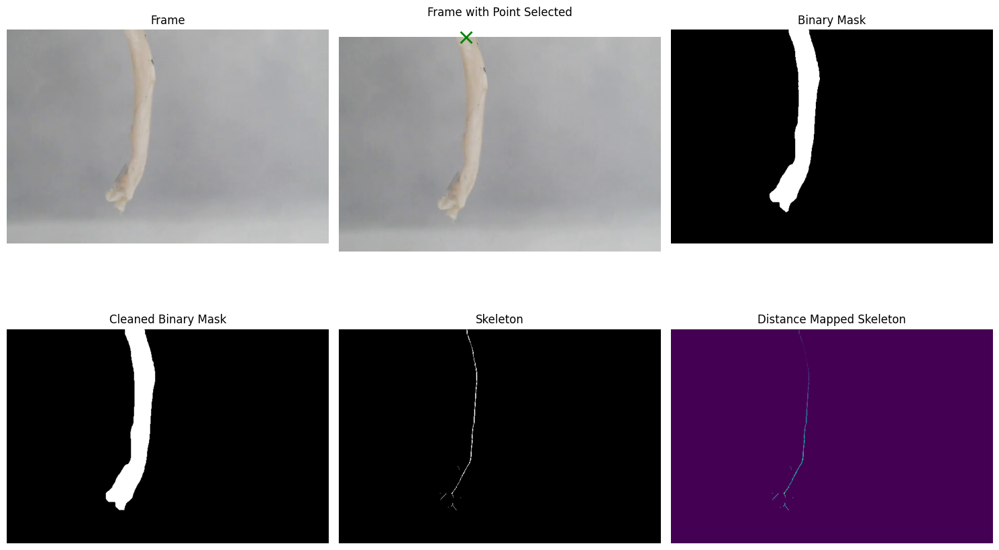

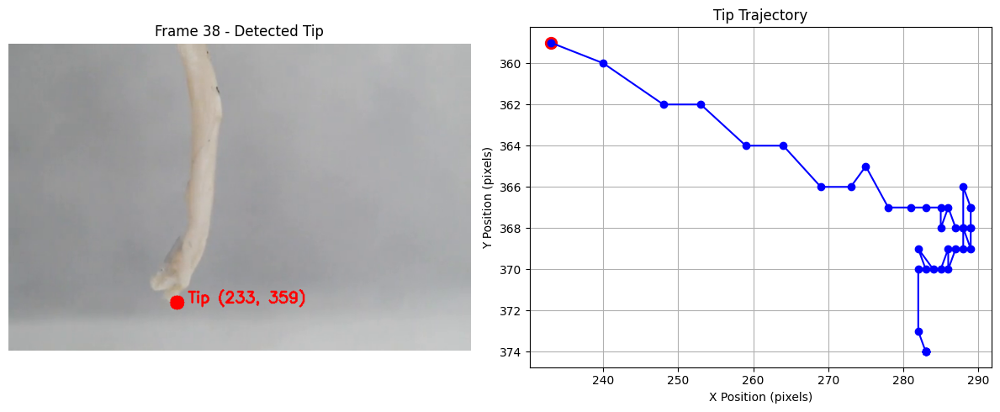


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_043.png: 1024x1024 1 0, 18798.5ms
Speed: 25.4ms preprocess, 18798.5ms inference, 4.8ms postprocess per image at shape (1, 3, 1024, 1024)


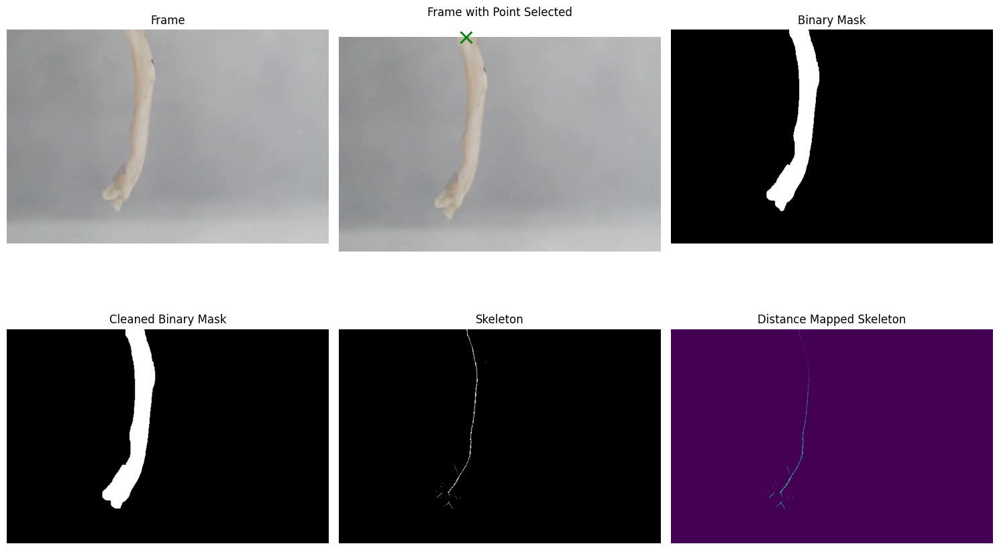

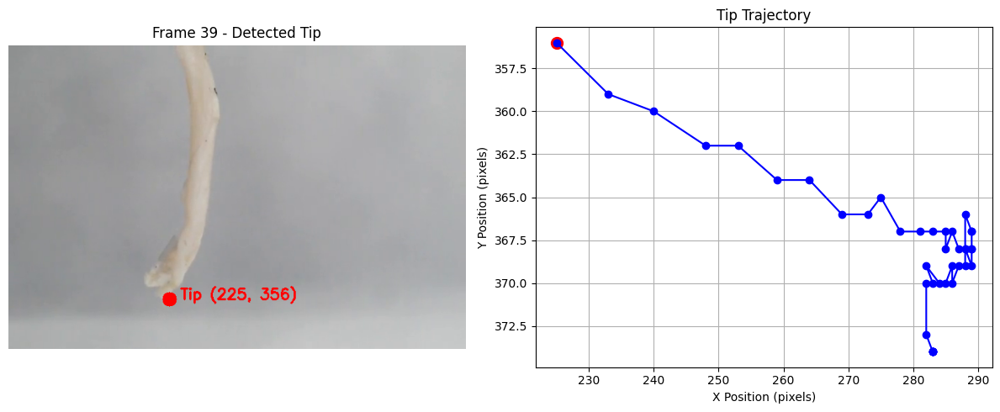


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_044.png: 1024x1024 1 0, 87392.6ms
Speed: 68.8ms preprocess, 87392.6ms inference, 17.9ms postprocess per image at shape (1, 3, 1024, 1024)


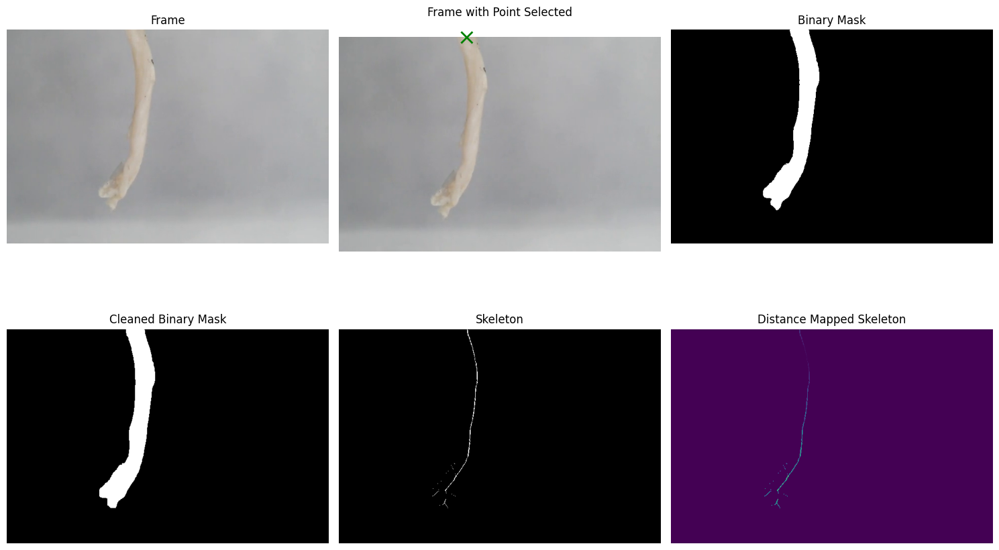

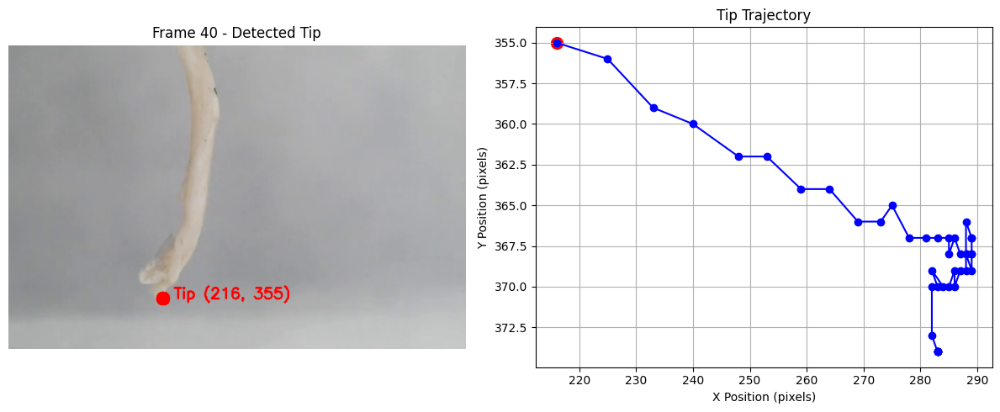


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_045.png: 1024x1024 1 0, 11180.7ms
Speed: 39.1ms preprocess, 11180.7ms inference, 9.0ms postprocess per image at shape (1, 3, 1024, 1024)


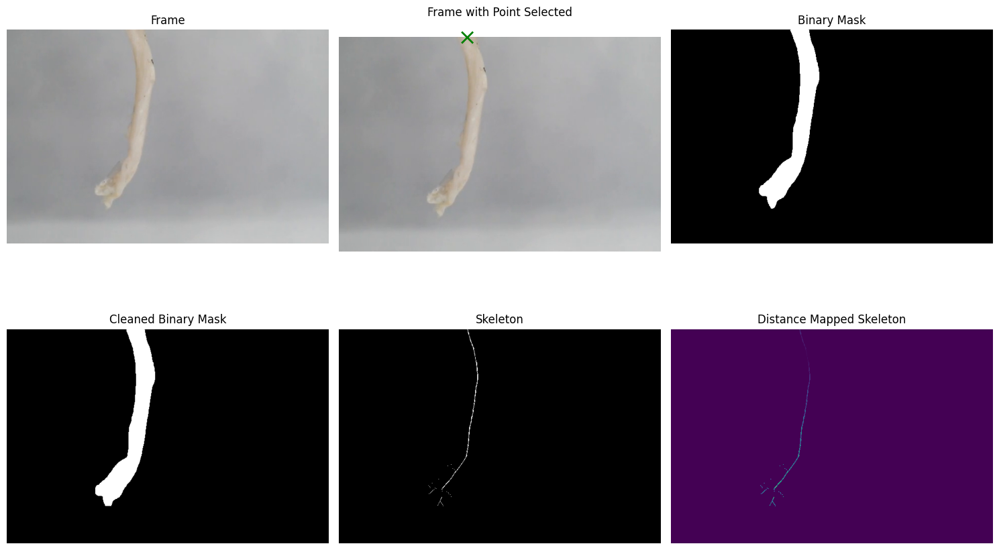

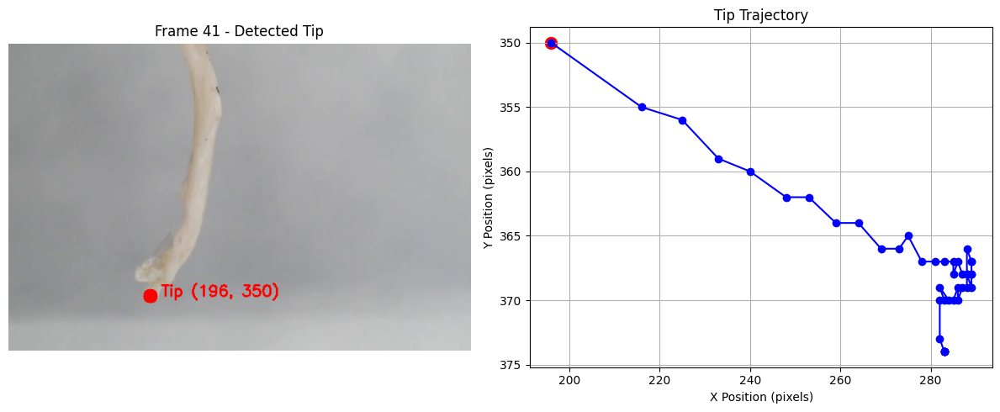


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_046.png: 1024x1024 1 0, 9500.6ms
Speed: 348.0ms preprocess, 9500.6ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)


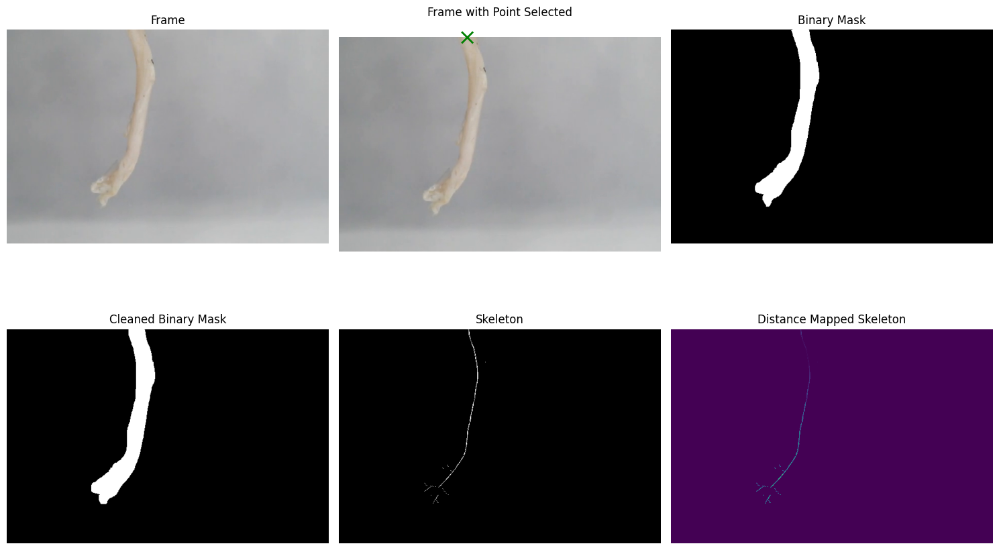

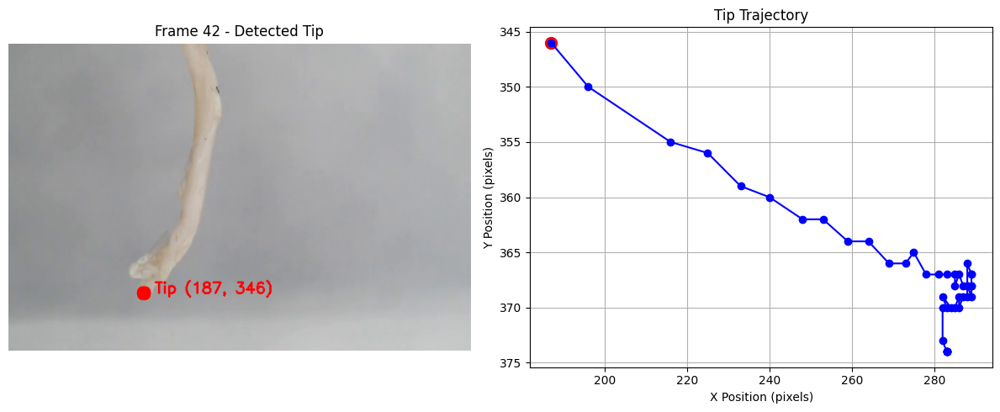


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_047.png: 1024x1024 1 0, 10115.1ms
Speed: 24.8ms preprocess, 10115.1ms inference, 1.9ms postprocess per image at shape (1, 3, 1024, 1024)


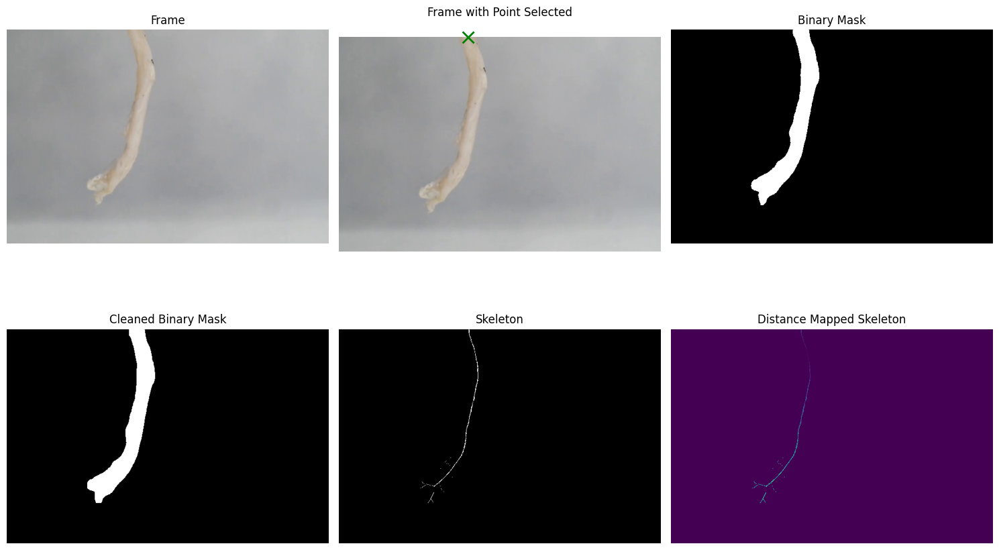

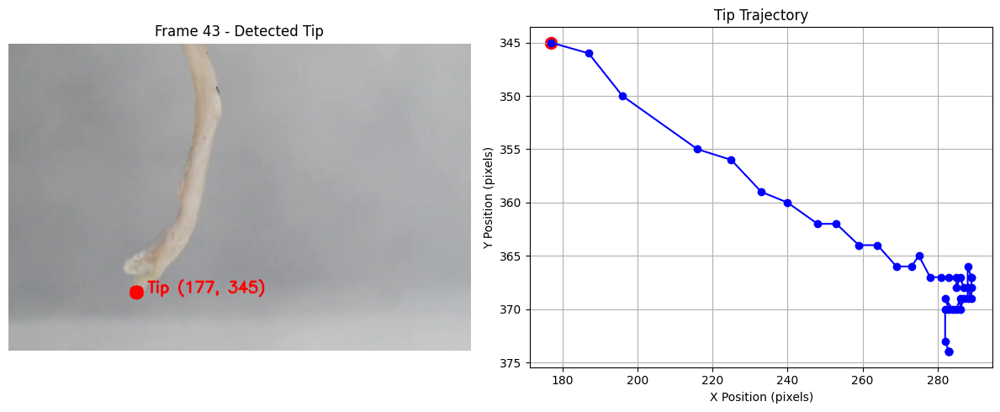


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_048.png: 1024x1024 1 0, 18348.8ms
Speed: 38.9ms preprocess, 18348.8ms inference, 4.2ms postprocess per image at shape (1, 3, 1024, 1024)


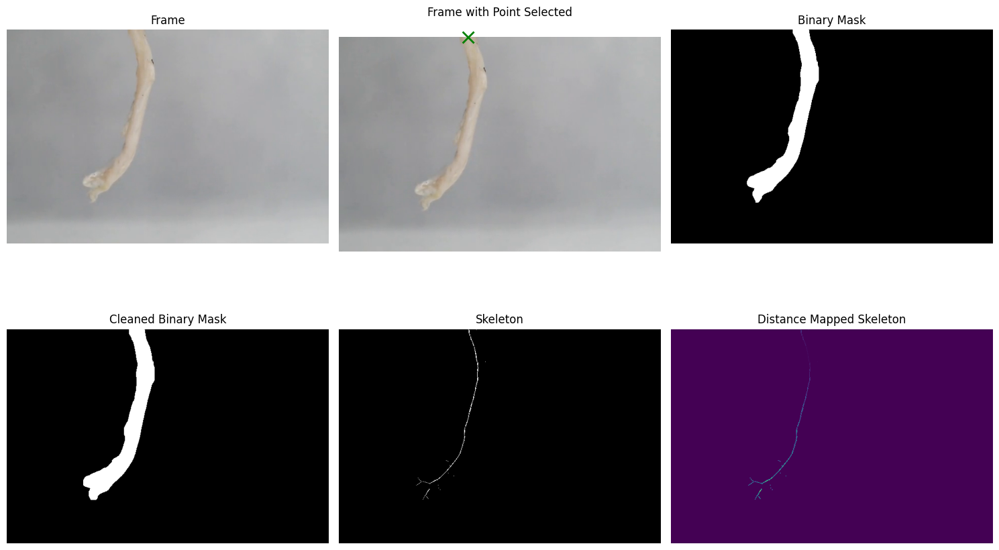

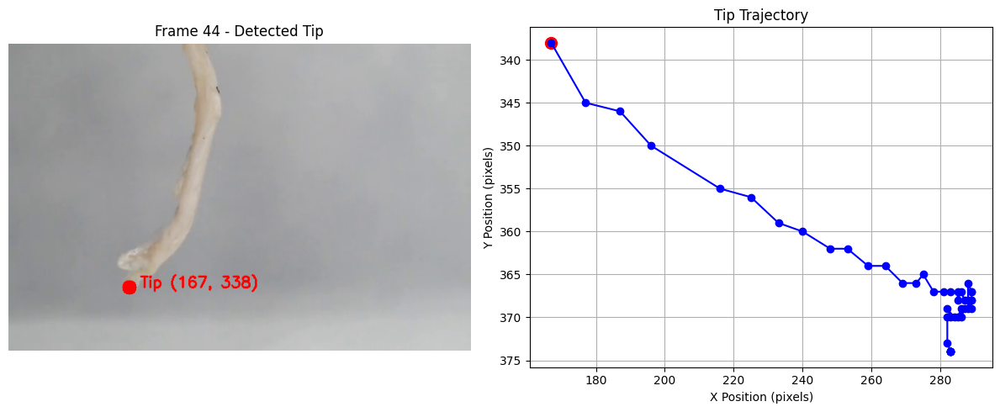


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_049.png: 1024x1024 1 0, 14312.5ms
Speed: 24.7ms preprocess, 14312.5ms inference, 3.5ms postprocess per image at shape (1, 3, 1024, 1024)


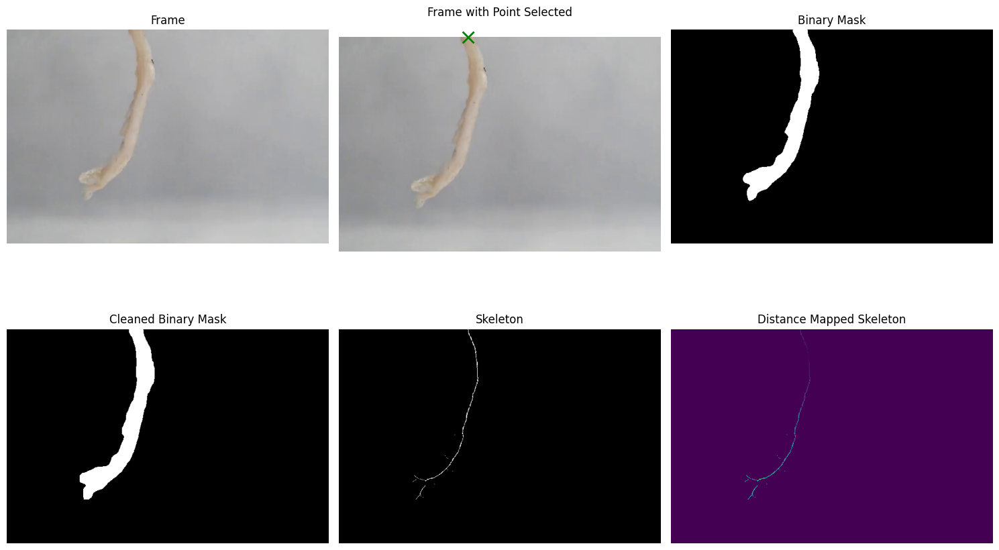

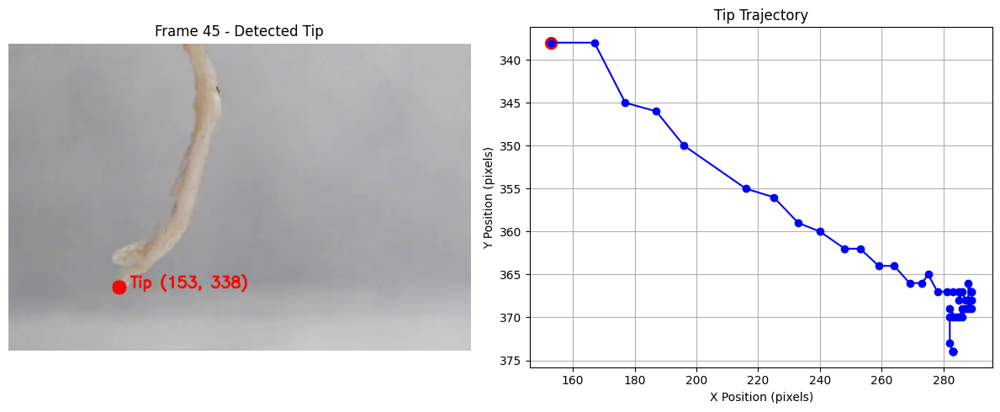


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_050.png: 1024x1024 1 0, 12369.6ms
Speed: 32.3ms preprocess, 12369.6ms inference, 3.0ms postprocess per image at shape (1, 3, 1024, 1024)


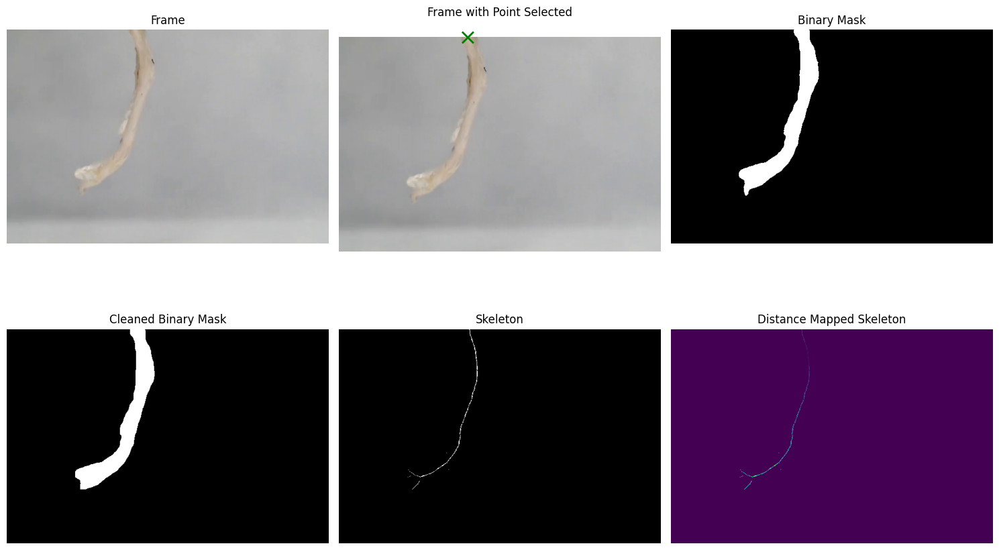

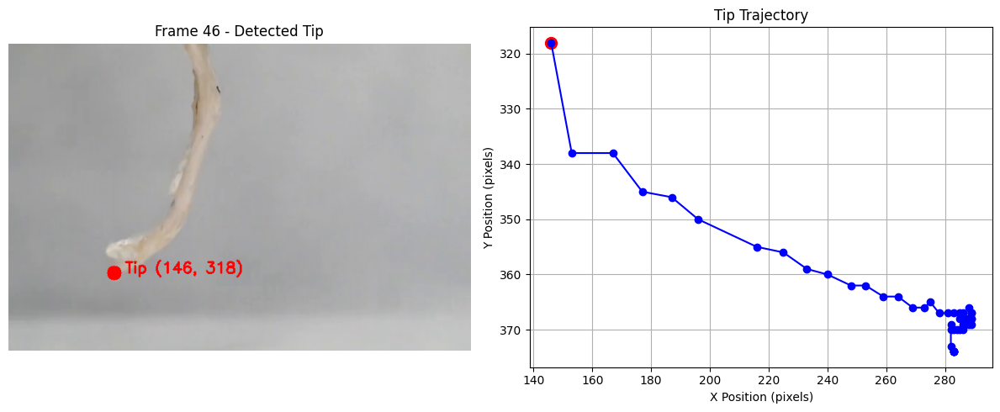


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_051.png: 1024x1024 1 0, 10028.2ms
Speed: 72.2ms preprocess, 10028.2ms inference, 2.3ms postprocess per image at shape (1, 3, 1024, 1024)


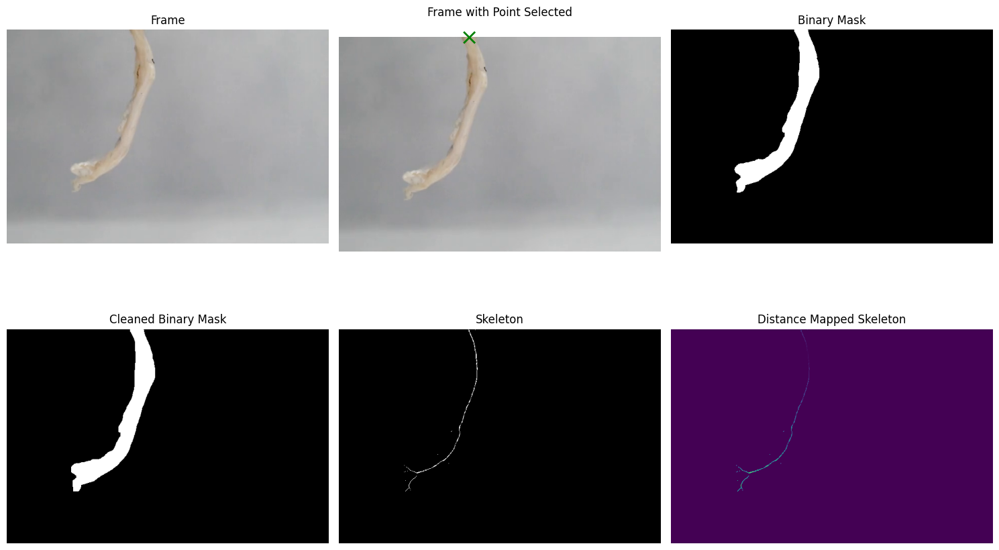

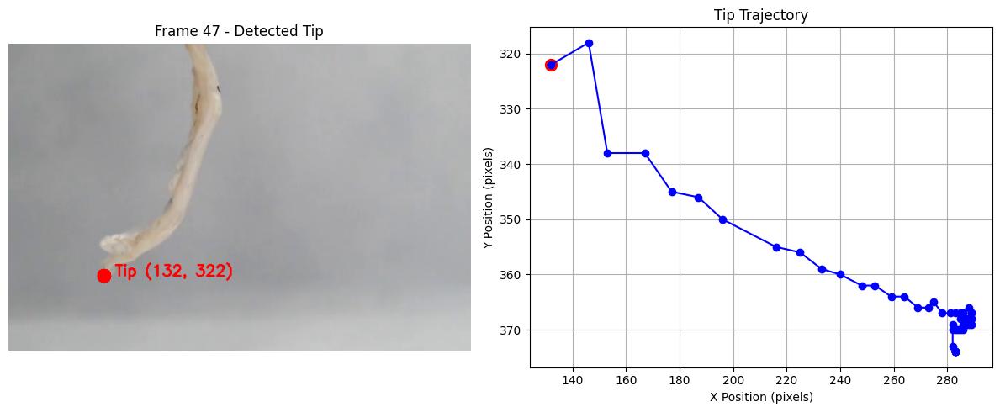


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_052.png: 1024x1024 1 0, 16474.9ms
Speed: 62.3ms preprocess, 16474.9ms inference, 8.5ms postprocess per image at shape (1, 3, 1024, 1024)


In [ ]:
# Set paths
video_name = f"03.26.25_idx0_control_100x" # without the .mov
video_path = f"bimorph_videos/{video_name}.mov"
temp_folder = "tracking_frames/"
start_frame = 3
end_frame = None
frame_interval=0.6
point = (280, 50)

extract_frames(video_path, temp_folder, interval=frame_interval)

track_actuator_tip(
    frame_folder=temp_folder,
    start_frame=start_frame,
    end_frame=end_frame,
    output_file=f"tracked_trajectories/{video_name}_tracked.csv",
    anchor_point=point,
    edge_cushion =0
)


for filename in os.listdir(temp_folder):
    file_path = os.path.join(temp_folder, filename)
    if os.path.isdir(file_path):
        shutil.rmtree(file_path)
    else:
        os.remove(file_path)

In [ ]:
# Set paths
video_name = f"03.25.25_idx1_control_100x" # without the .mov
video_path = f"bimorph_videos/{video_name}.mov"
temp_folder = "tracking_frames/"
start_frame = 3
end_frame = None
frame_interval=0.6
point = (345, 50)

extract_frames(video_path, temp_folder, interval=frame_interval)

track_actuator_tip(
    frame_folder=temp_folder,
    start_frame=start_frame,
    end_frame=end_frame,
    output_file=f"tracked_trajectories/{video_name}_tracked.csv",
    anchor_point=point,
    edge_cushion =0
)


for filename in os.listdir(temp_folder):
    file_path = os.path.join(temp_folder, filename)
    if os.path.isdir(file_path):
        shutil.rmtree(file_path)
    else:
        os.remove(file_path)

ffmpeg version 7.0.1 Copyright (c) 2000-2024 the FFmpeg developers
  built with Apple clang version 15.0.0 (clang-1500.3.9.4)
  configuration: --prefix=/usr/local/Cellar/ffmpeg/7.0.1 --enable-shared --enable-pthreads --enable-version3 --cc=clang --host-cflags= --host-ldflags='-Wl,-ld_classic' --enable-ffplay --enable-gnutls --enable-gpl --enable-libaom --enable-libaribb24 --enable-libbluray --enable-libdav1d --enable-libharfbuzz --enable-libjxl --enable-libmp3lame --enable-libopus --enable-librav1e --enable-librist --enable-librubberband --enable-libsnappy --enable-libsrt --enable-libssh --enable-libsvtav1 --enable-libtesseract --enable-libtheora --enable-libvidstab --enable-libvmaf --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lzma --enable-libfontconfig --enable-libfreetype --enable-frei0r --enable-libass --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-libspeex --ena

Analyzing frames 3 to 30
Total frames used: 28



[out#0/image2 @ 0x7f8dc2811900] video:2358KiB audio:0KiB subtitle:0KiB other streams:0KiB global headers:0KiB muxing overhead: unknown
frame=   31 fps=0.0 q=-0.0 Lsize=N/A time=00:00:18.60 bitrate=N/A speed=90.1x    


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_004.png: 1024x1024 1 0, 8572.3ms
Speed: 29.7ms preprocess, 8572.3ms inference, 1.9ms postprocess per image at shape (1, 3, 1024, 1024)


<Figure size 1200x1000 with 0 Axes>

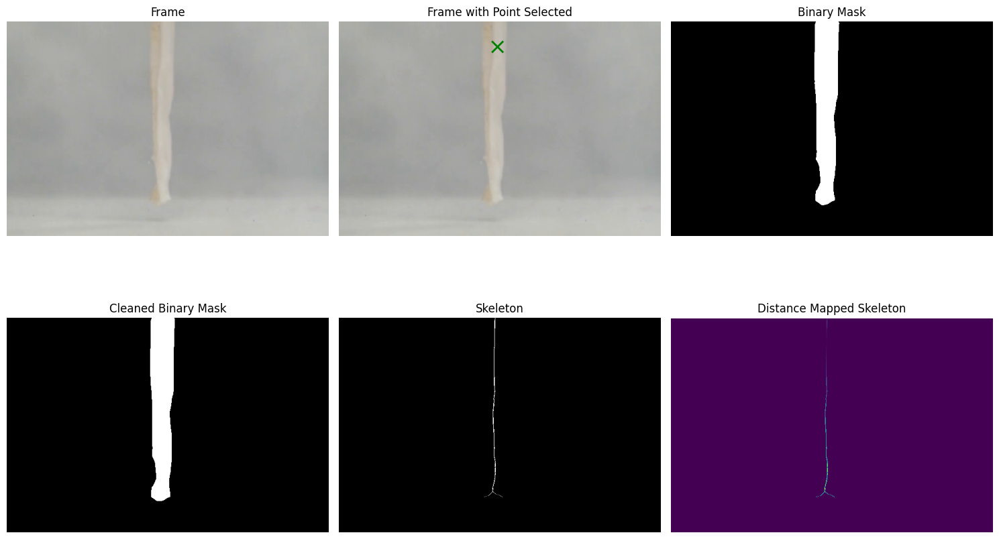

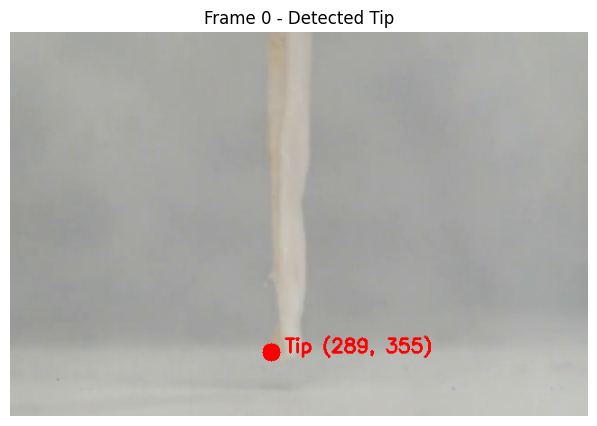


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_005.png: 1024x1024 1 0, 8031.7ms
Speed: 20.8ms preprocess, 8031.7ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


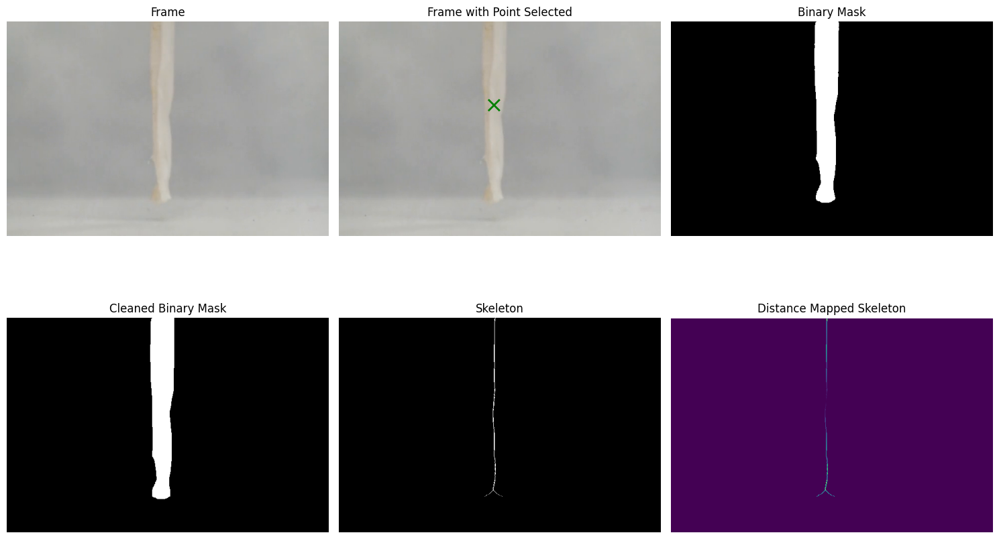

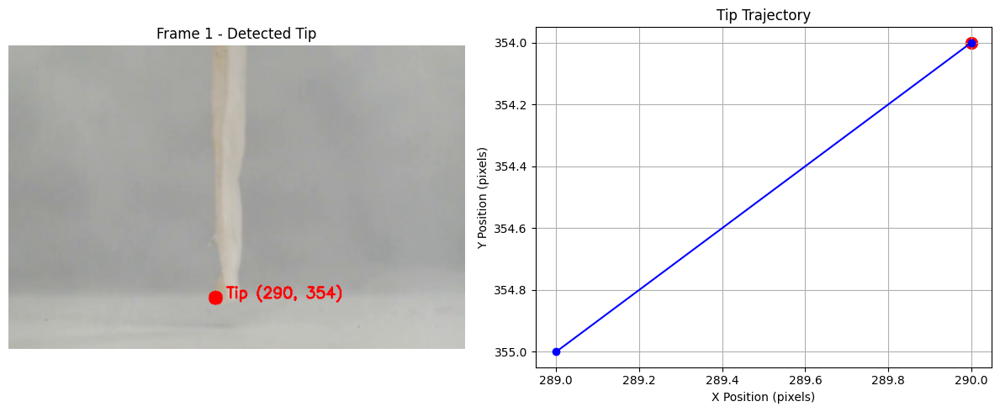


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_006.png: 1024x1024 1 0, 8729.5ms
Speed: 25.0ms preprocess, 8729.5ms inference, 2.0ms postprocess per image at shape (1, 3, 1024, 1024)


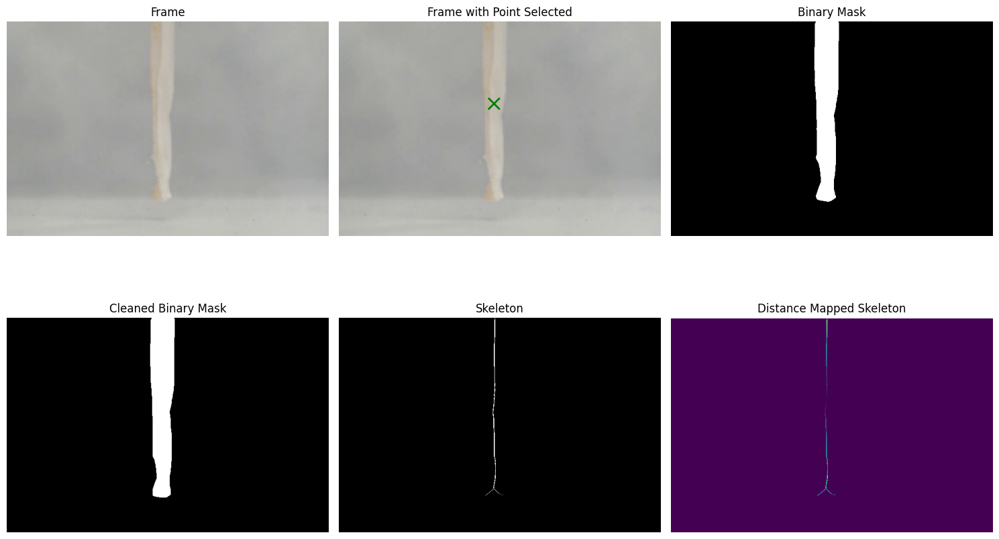

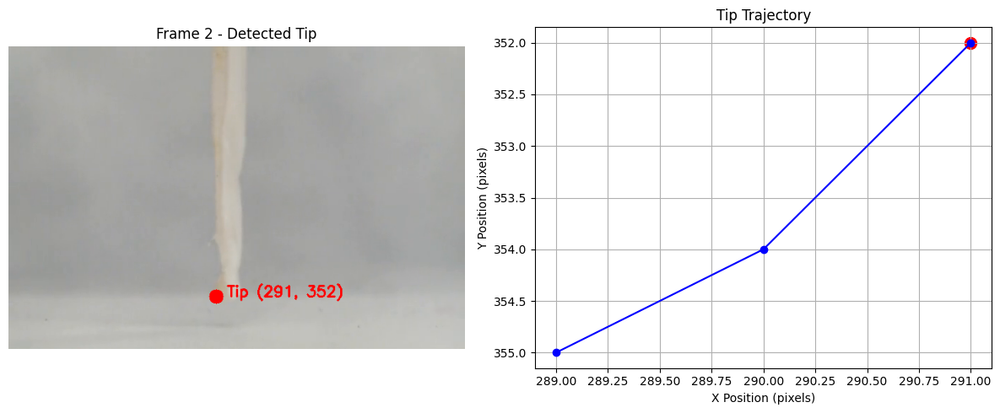


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_007.png: 1024x1024 1 0, 8899.7ms
Speed: 20.3ms preprocess, 8899.7ms inference, 2.3ms postprocess per image at shape (1, 3, 1024, 1024)


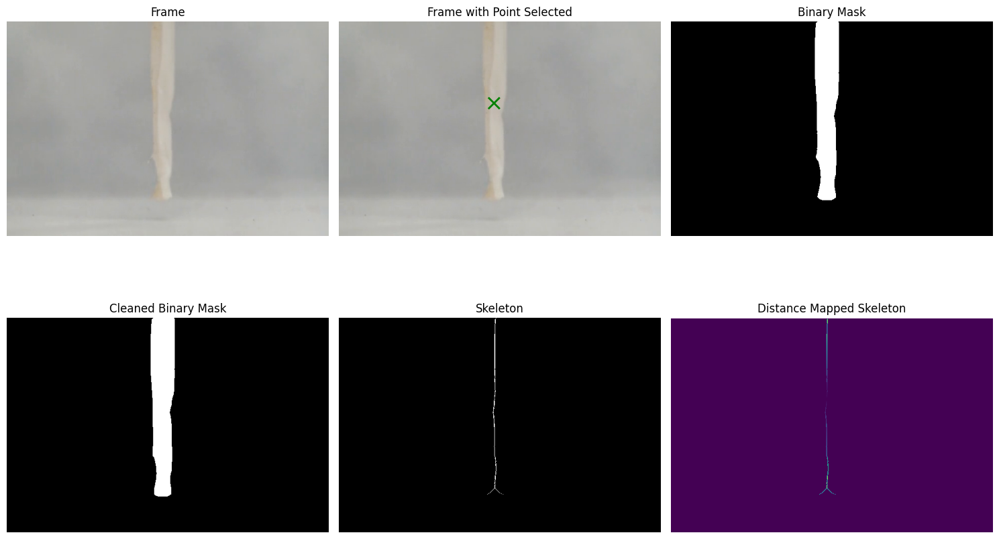

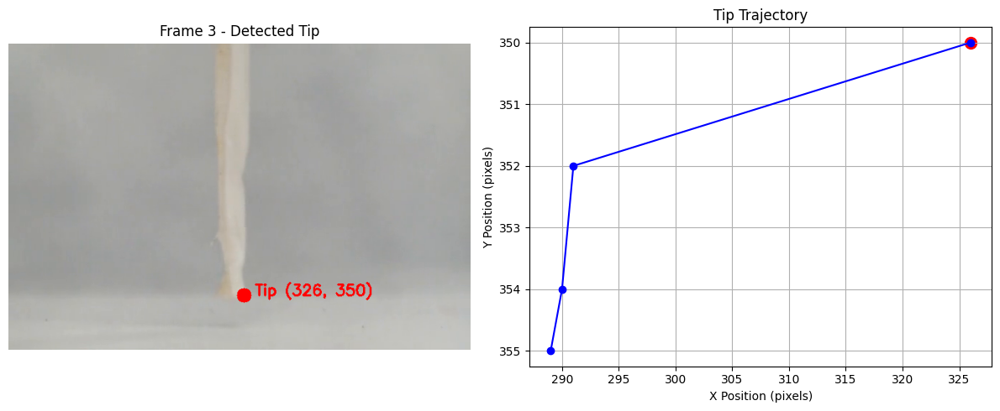


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_008.png: 1024x1024 1 0, 8498.6ms
Speed: 25.2ms preprocess, 8498.6ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


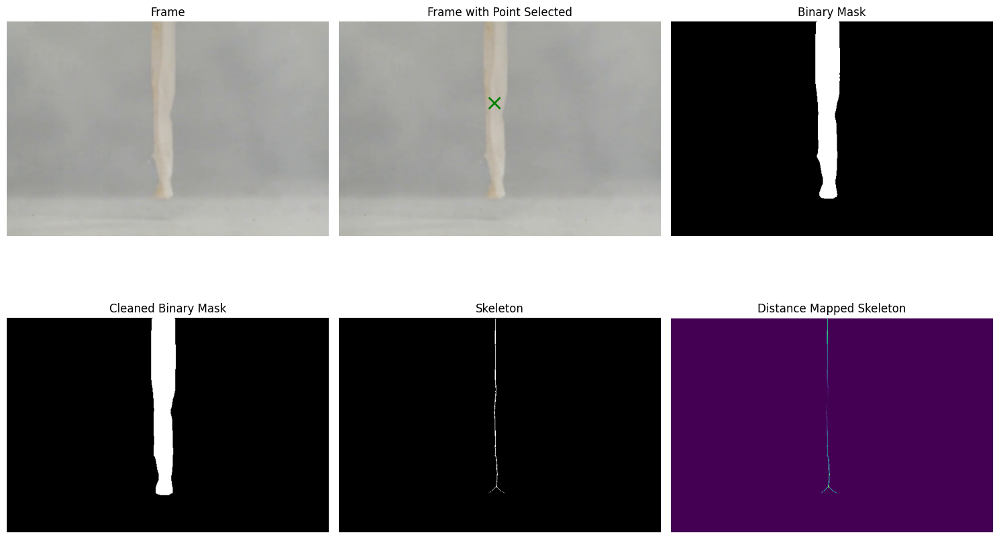

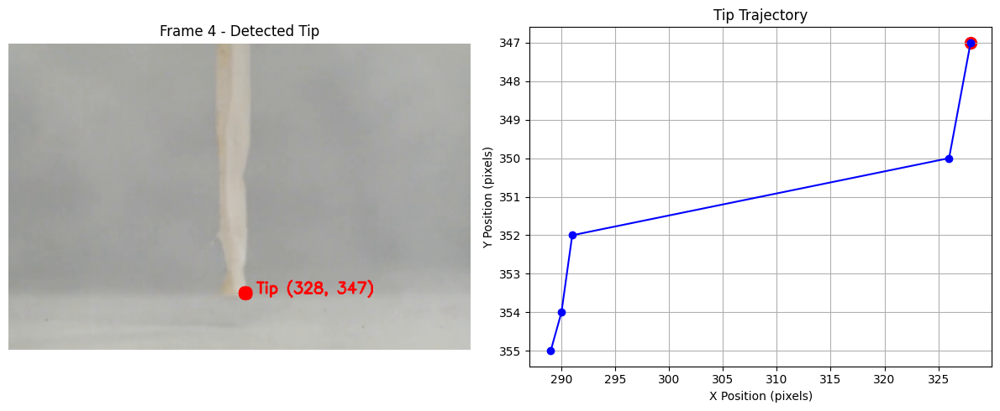


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_009.png: 1024x1024 1 0, 8886.9ms
Speed: 21.9ms preprocess, 8886.9ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


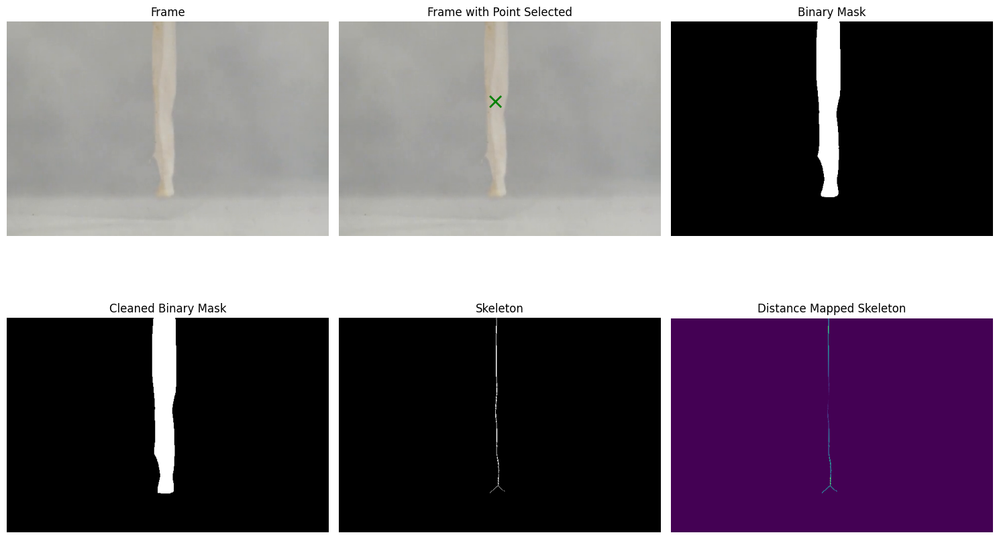

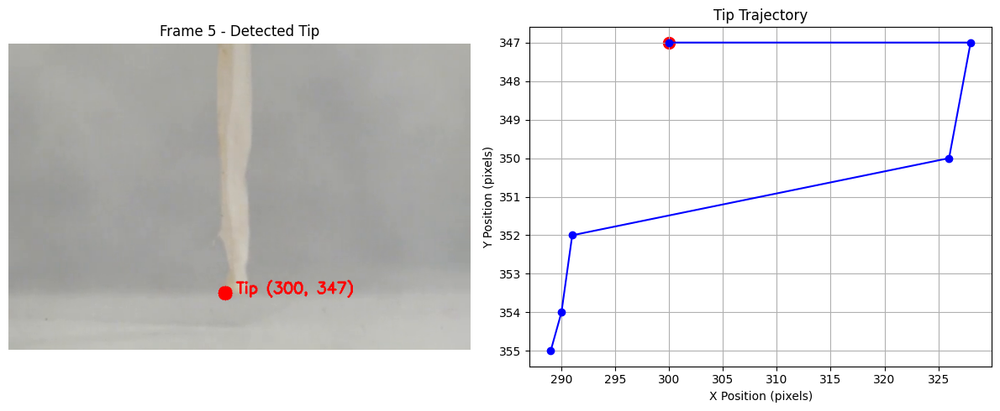


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_010.png: 1024x1024 1 0, 8023.8ms
Speed: 23.1ms preprocess, 8023.8ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


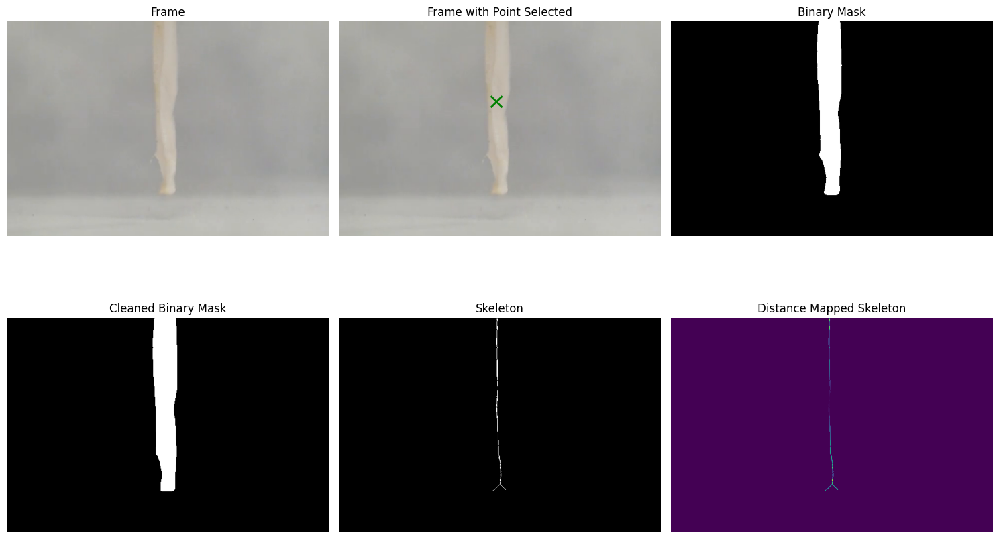

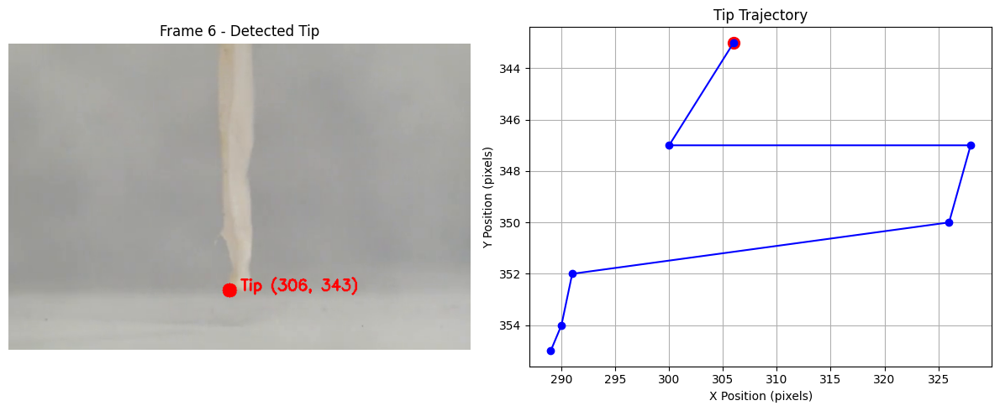


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_011.png: 1024x1024 1 0, 8168.4ms
Speed: 21.7ms preprocess, 8168.4ms inference, 2.1ms postprocess per image at shape (1, 3, 1024, 1024)


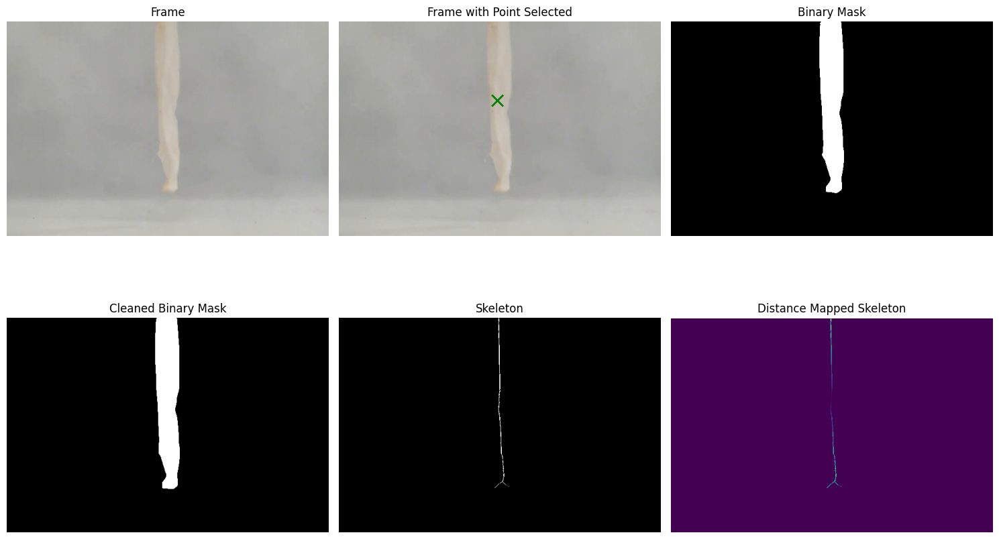

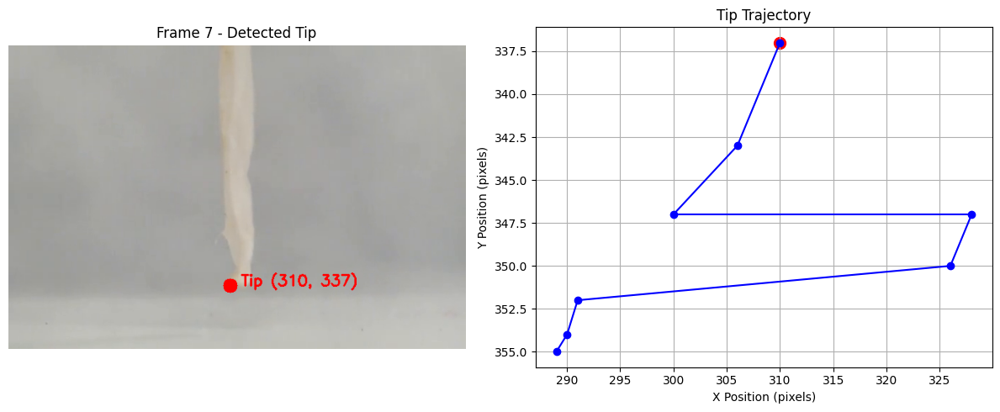


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_012.png: 1024x1024 1 0, 13763.1ms
Speed: 85.1ms preprocess, 13763.1ms inference, 4.0ms postprocess per image at shape (1, 3, 1024, 1024)


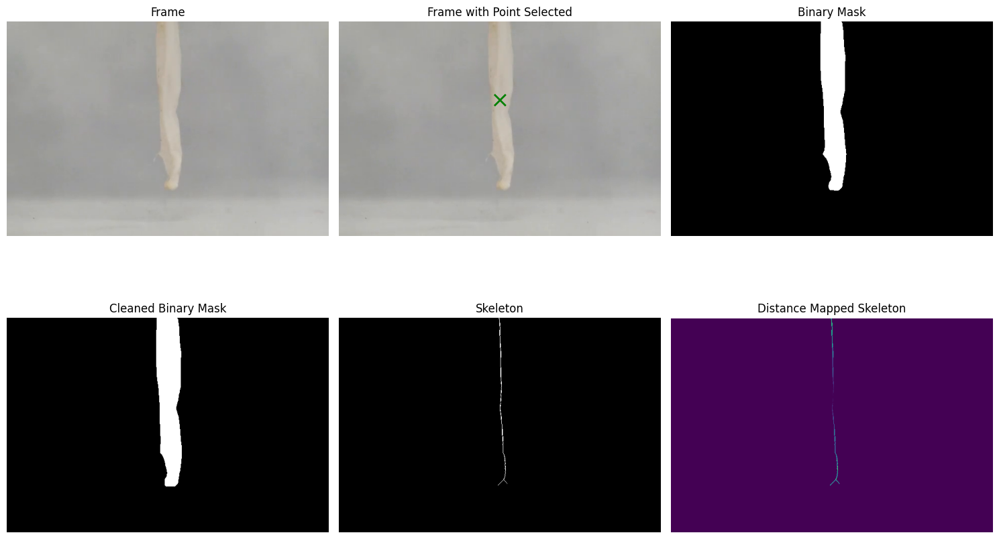

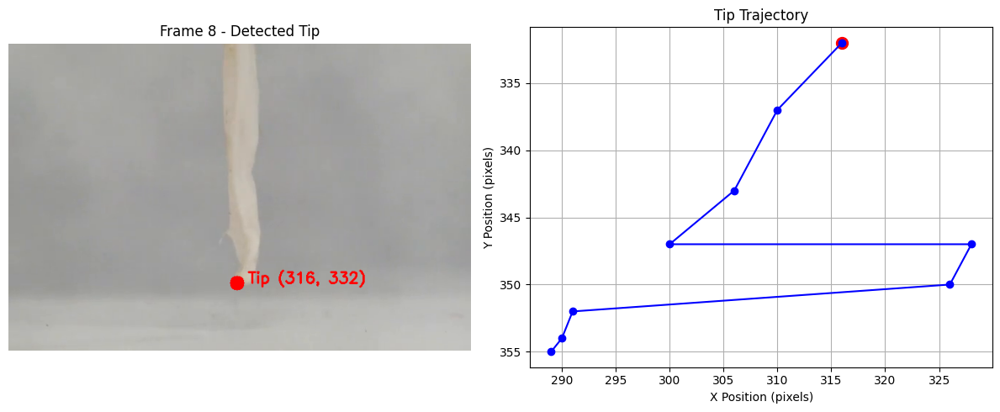


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_013.png: 1024x1024 1 0, 13610.5ms
Speed: 23.8ms preprocess, 13610.5ms inference, 3.8ms postprocess per image at shape (1, 3, 1024, 1024)


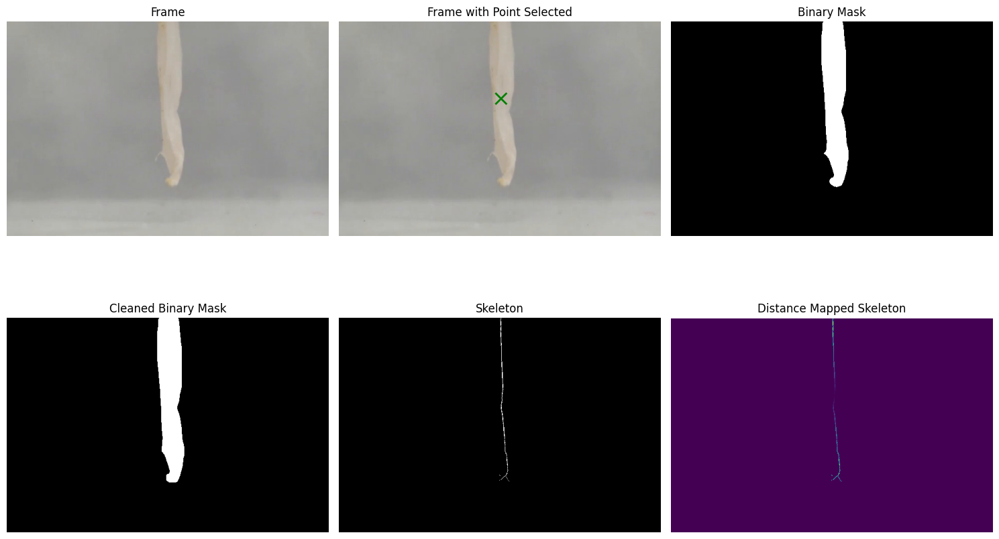

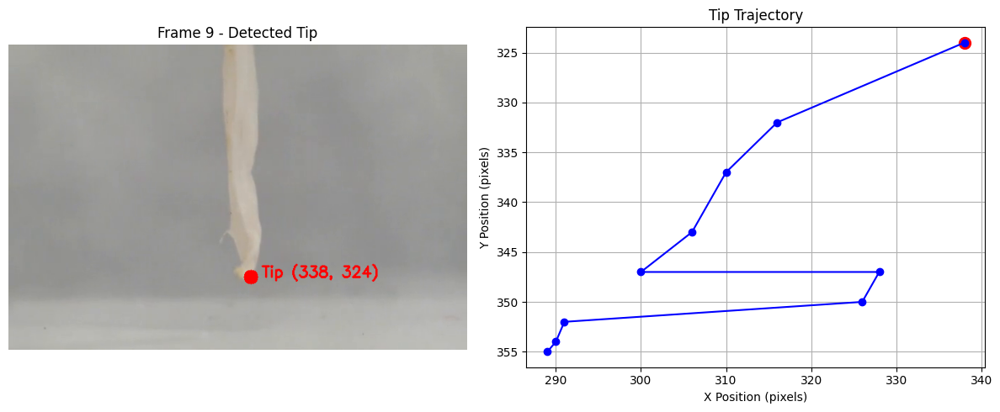


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_014.png: 1024x1024 1 0, 16746.0ms
Speed: 198.3ms preprocess, 16746.0ms inference, 4.1ms postprocess per image at shape (1, 3, 1024, 1024)


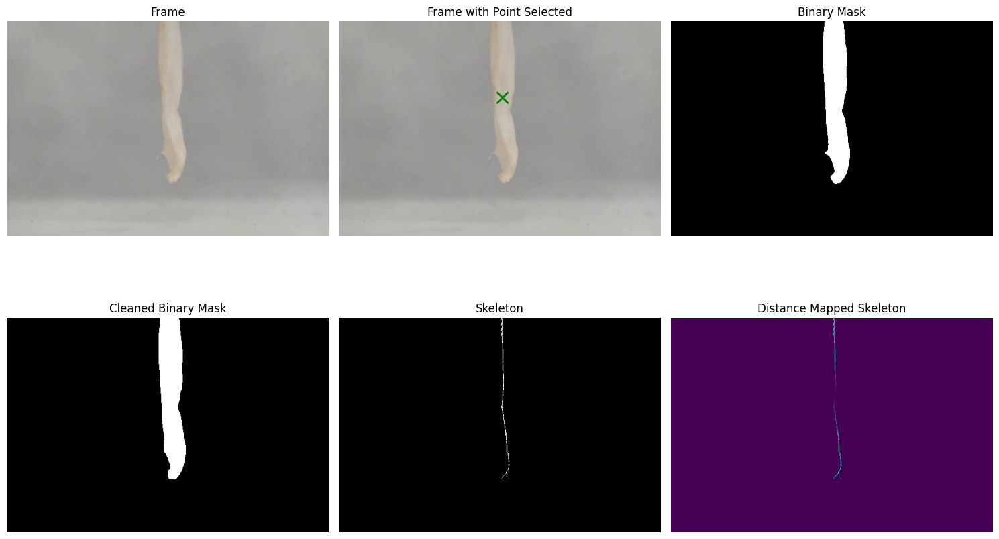

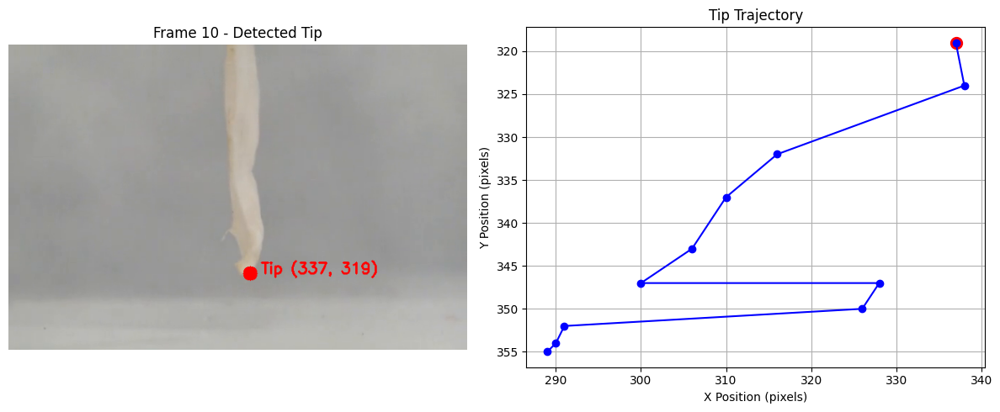


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_015.png: 1024x1024 1 0, 12005.6ms
Speed: 28.5ms preprocess, 12005.6ms inference, 8.1ms postprocess per image at shape (1, 3, 1024, 1024)


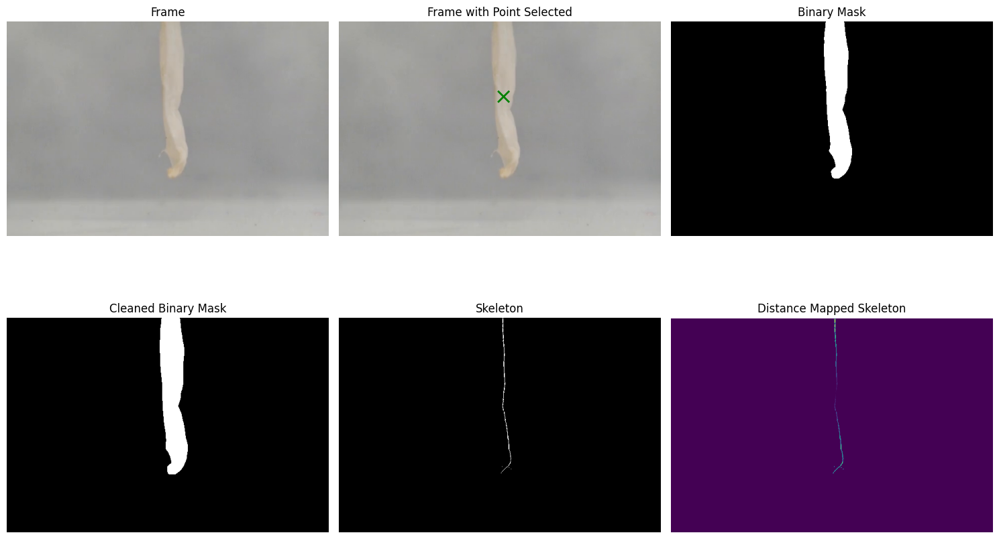

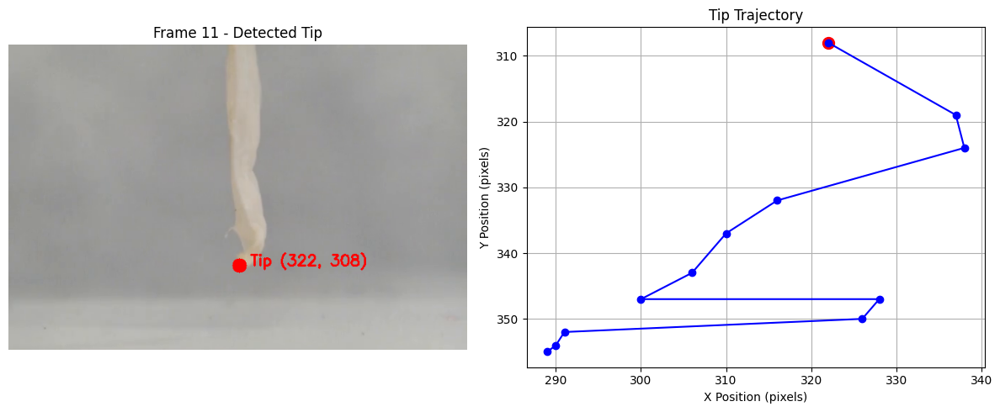


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_016.png: 1024x1024 1 0, 13507.1ms
Speed: 27.6ms preprocess, 13507.1ms inference, 2.3ms postprocess per image at shape (1, 3, 1024, 1024)


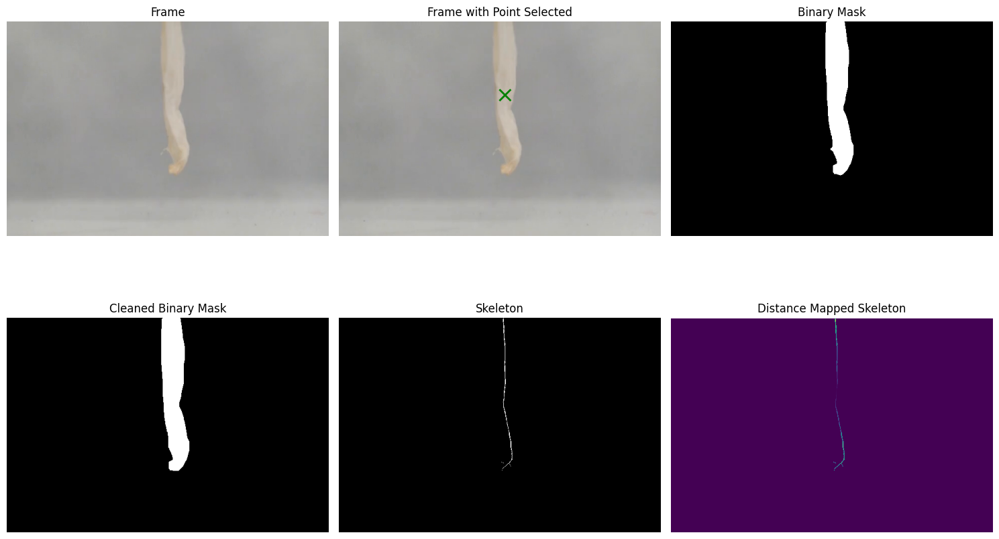

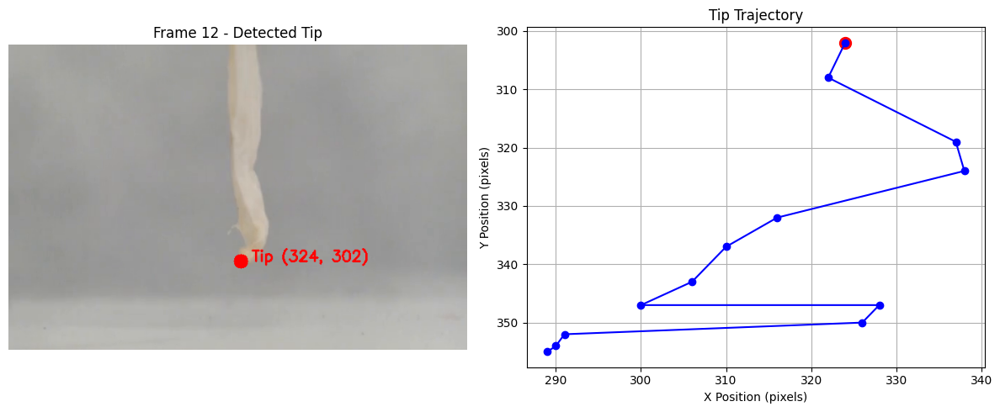


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_017.png: 1024x1024 1 0, 11265.4ms
Speed: 37.0ms preprocess, 11265.4ms inference, 1.9ms postprocess per image at shape (1, 3, 1024, 1024)


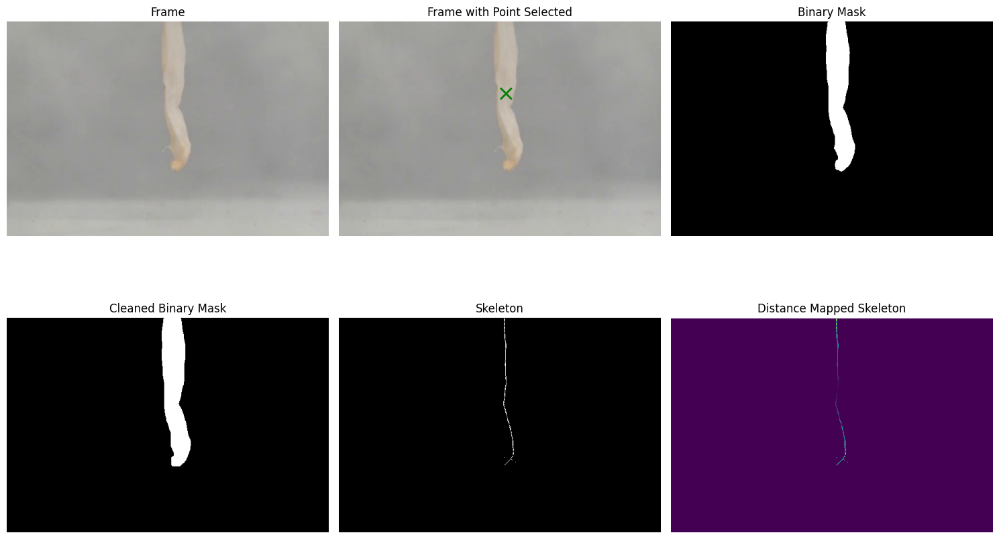

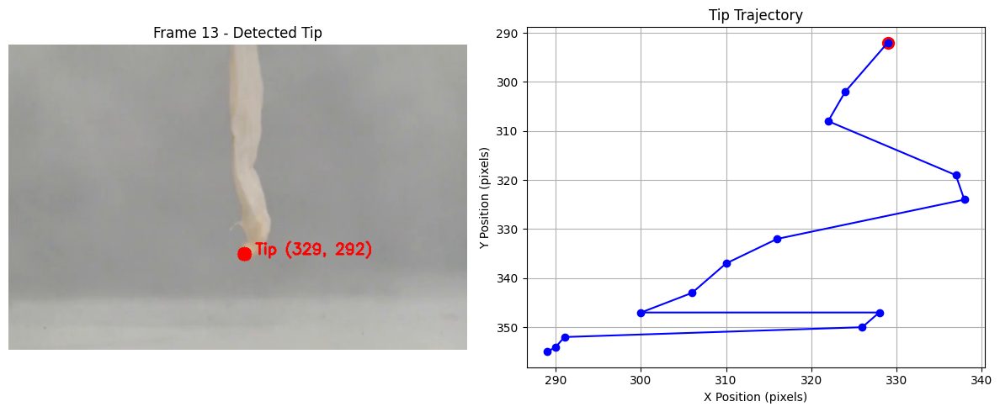


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_018.png: 1024x1024 1 0, 9157.9ms
Speed: 92.1ms preprocess, 9157.9ms inference, 1.9ms postprocess per image at shape (1, 3, 1024, 1024)


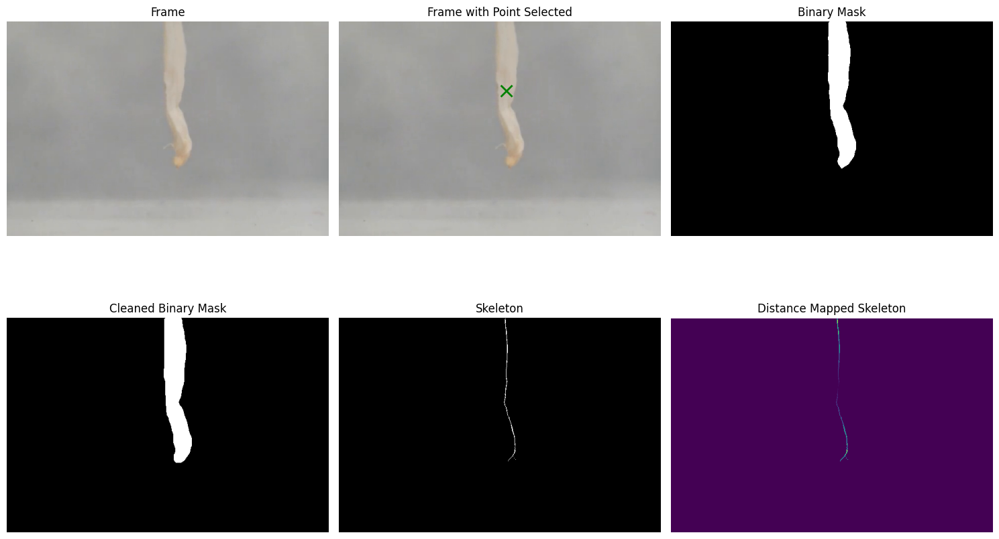

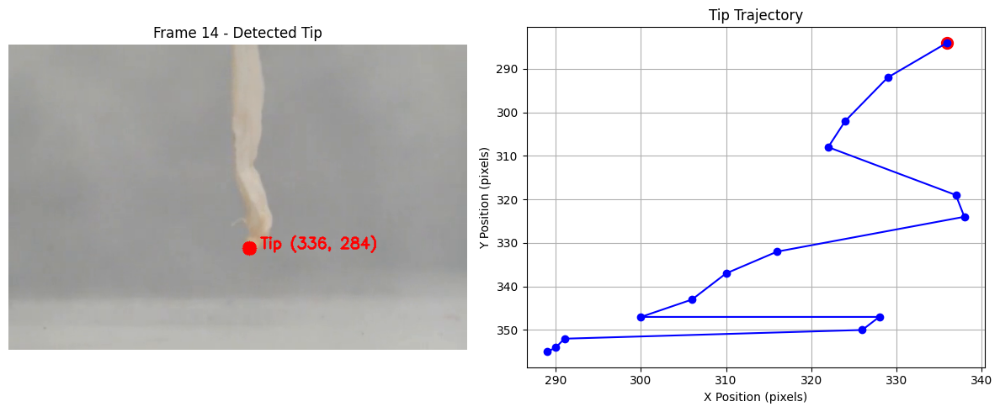


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_019.png: 1024x1024 1 0, 8512.1ms
Speed: 21.9ms preprocess, 8512.1ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


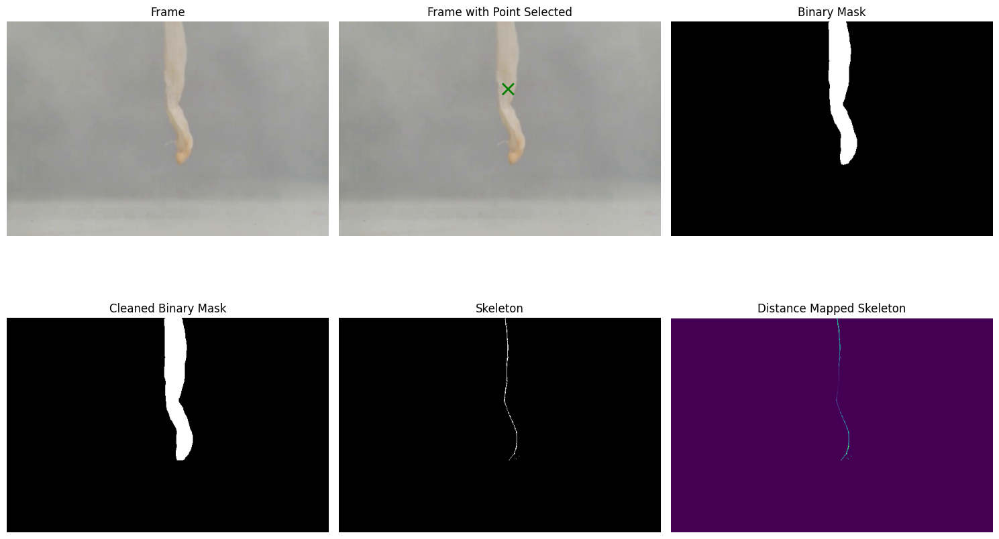

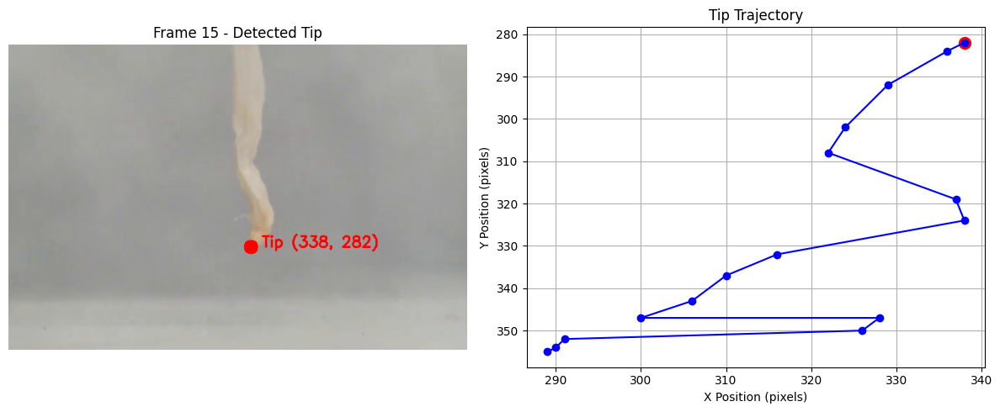


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_020.png: 1024x1024 1 0, 10457.8ms
Speed: 23.4ms preprocess, 10457.8ms inference, 2.1ms postprocess per image at shape (1, 3, 1024, 1024)


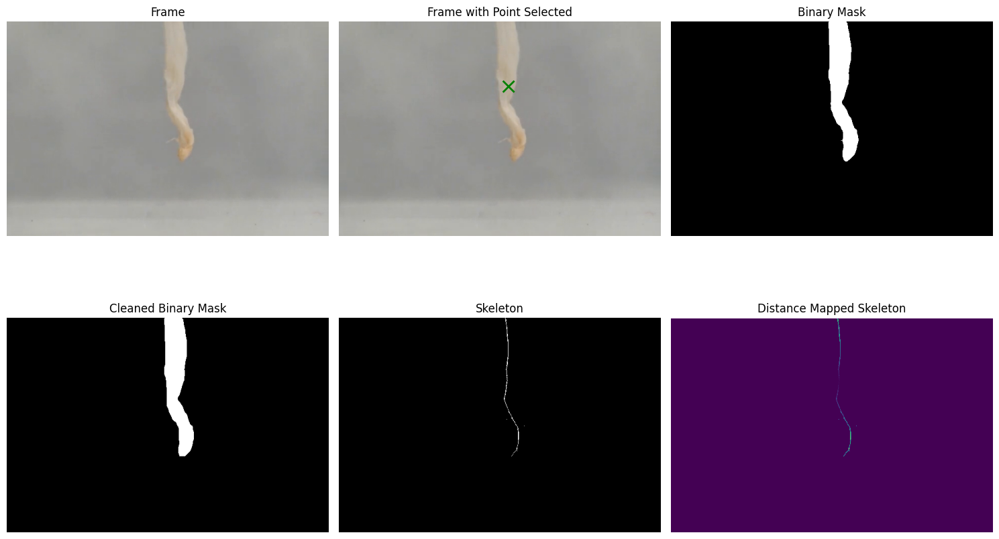

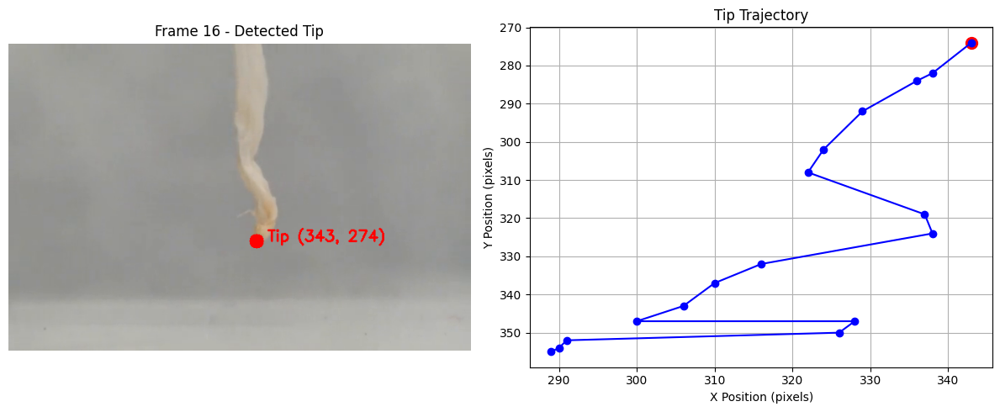


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_021.png: 1024x1024 1 0, 8720.0ms
Speed: 26.2ms preprocess, 8720.0ms inference, 1.9ms postprocess per image at shape (1, 3, 1024, 1024)


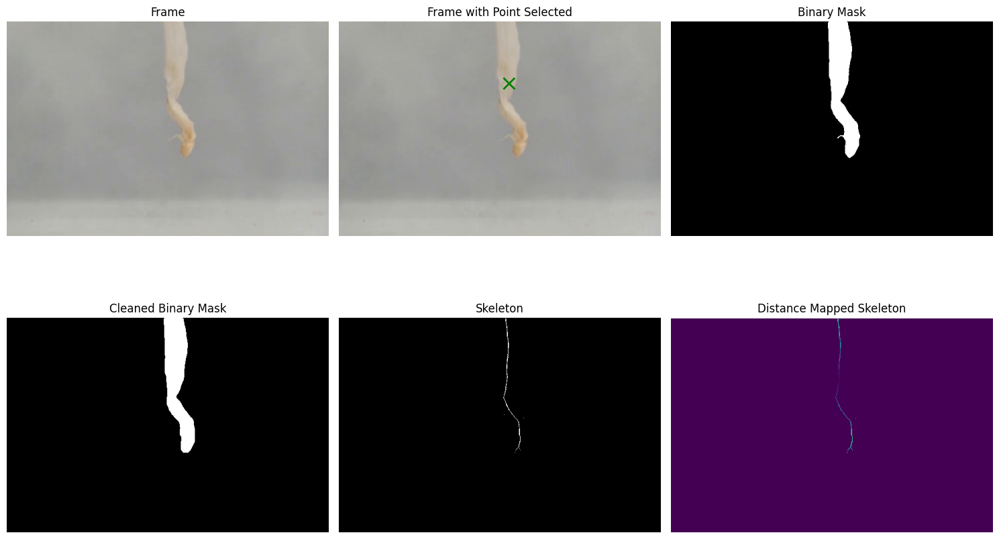

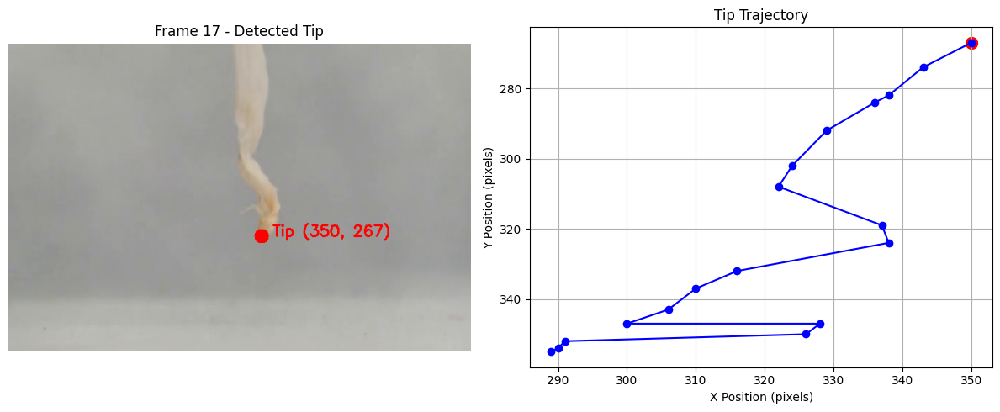


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_022.png: 1024x1024 1 0, 11159.1ms
Speed: 97.0ms preprocess, 11159.1ms inference, 2.3ms postprocess per image at shape (1, 3, 1024, 1024)


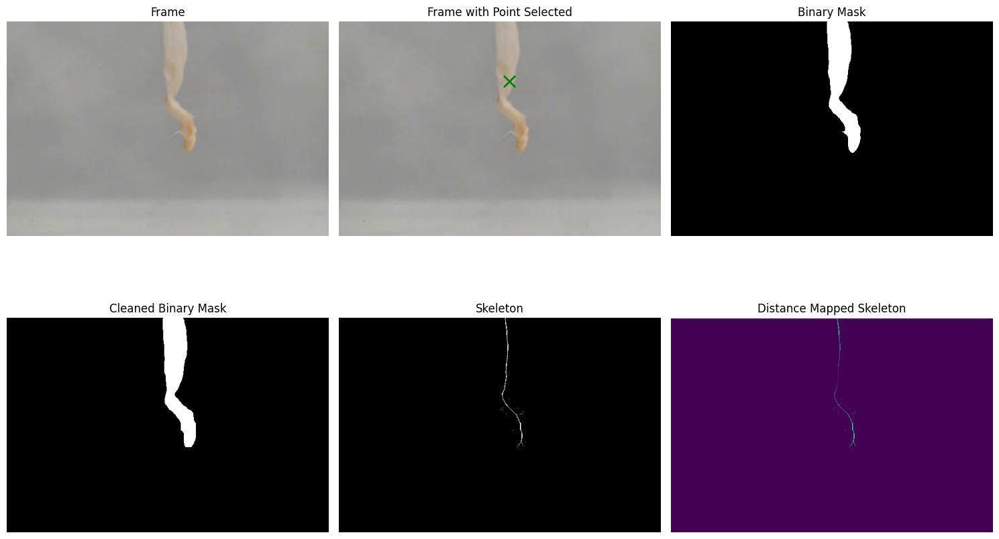

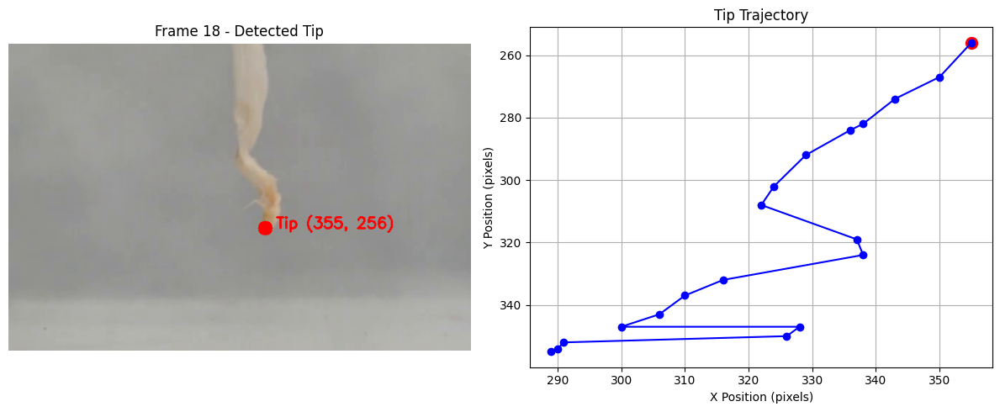


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_023.png: 1024x1024 1 0, 8421.3ms
Speed: 22.6ms preprocess, 8421.3ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


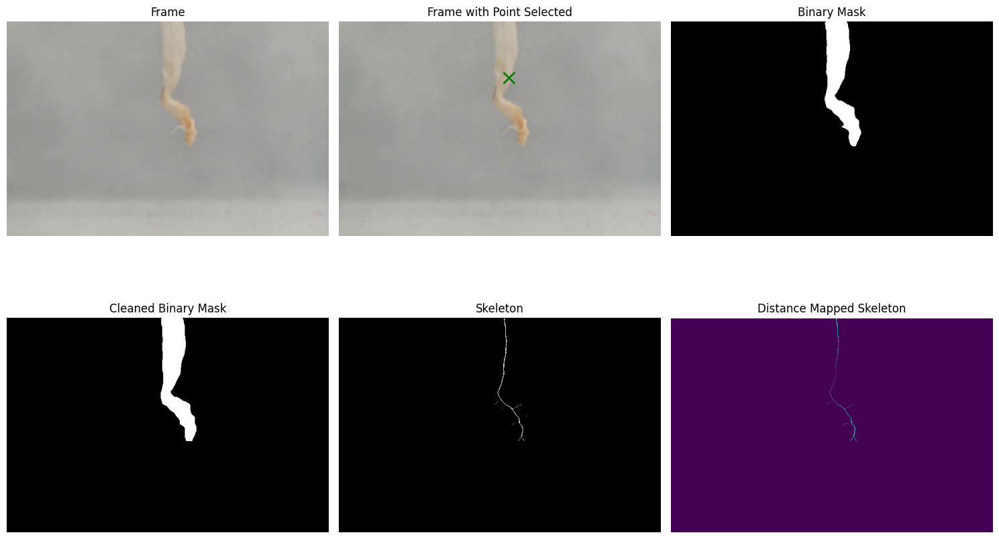

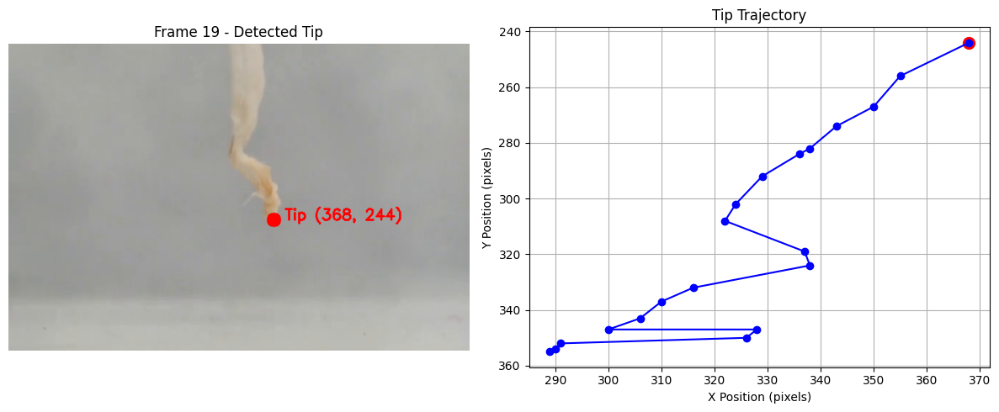


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_024.png: 1024x1024 1 0, 8489.0ms
Speed: 25.2ms preprocess, 8489.0ms inference, 1.9ms postprocess per image at shape (1, 3, 1024, 1024)


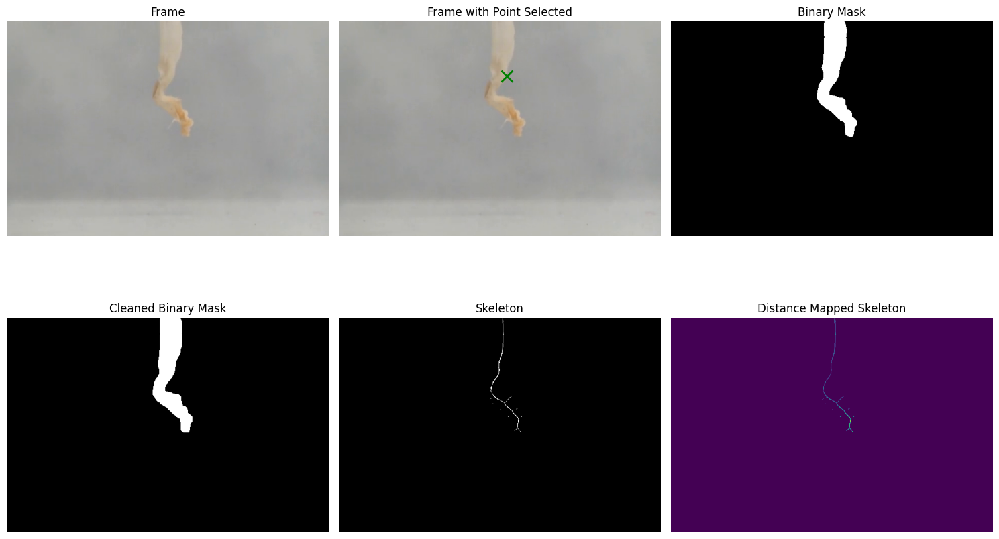

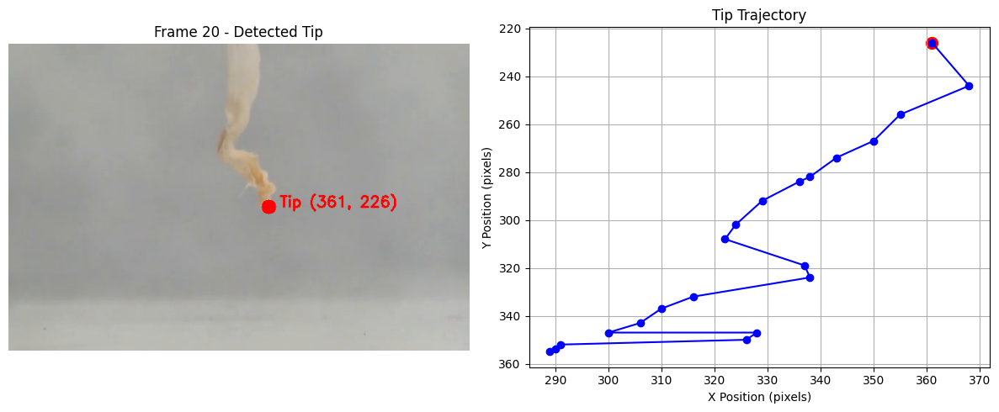


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_025.png: 1024x1024 1 0, 9061.8ms
Speed: 31.3ms preprocess, 9061.8ms inference, 2.4ms postprocess per image at shape (1, 3, 1024, 1024)


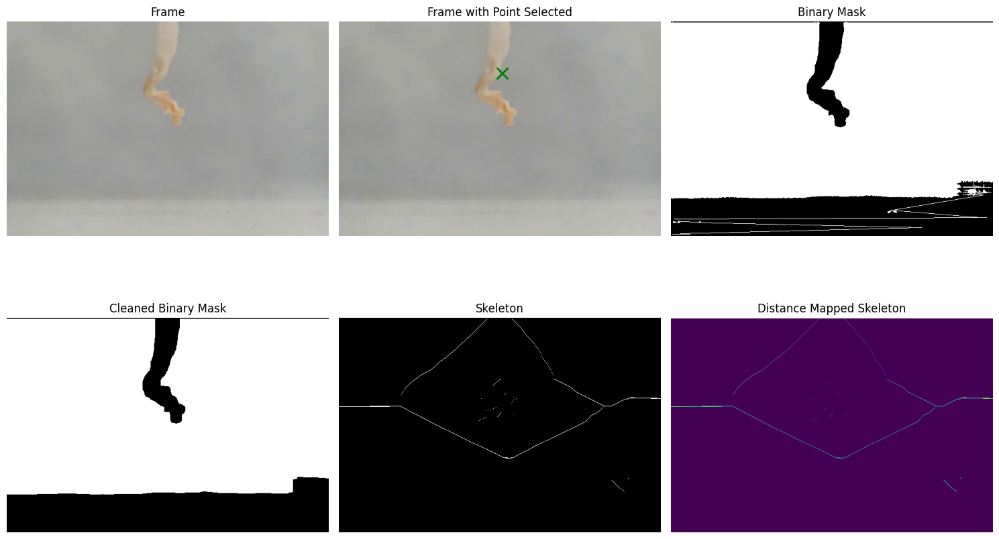

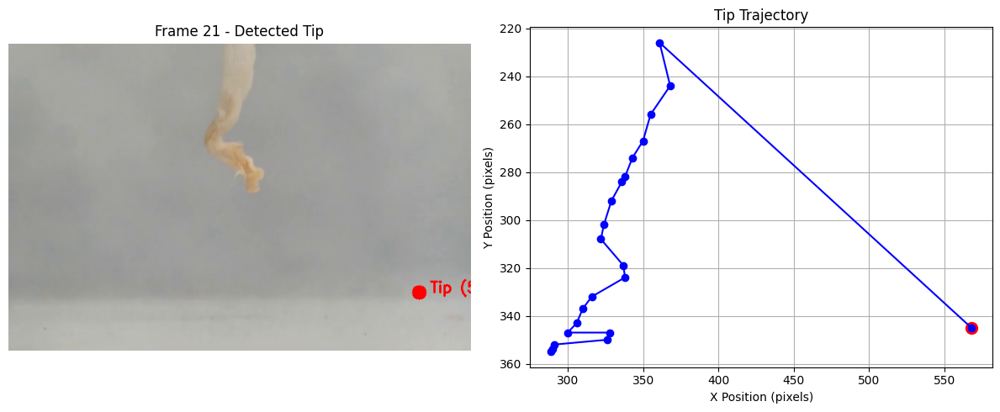


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_026.png: 1024x1024 1 0, 9314.7ms
Speed: 25.7ms preprocess, 9314.7ms inference, 2.0ms postprocess per image at shape (1, 3, 1024, 1024)


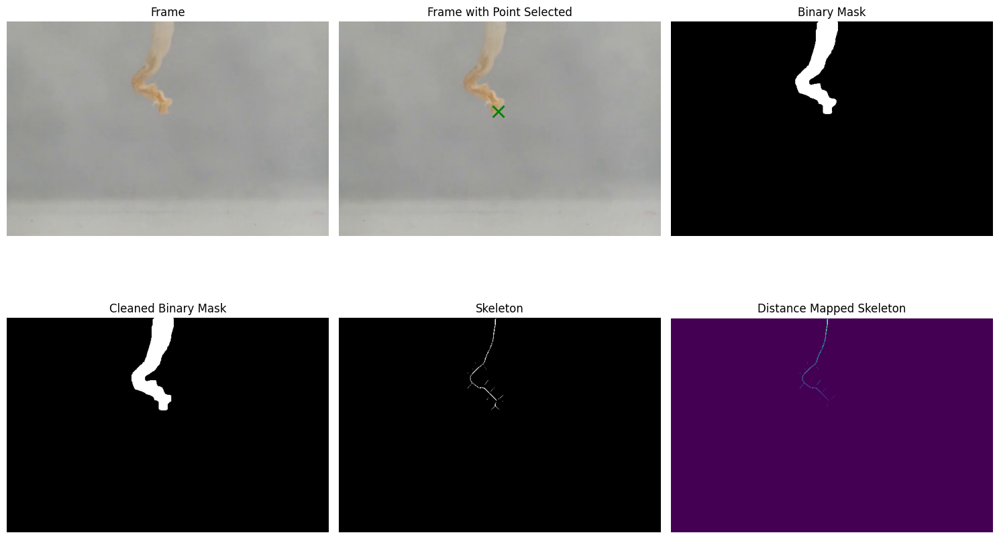

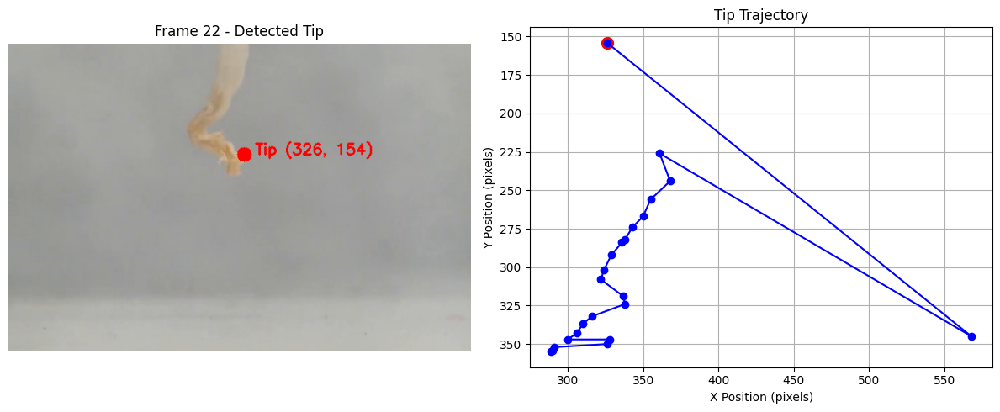


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_027.png: 1024x1024 1 0, 11789.1ms
Speed: 23.9ms preprocess, 11789.1ms inference, 1.9ms postprocess per image at shape (1, 3, 1024, 1024)


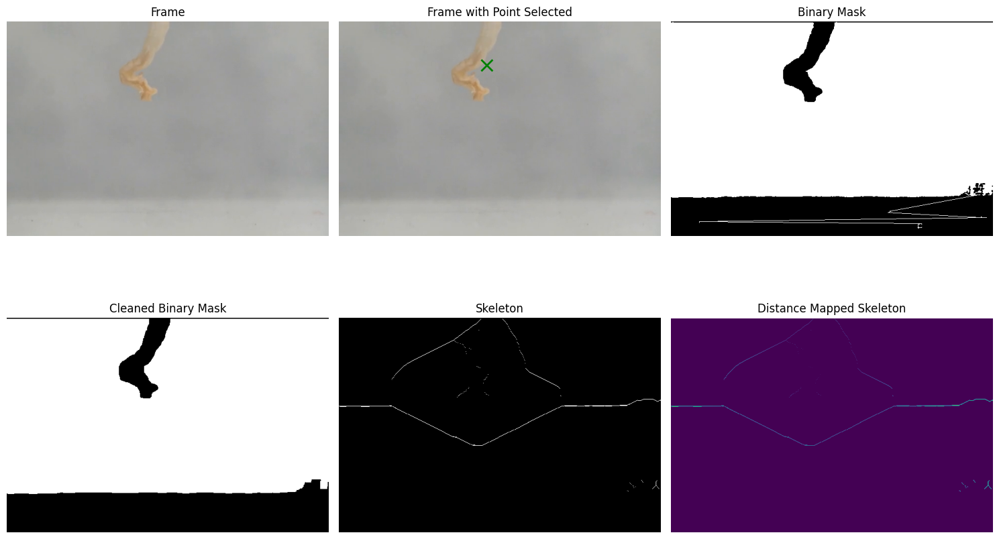

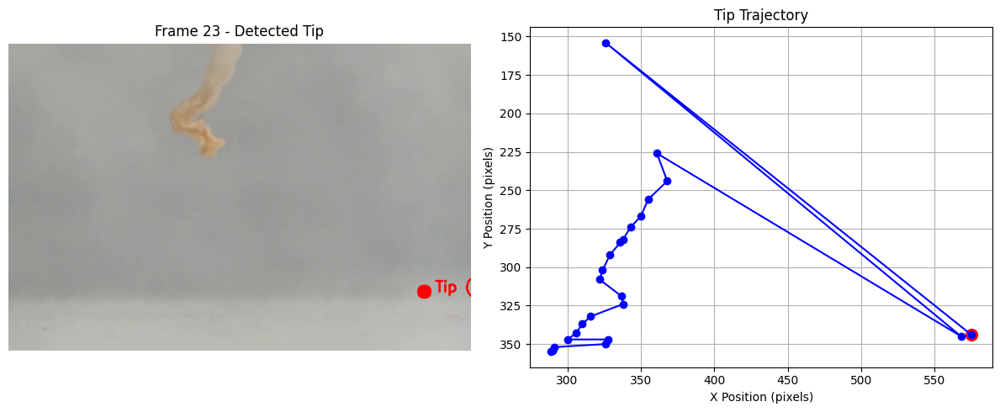


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_028.png: 1024x1024 1 0, 9420.9ms
Speed: 26.3ms preprocess, 9420.9ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


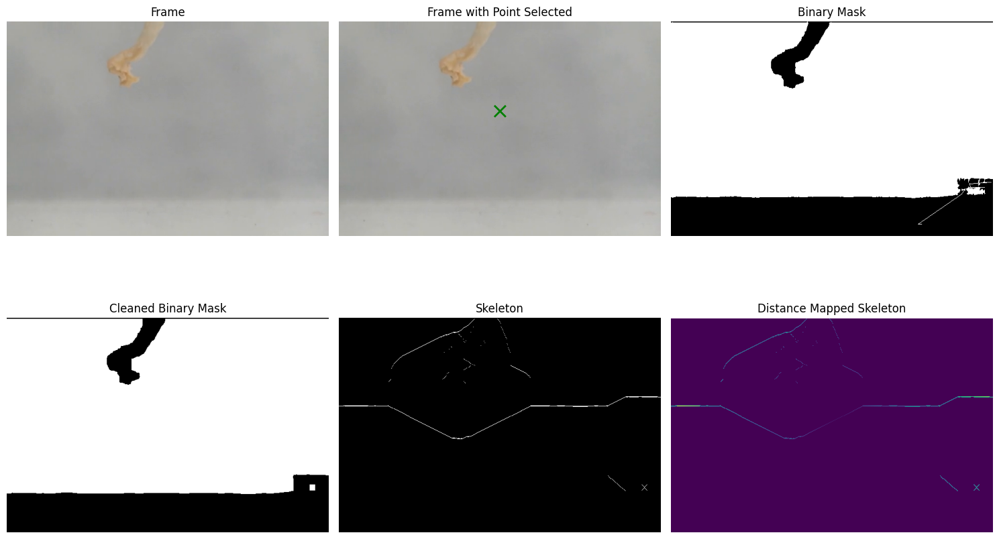

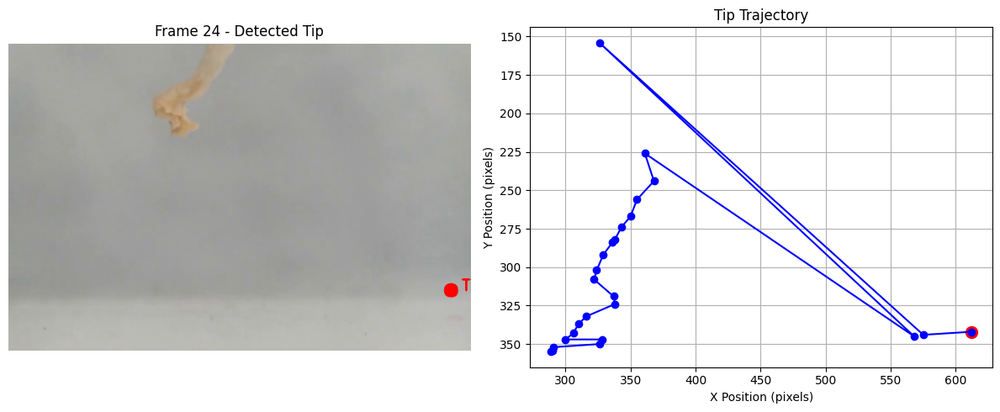


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_029.png: 1024x1024 1 0, 8364.0ms
Speed: 24.3ms preprocess, 8364.0ms inference, 2.2ms postprocess per image at shape (1, 3, 1024, 1024)


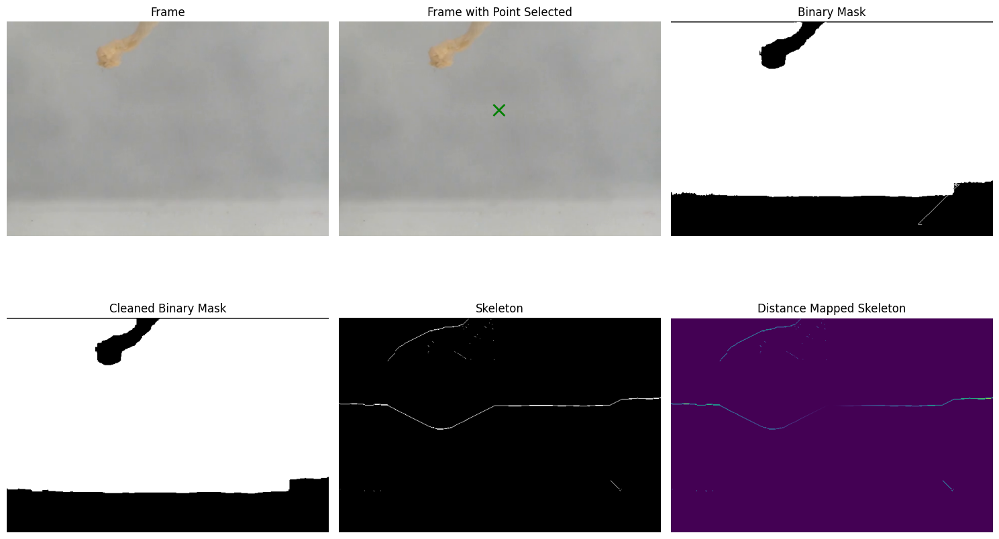

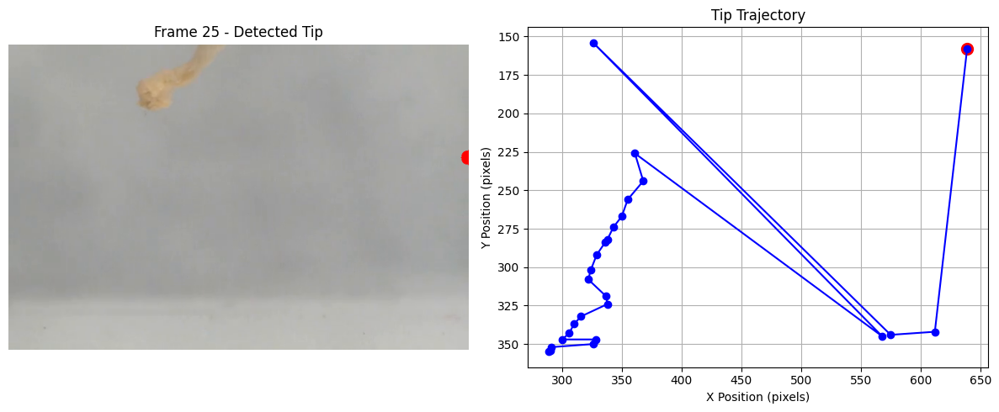


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_030.png: 1024x1024 1 0, 8410.5ms
Speed: 109.4ms preprocess, 8410.5ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


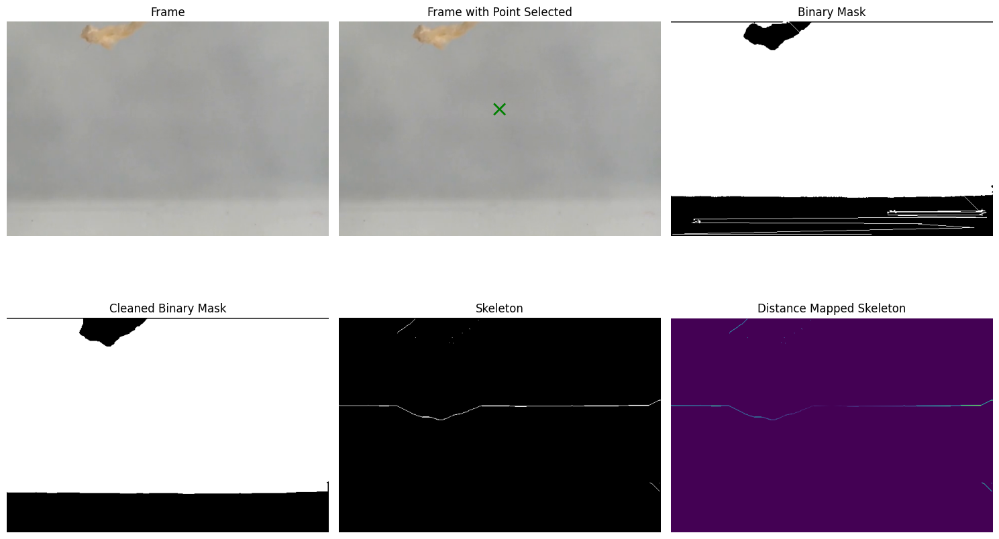

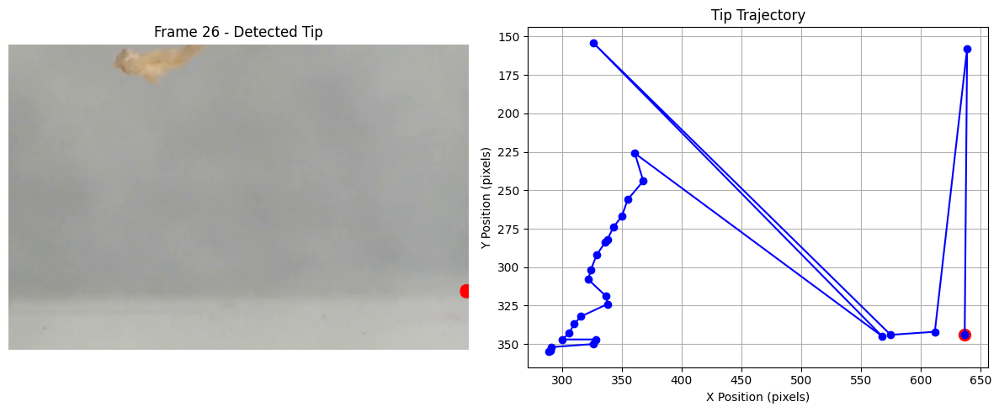


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/tracking_frames/frame_031.png: 1024x1024 1 0, 10152.2ms
Speed: 22.3ms preprocess, 10152.2ms inference, 2.6ms postprocess per image at shape (1, 3, 1024, 1024)


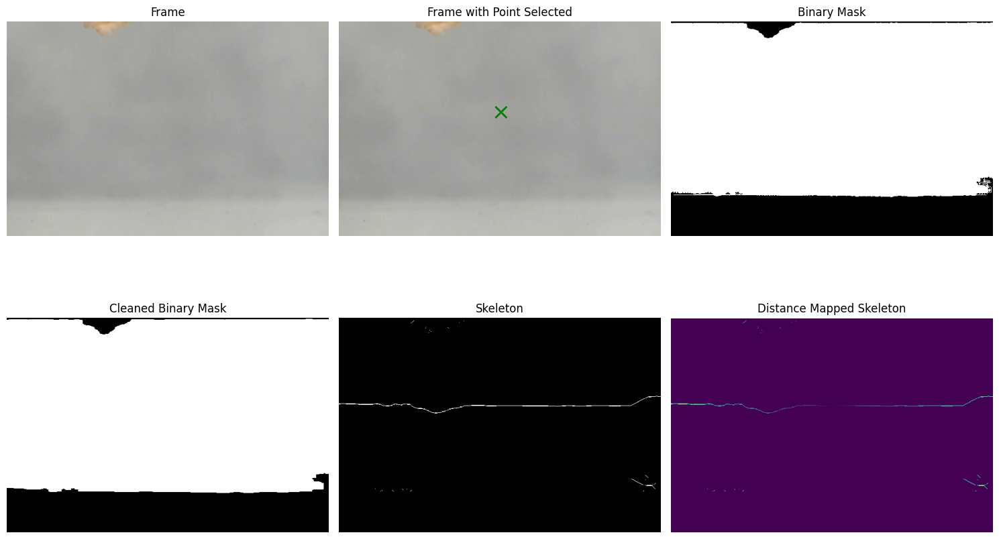

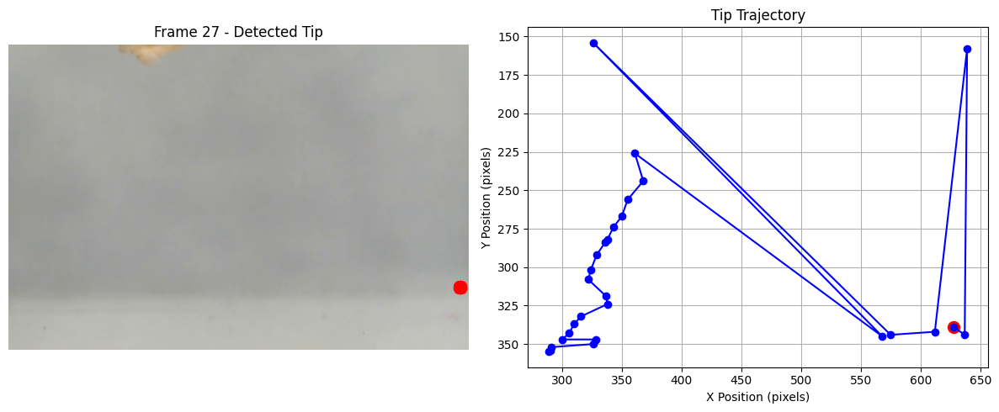

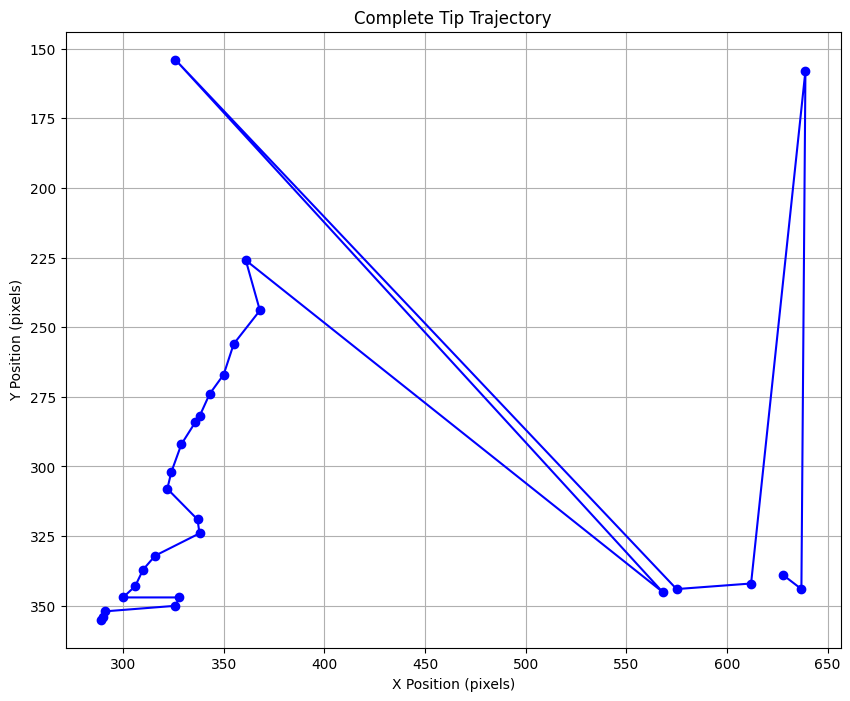

In [89]:
# Set paths
video_name = f"03.25.25_idx0_control_100x" # without the .mov
video_path = f"bimorph_videos/{video_name}.mov"
temp_folder = "tracking_frames/"
start_frame = 3
end_frame = None
frame_interval=0.6
point = (315, 50)

extract_frames(video_path, temp_folder, interval=frame_interval)

track_actuator_tip(
    frame_folder=temp_folder,
    start_frame=start_frame,
    end_frame=end_frame,
    output_file=f"tracked_trajectories/{video_name}_tracked.csv",
    anchor_point=point,
    edge_cushion =0
)


for filename in os.listdir(temp_folder):
    file_path = os.path.join(temp_folder, filename)
    if os.path.isdir(file_path):
        shutil.rmtree(file_path)
    else:
        os.remove(file_path)

In [ ]:
break

In [ ]:
# Set paths
video_name = f"03.21.25_idx0_100x" # without the .mov
video_path = f"bimorph_videos/{video_name}.mov"
temp_folder = "tracking_frames/"
start_frame = 0
end_frame = 40
frame_interval=0.6
point = (205, 50)

extract_frames(video_path, temp_folder, interval=frame_interval)

track_actuator_tip(
    frame_folder=temp_folder,
    start_frame=start_frame,
    end_frame=end_frame,
    output_file=f"tracked_trajectories/{video_name}_tracked.csv",
    anchor_point=point,
    edge_cushion =0
)


for filename in os.listdir(temp_folder):
    file_path = os.path.join(temp_folder, filename)
    if os.path.isdir(file_path):
        shutil.rmtree(file_path)
    else:
        os.remove(file_path)

In [ ]:
# Set paths
video_name = f"03.22.25_idx1_100x" # without the .mov
video_path = f"bimorph_videos/{video_name}.mov"
temp_folder = "tracking_frames/"
start_frame = 25
end_frame = 100
frame_interval=0.6
point = (220, 100)

extract_frames(video_path, temp_folder, interval=frame_interval)

track_actuator_tip(
    frame_folder=temp_folder,
    start_frame=start_frame,
    end_frame=end_frame,
    output_file=f"tracked_trajectories/{video_name}_tracked.csv",
    anchor_point=point,
    edge_cushion =0,
    tip_margin=20, # boosting the tip margin since there are a few points with similar distance in the skeleton 
)


for filename in os.listdir(temp_folder):
    file_path = os.path.join(temp_folder, filename)
    if os.path.isdir(file_path):
        shutil.rmtree(file_path)
    else:
        os.remove(file_path)

ffmpeg version 7.0.1 Copyright (c) 2000-2024 the FFmpeg developers
  built with Apple clang version 15.0.0 (clang-1500.3.9.4)
  configuration: --prefix=/usr/local/Cellar/ffmpeg/7.0.1 --enable-shared --enable-pthreads --enable-version3 --cc=clang --host-cflags= --host-ldflags='-Wl,-ld_classic' --enable-ffplay --enable-gnutls --enable-gpl --enable-libaom --enable-libaribb24 --enable-libbluray --enable-libdav1d --enable-libharfbuzz --enable-libjxl --enable-libmp3lame --enable-libopus --enable-librav1e --enable-librist --enable-librubberband --enable-libsnappy --enable-libsrt --enable-libssh --enable-libsvtav1 --enable-libtesseract --enable-libtheora --enable-libvidstab --enable-libvmaf --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lzma --enable-libfontconfig --enable-libfreetype --enable-frei0r --enable-libass --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-libspeex --ena

Analyzing frames 22 to 59
Total frames used: 38



[out#0/image2 @ 0x7ff75182dcc0] video:616KiB audio:0KiB subtitle:0KiB other streams:0KiB global headers:0KiB muxing overhead: unknown
frame=    7 fps=0.0 q=-0.0 Lsize=N/A time=00:00:42.00 bitrate=N/A speed= 235x    


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_023.png: 1024x1024 1 0, 8689.3ms
Speed: 27.5ms preprocess, 8689.3ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


<Figure size 1200x1000 with 0 Axes>

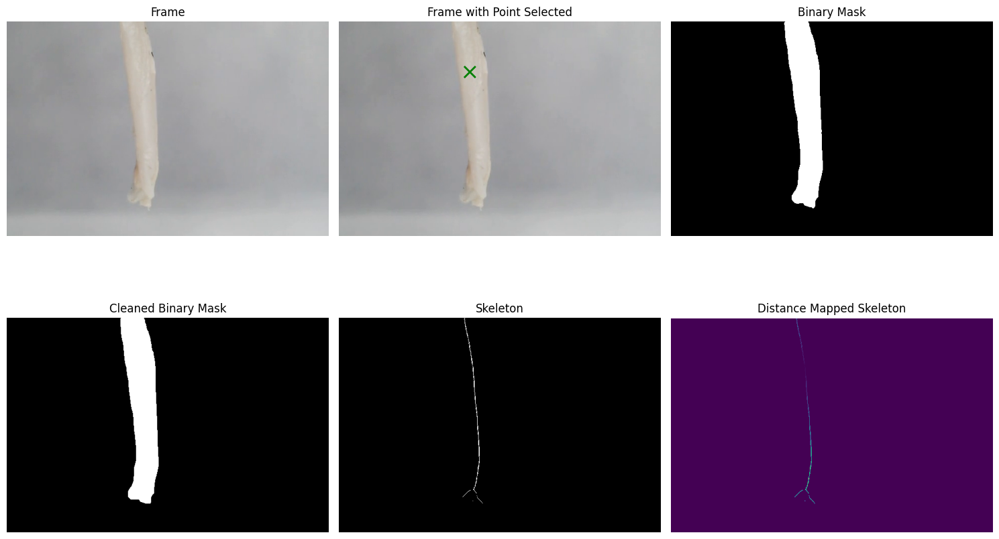

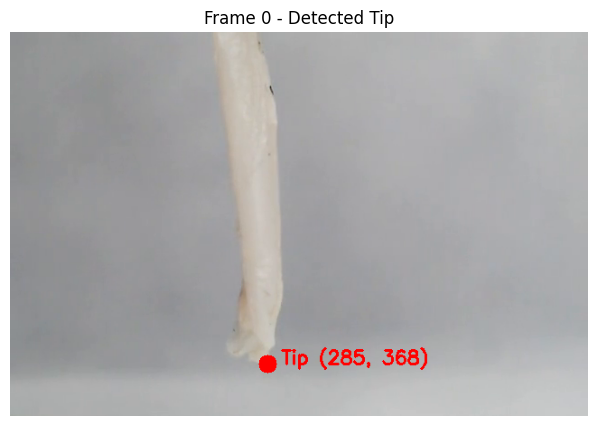


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_024.png: 1024x1024 1 0, 7055.7ms
Speed: 24.0ms preprocess, 7055.7ms inference, 1.4ms postprocess per image at shape (1, 3, 1024, 1024)


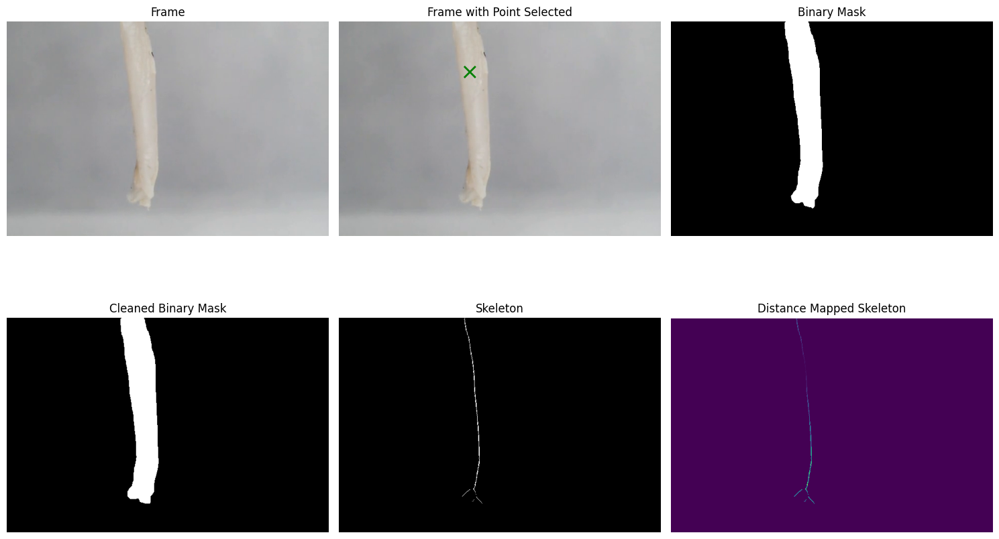

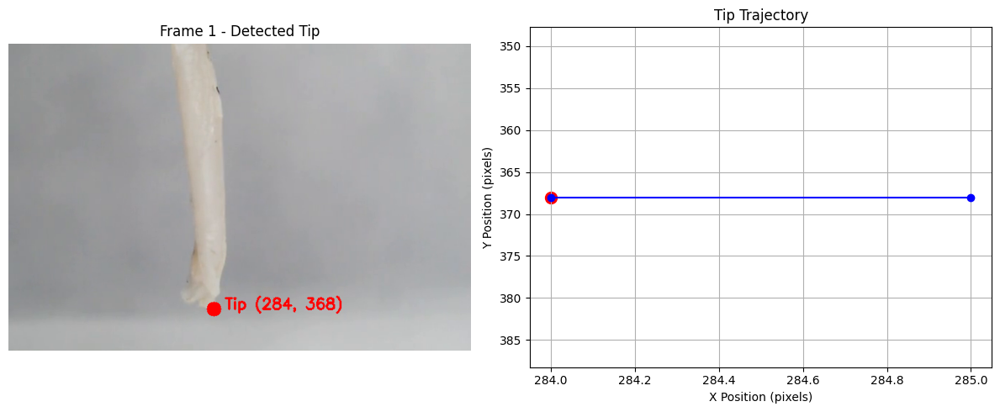


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_025.png: 1024x1024 1 0, 7127.1ms
Speed: 23.1ms preprocess, 7127.1ms inference, 1.3ms postprocess per image at shape (1, 3, 1024, 1024)


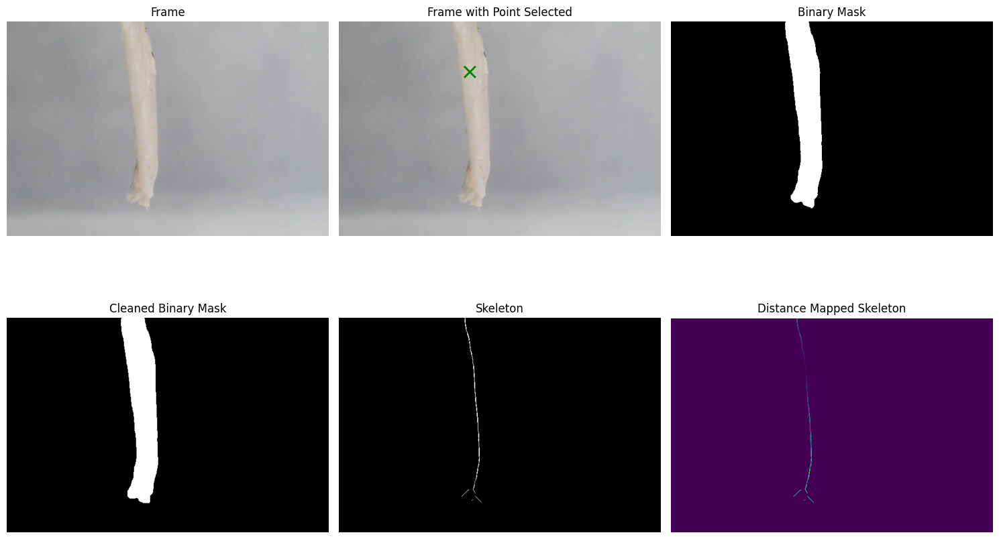

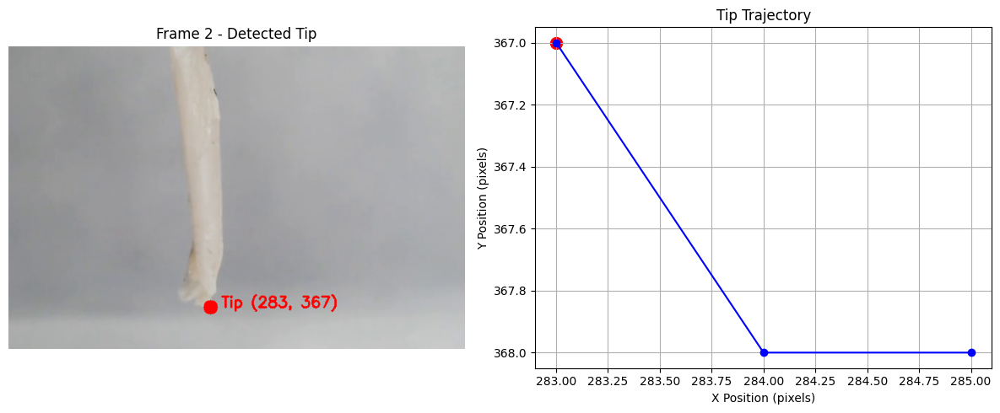


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_026.png: 1024x1024 1 0, 7234.9ms
Speed: 20.4ms preprocess, 7234.9ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)


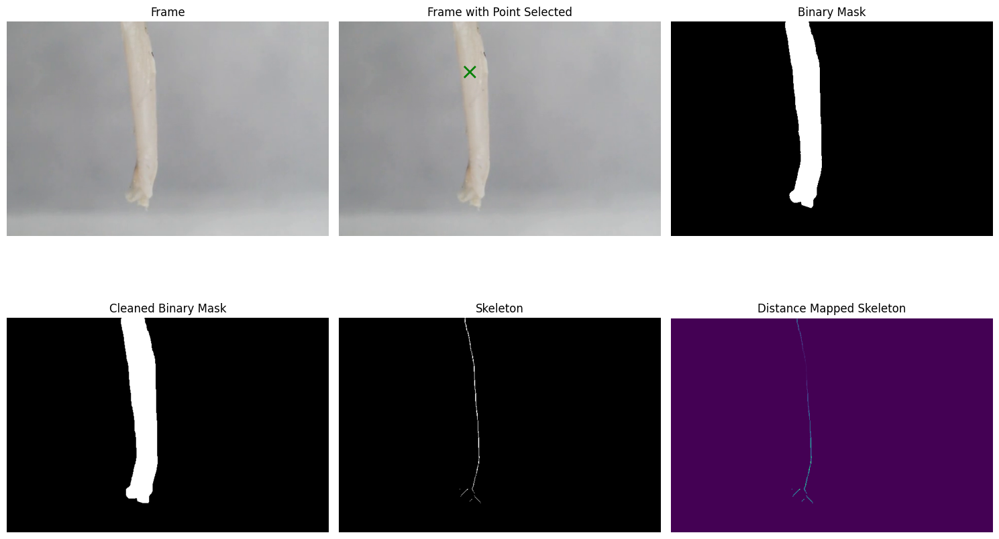

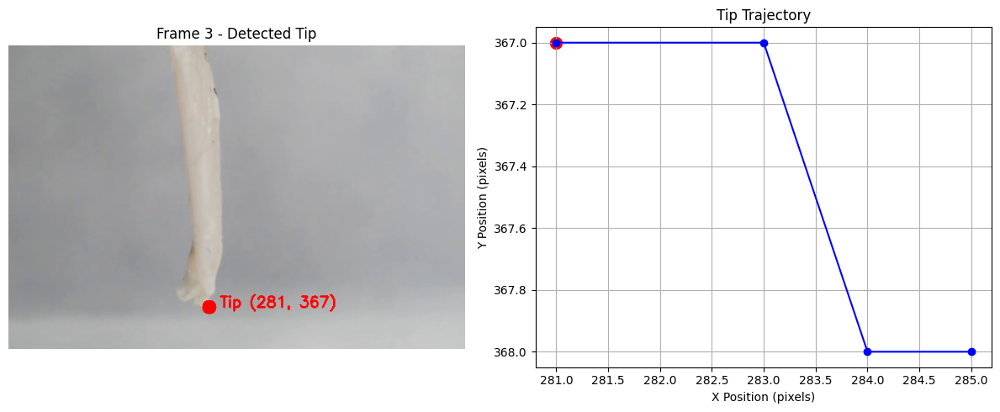


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_027.png: 1024x1024 1 0, 7271.8ms
Speed: 69.1ms preprocess, 7271.8ms inference, 2.2ms postprocess per image at shape (1, 3, 1024, 1024)


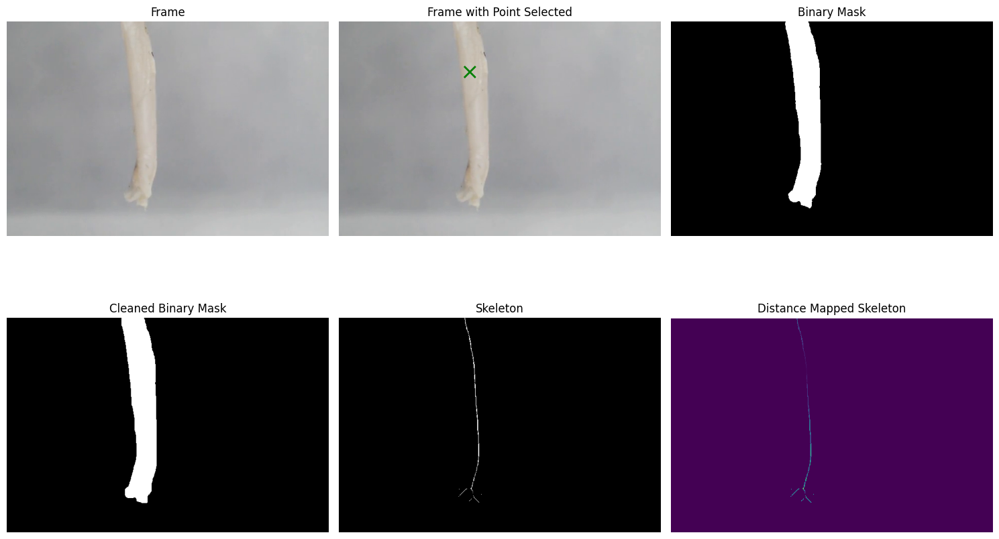

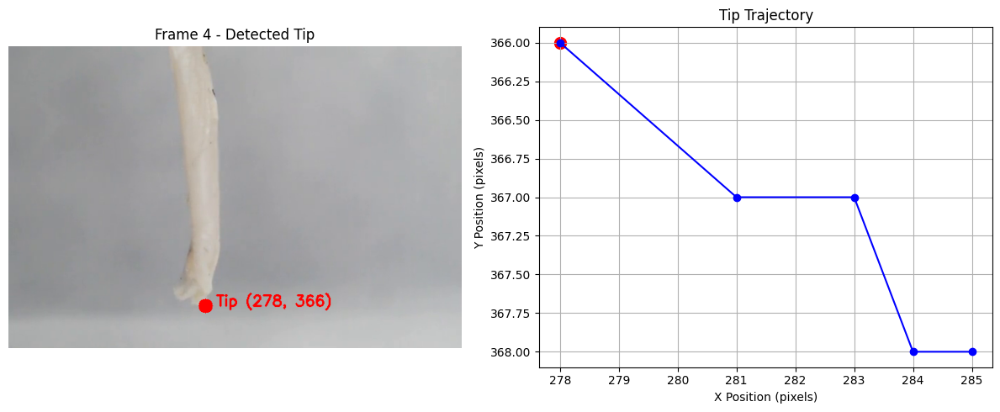


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_028.png: 1024x1024 1 0, 8385.6ms
Speed: 19.7ms preprocess, 8385.6ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


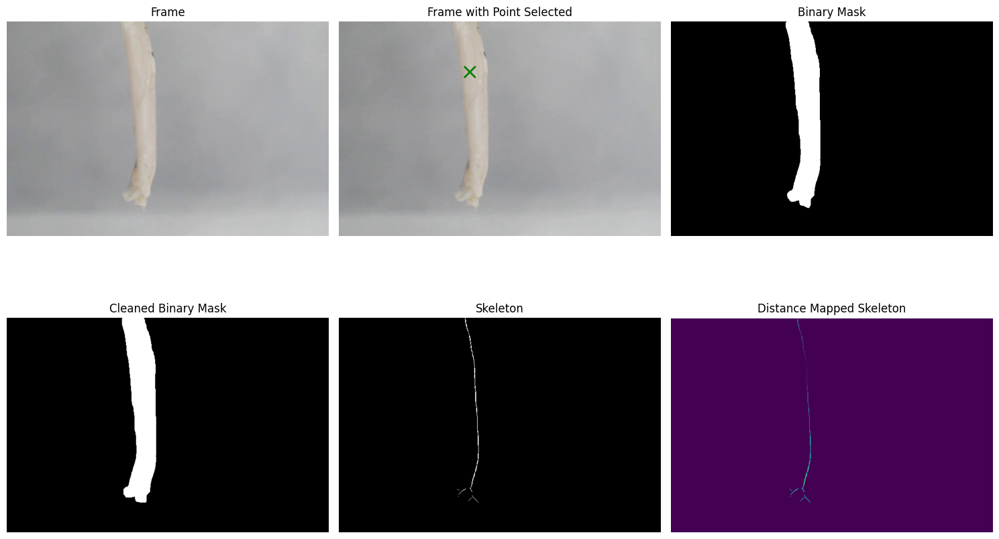

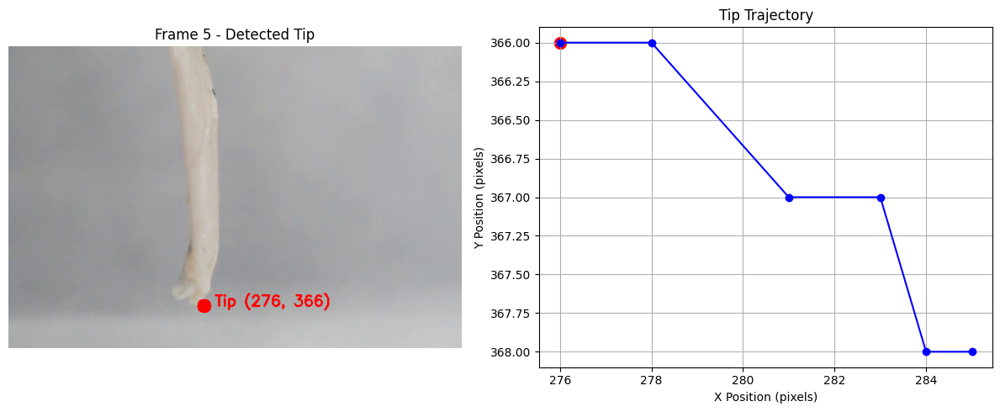


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_029.png: 1024x1024 1 0, 7513.8ms
Speed: 22.1ms preprocess, 7513.8ms inference, 1.4ms postprocess per image at shape (1, 3, 1024, 1024)


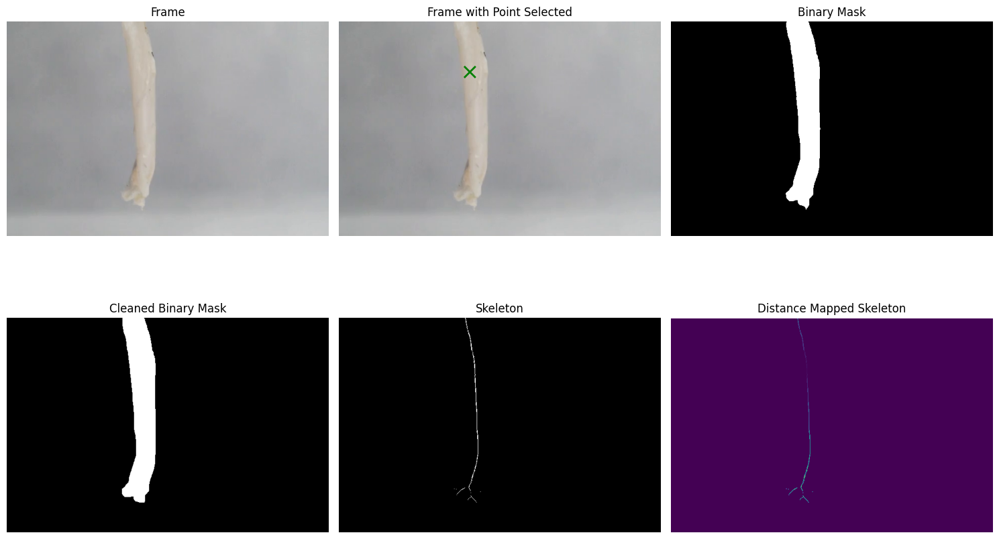

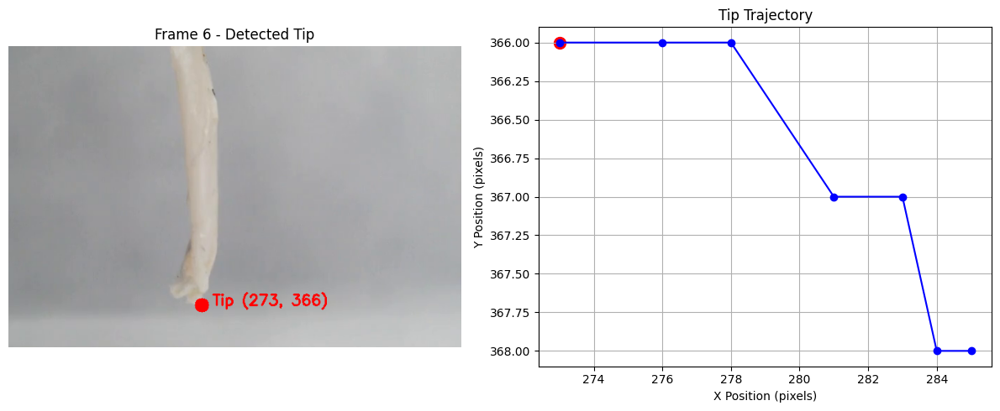


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_030.png: 1024x1024 1 0, 9678.7ms
Speed: 21.4ms preprocess, 9678.7ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


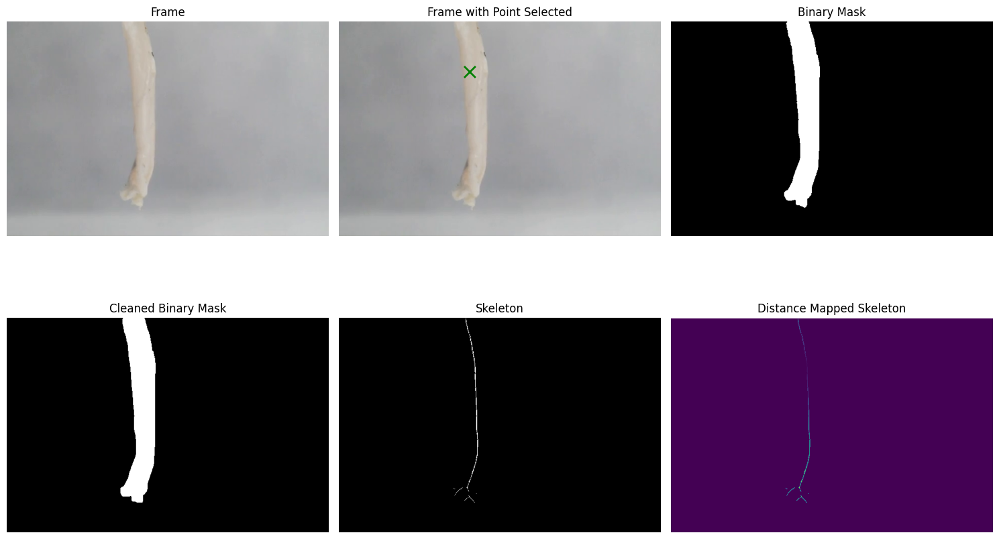

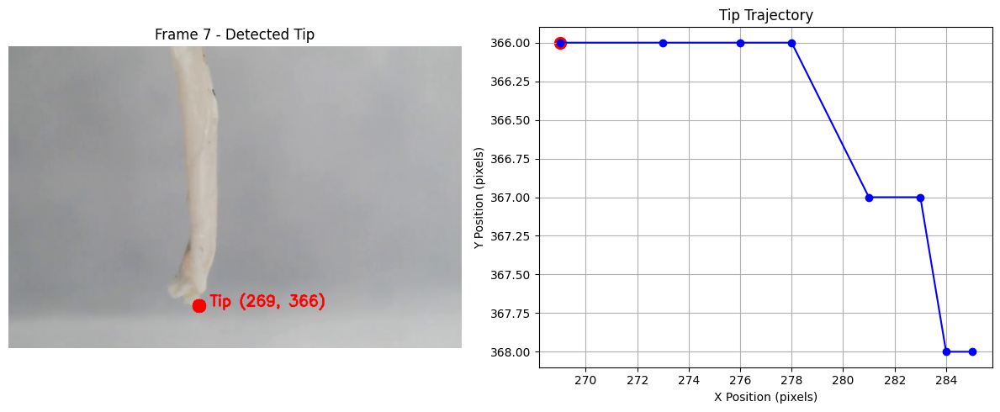


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_031.png: 1024x1024 1 0, 11571.3ms
Speed: 21.0ms preprocess, 11571.3ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


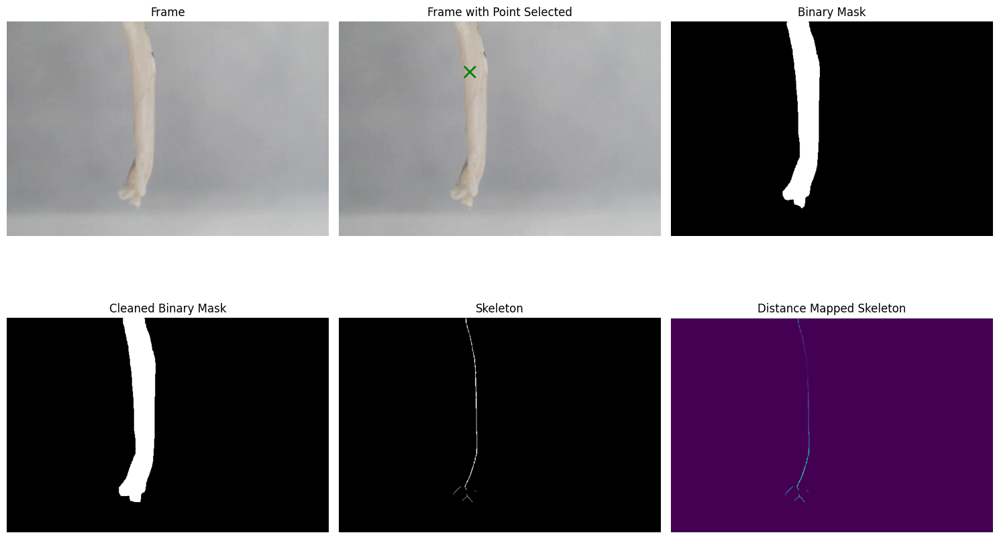

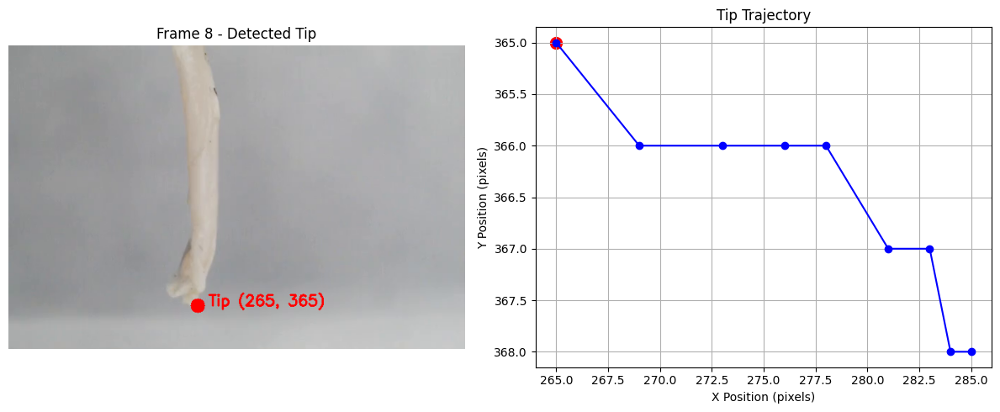


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_032.png: 1024x1024 1 0, 9024.7ms
Speed: 24.6ms preprocess, 9024.7ms inference, 1.9ms postprocess per image at shape (1, 3, 1024, 1024)


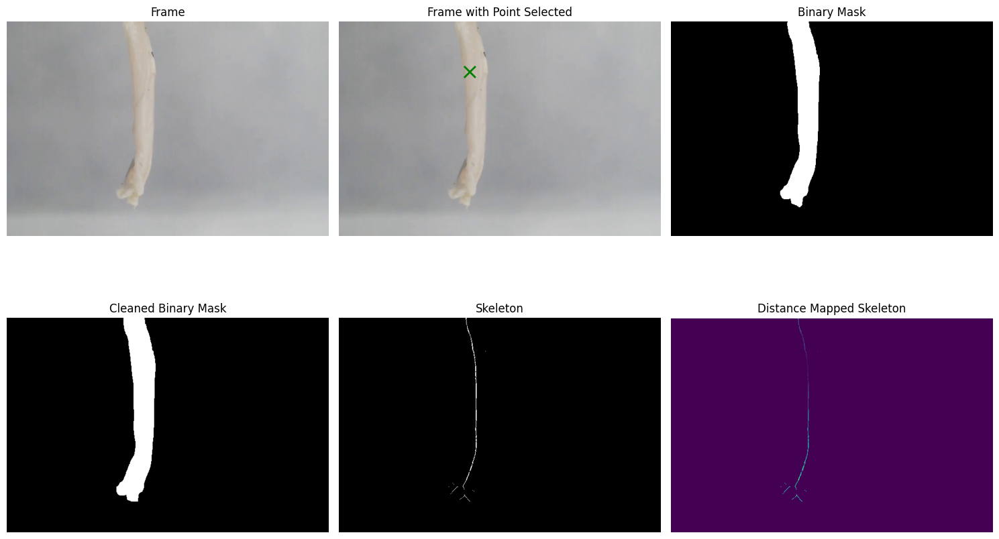

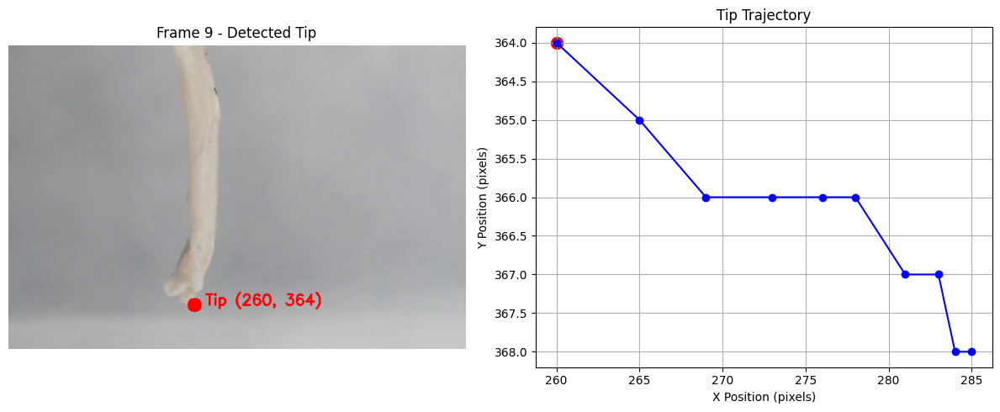


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_033.png: 1024x1024 1 0, 8634.0ms
Speed: 22.6ms preprocess, 8634.0ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


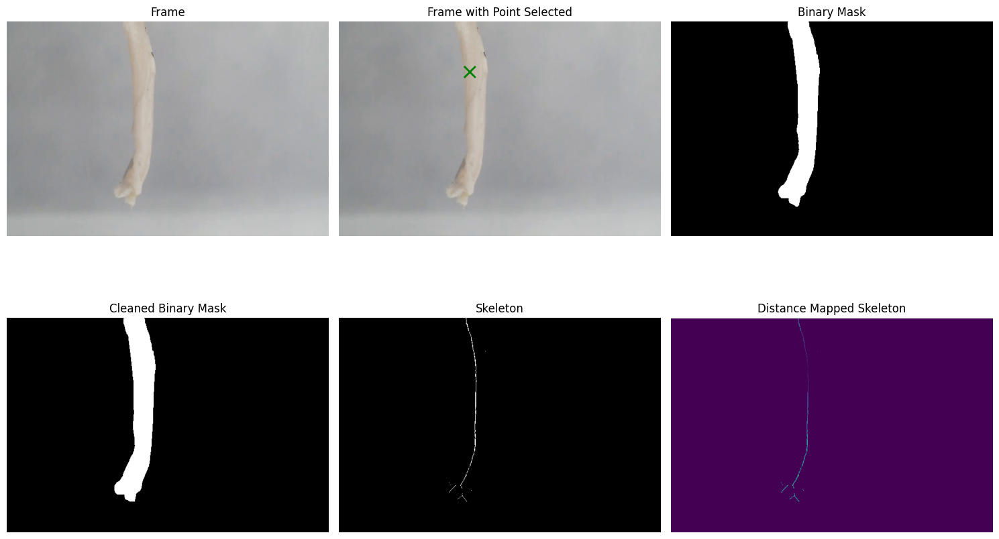

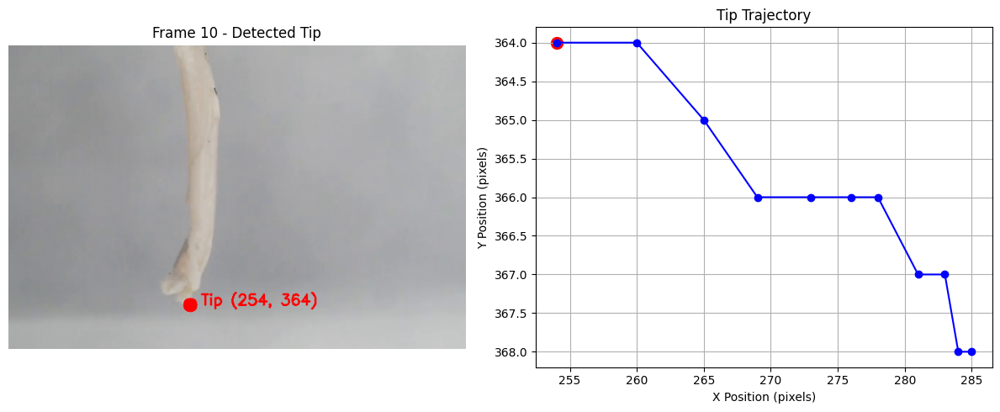


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_034.png: 1024x1024 1 0, 7736.7ms
Speed: 22.6ms preprocess, 7736.7ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


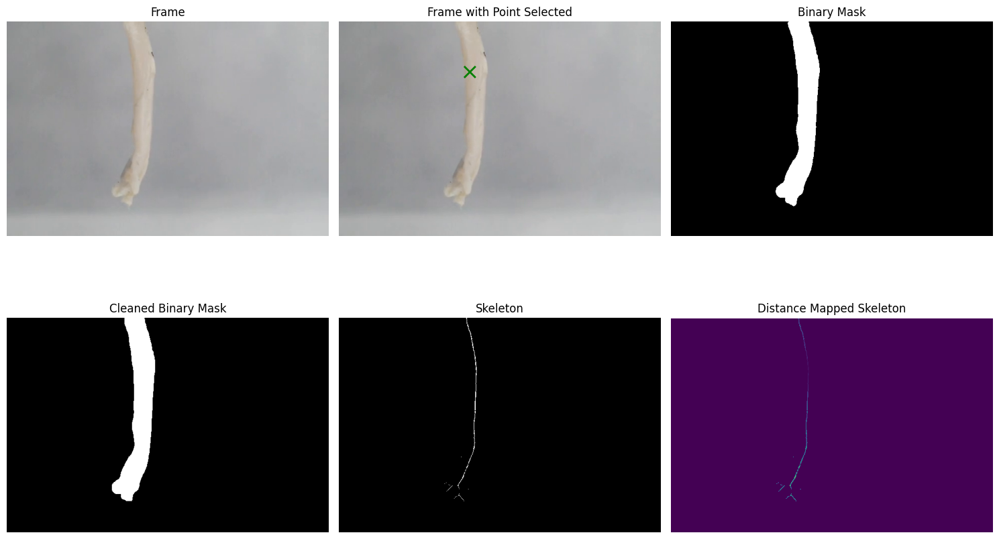

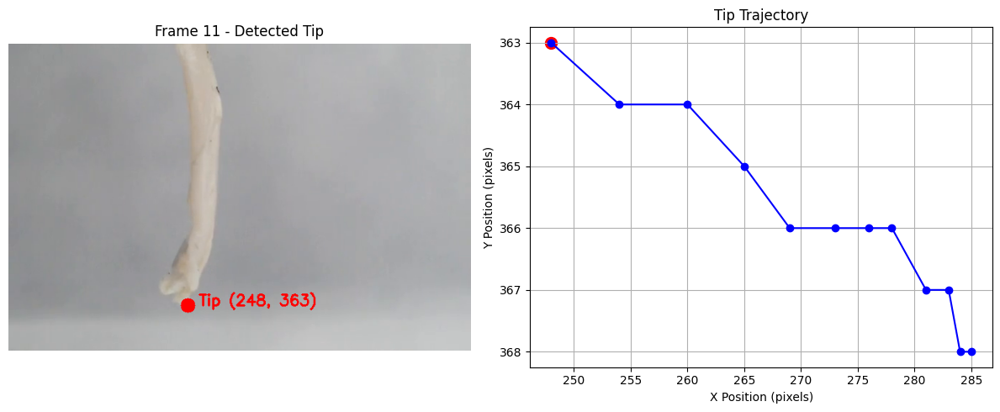


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_035.png: 1024x1024 1 0, 7928.4ms
Speed: 20.3ms preprocess, 7928.4ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


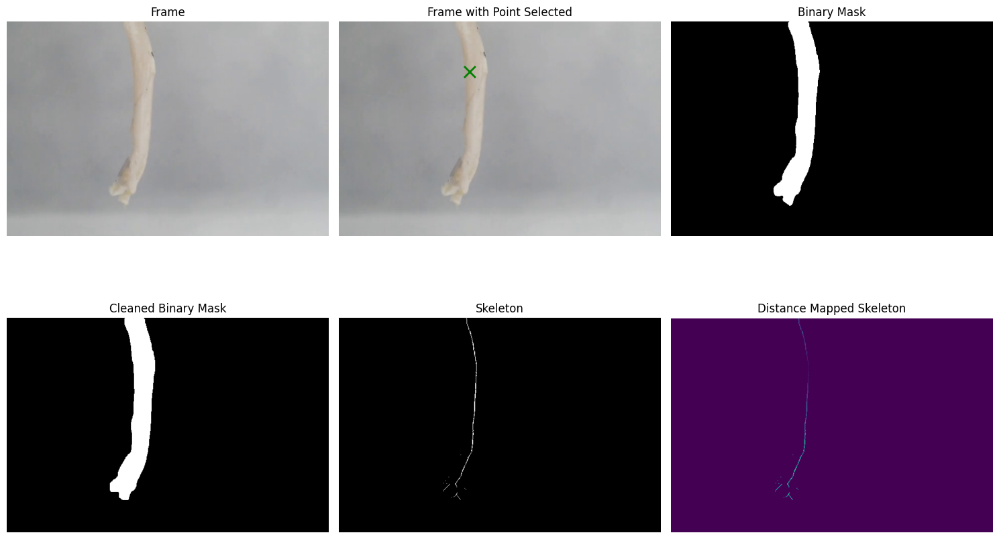

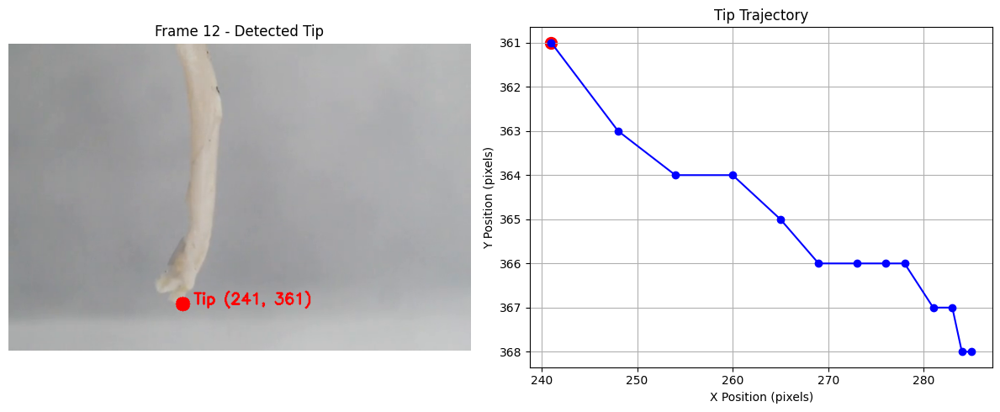


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_036.png: 1024x1024 1 0, 7898.8ms
Speed: 22.9ms preprocess, 7898.8ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)


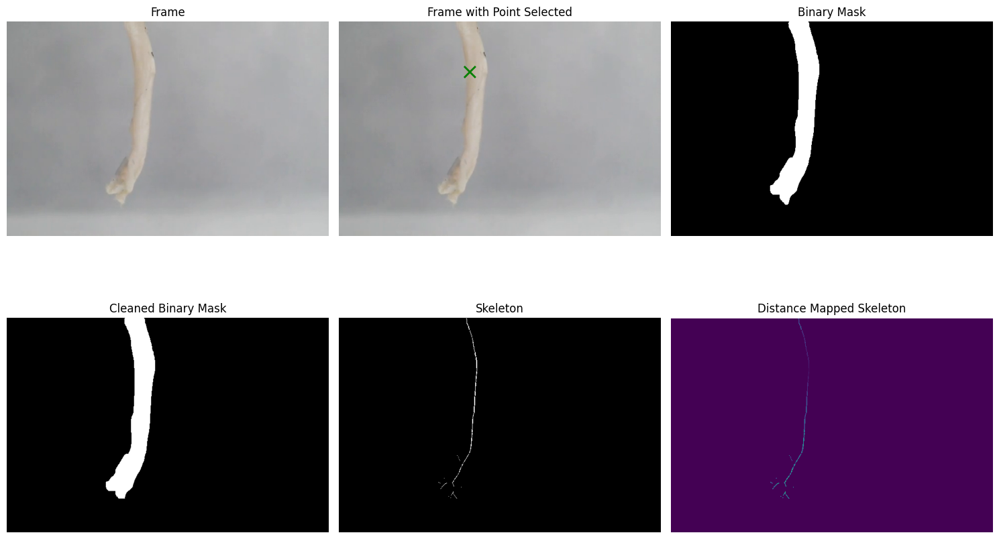

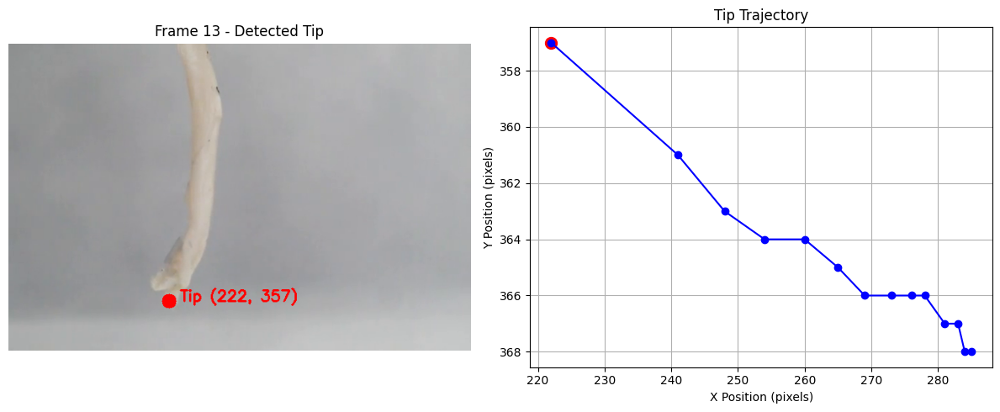


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_037.png: 1024x1024 1 0, 7902.7ms
Speed: 22.4ms preprocess, 7902.7ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


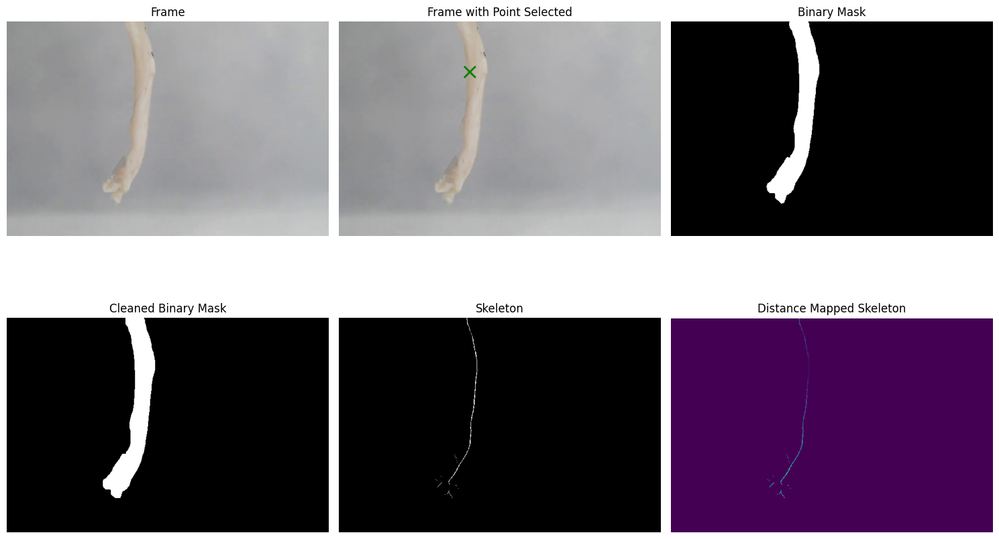

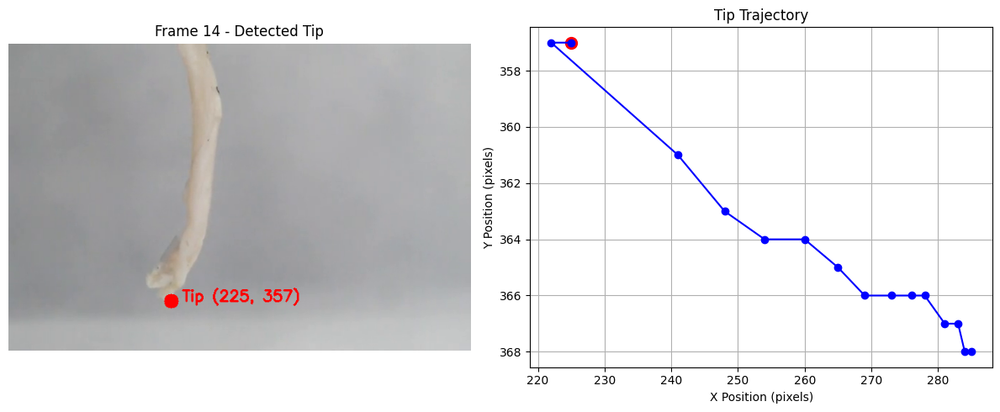


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_038.png: 1024x1024 1 0, 7731.1ms
Speed: 23.4ms preprocess, 7731.1ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)


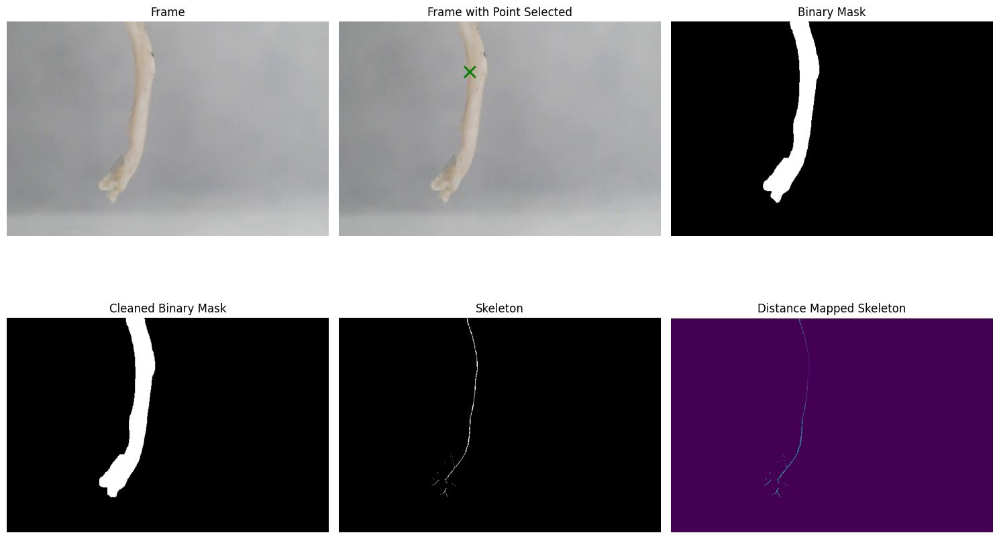

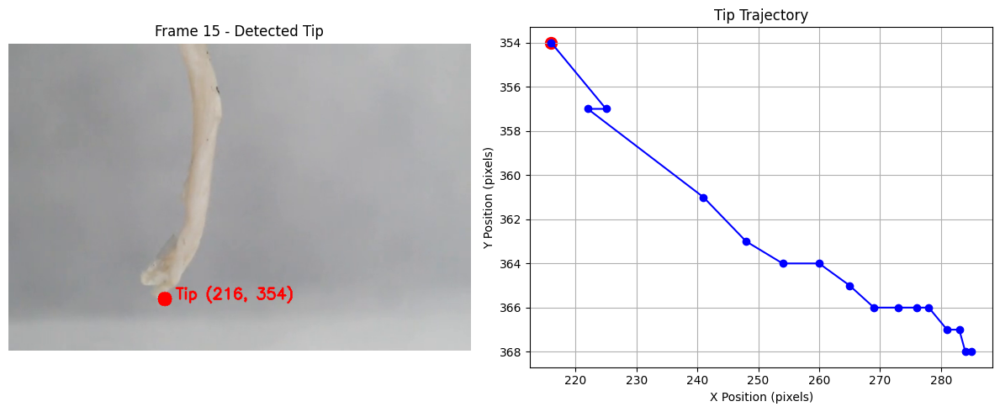


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_039.png: 1024x1024 1 0, 7786.0ms
Speed: 25.5ms preprocess, 7786.0ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


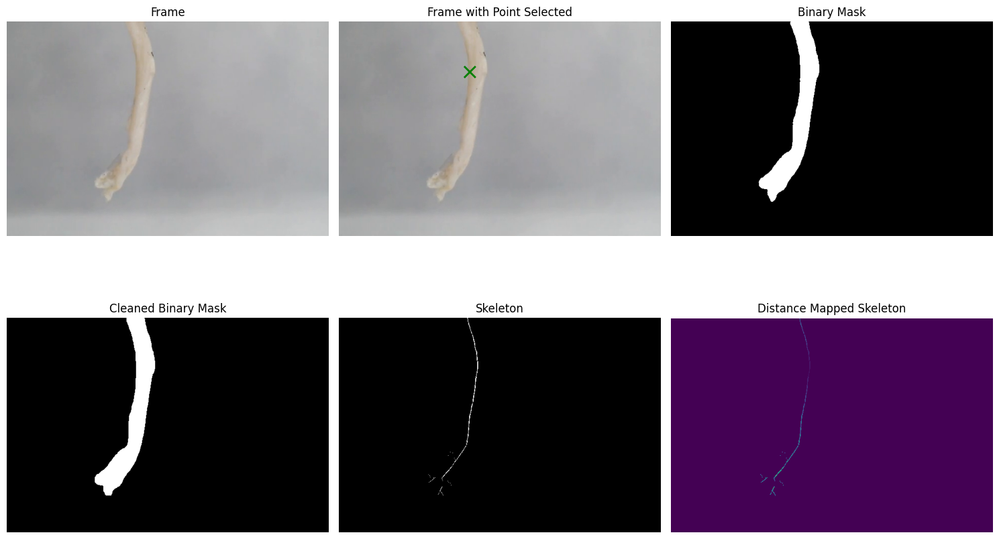

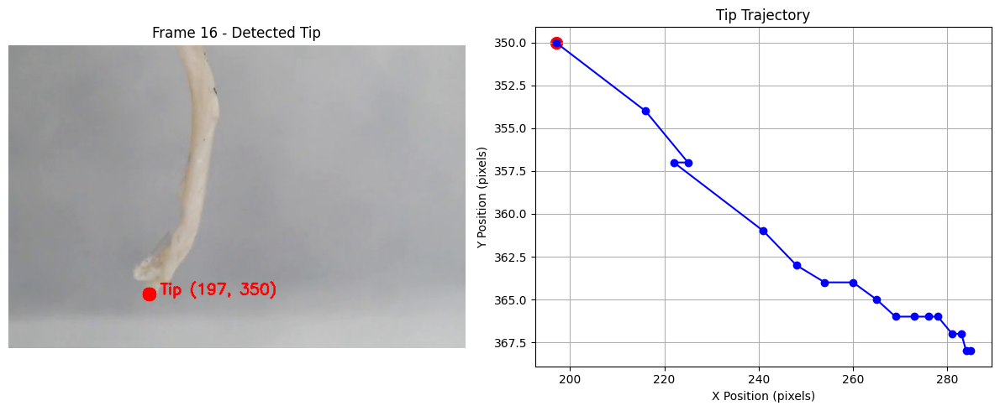


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_040.png: 1024x1024 1 0, 8044.8ms
Speed: 24.5ms preprocess, 8044.8ms inference, 2.0ms postprocess per image at shape (1, 3, 1024, 1024)


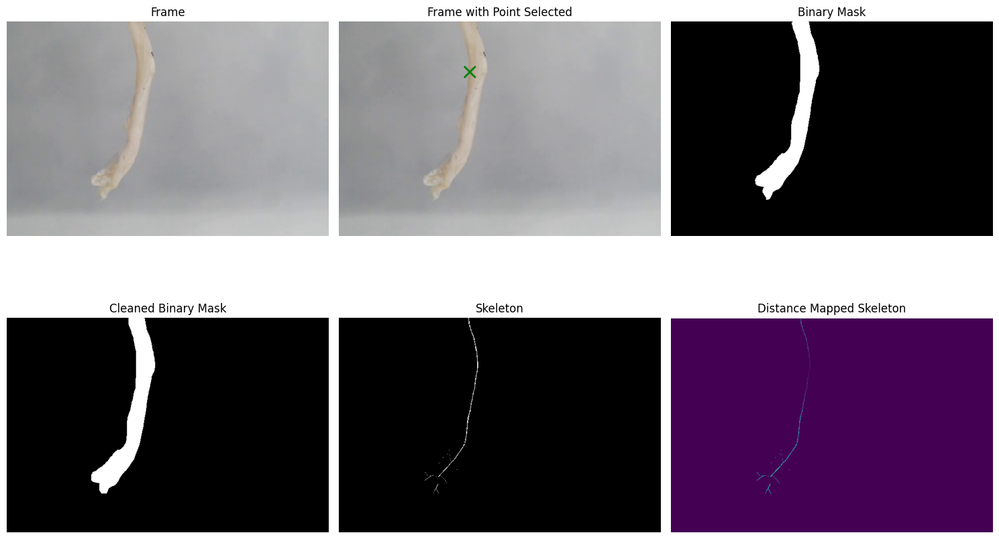

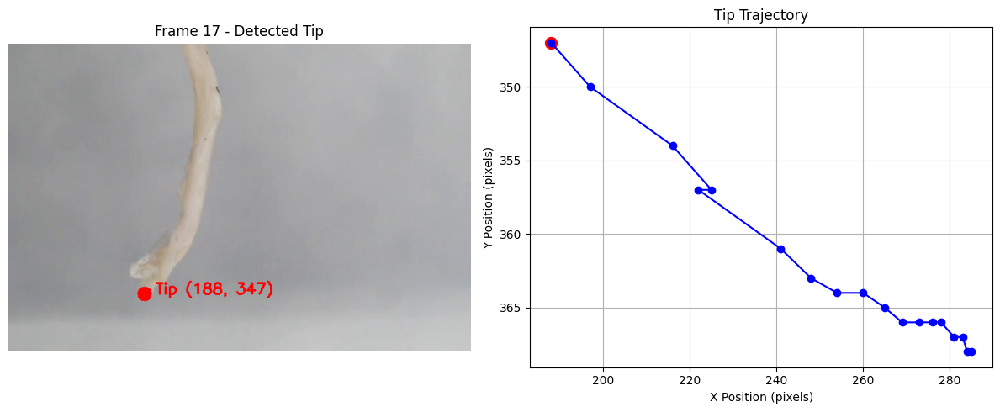


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_041.png: 1024x1024 1 0, 8159.6ms
Speed: 24.9ms preprocess, 8159.6ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


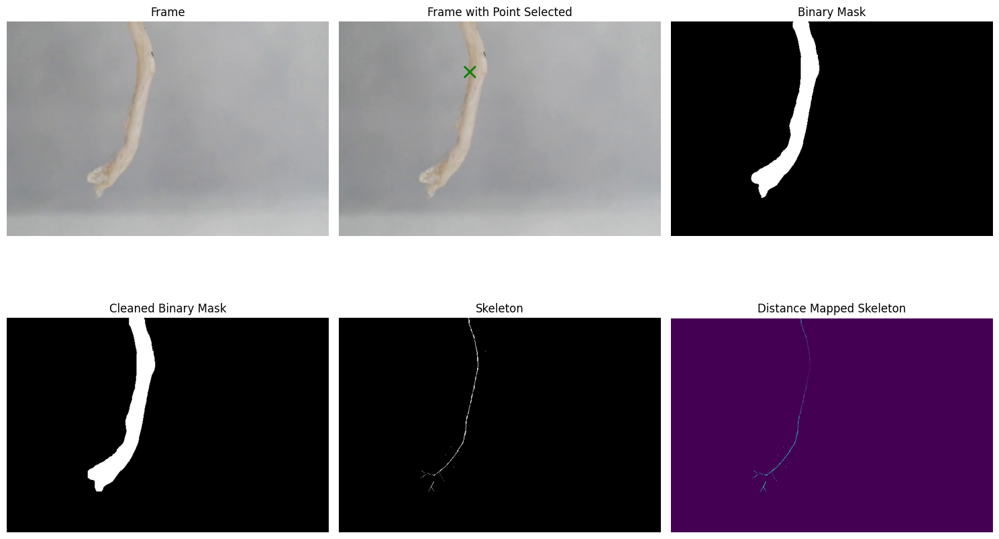

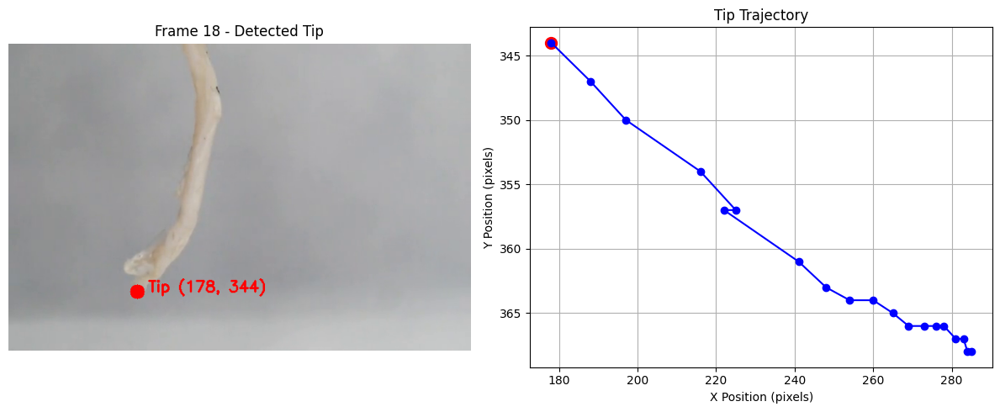


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_042.png: 1024x1024 1 0, 7987.2ms
Speed: 22.8ms preprocess, 7987.2ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


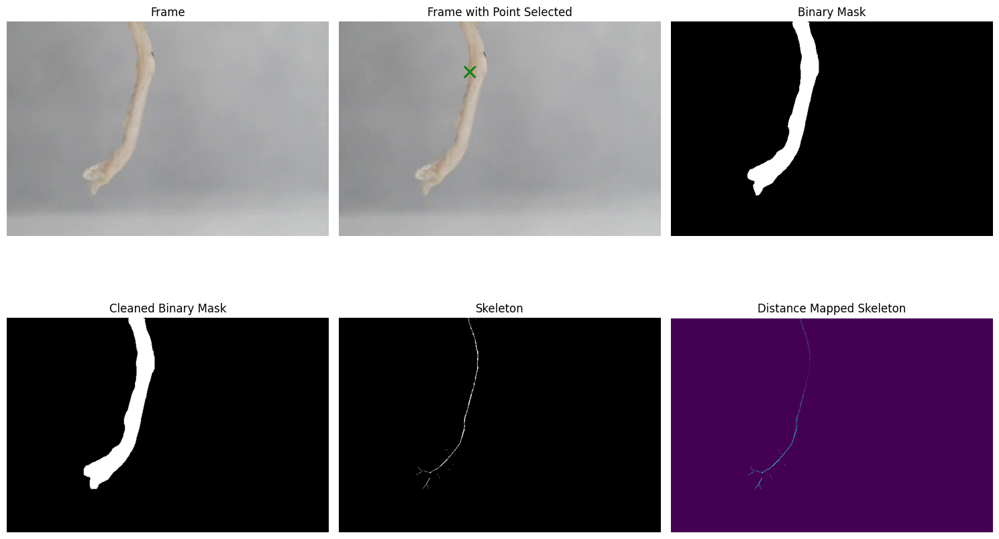

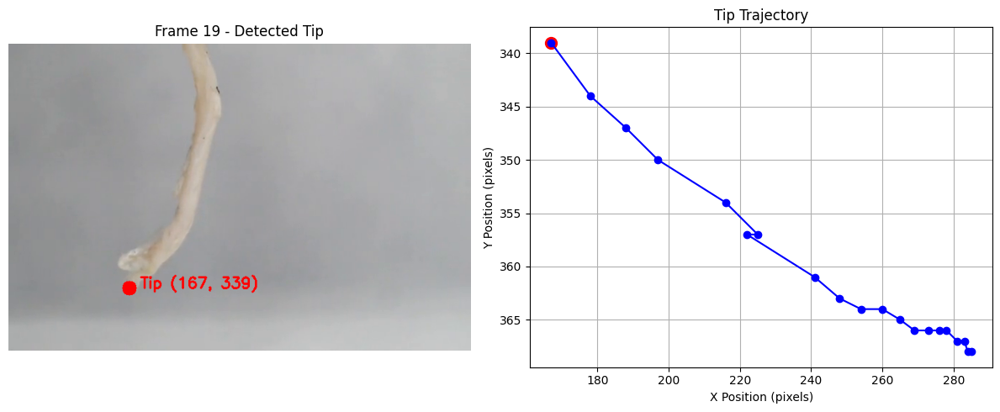


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_043.png: 1024x1024 1 0, 7907.7ms
Speed: 88.3ms preprocess, 7907.7ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


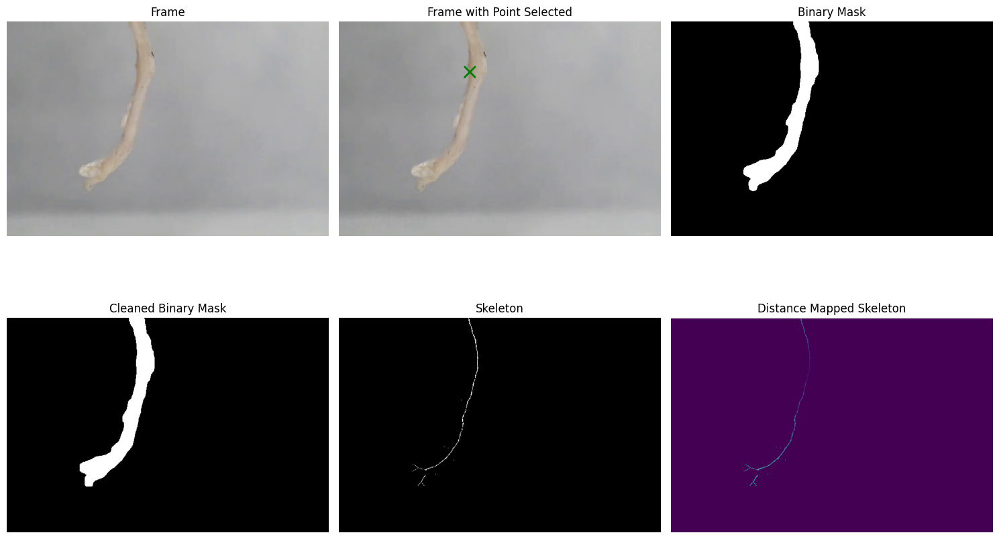

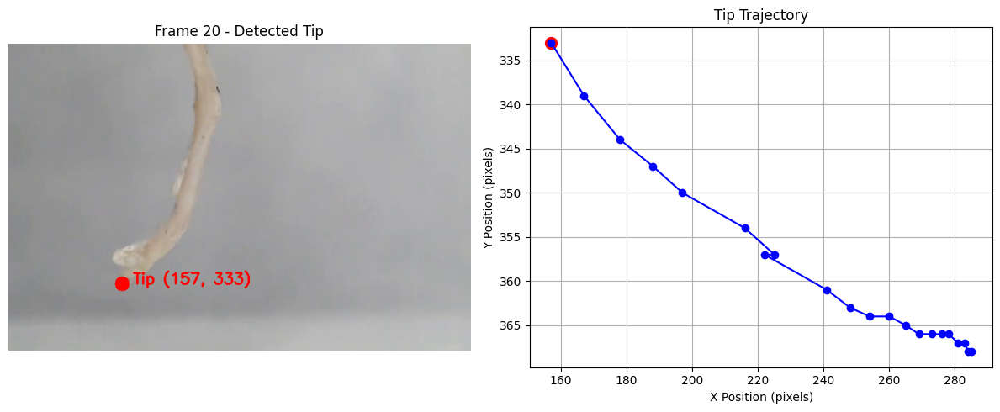


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_044.png: 1024x1024 1 0, 9018.4ms
Speed: 24.8ms preprocess, 9018.4ms inference, 2.1ms postprocess per image at shape (1, 3, 1024, 1024)


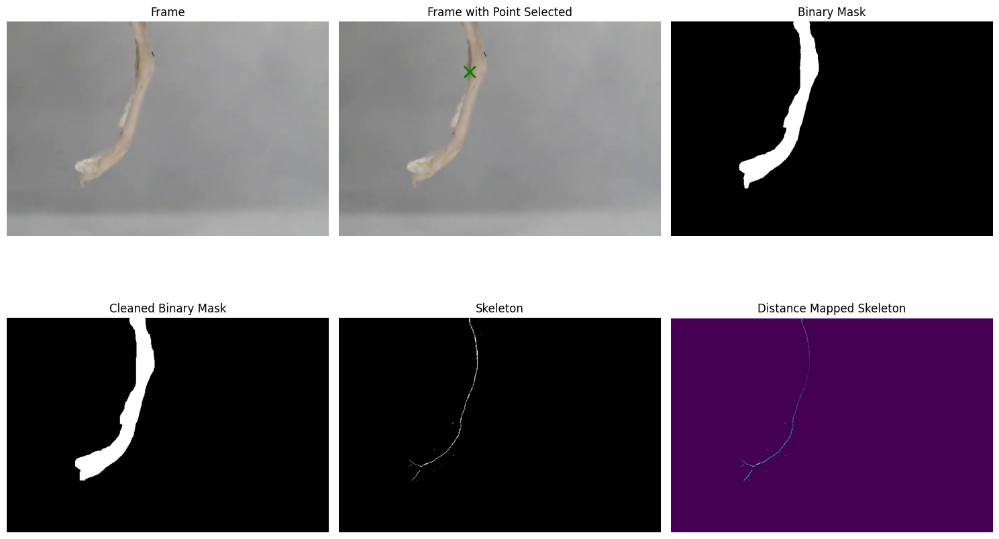

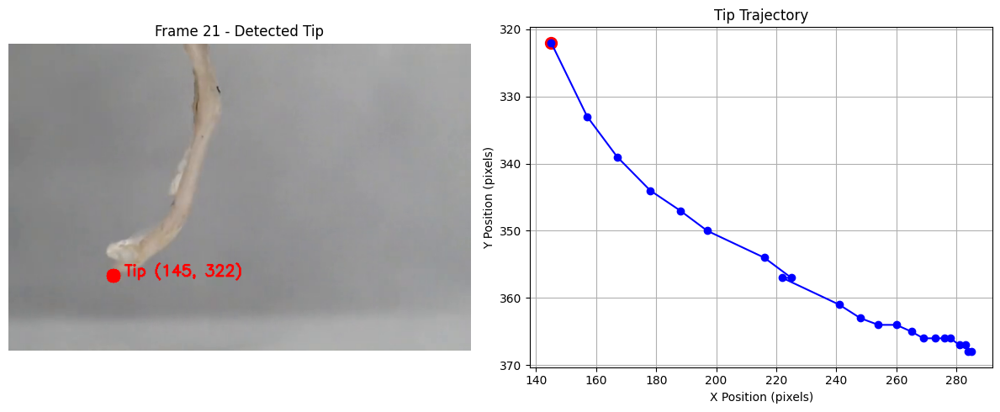


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_045.png: 1024x1024 1 0, 8428.5ms
Speed: 22.8ms preprocess, 8428.5ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


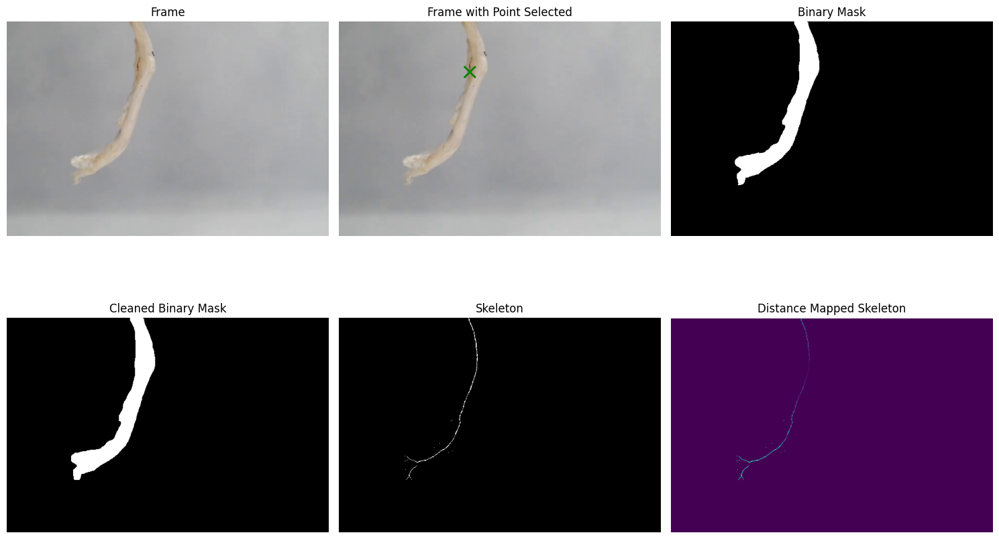

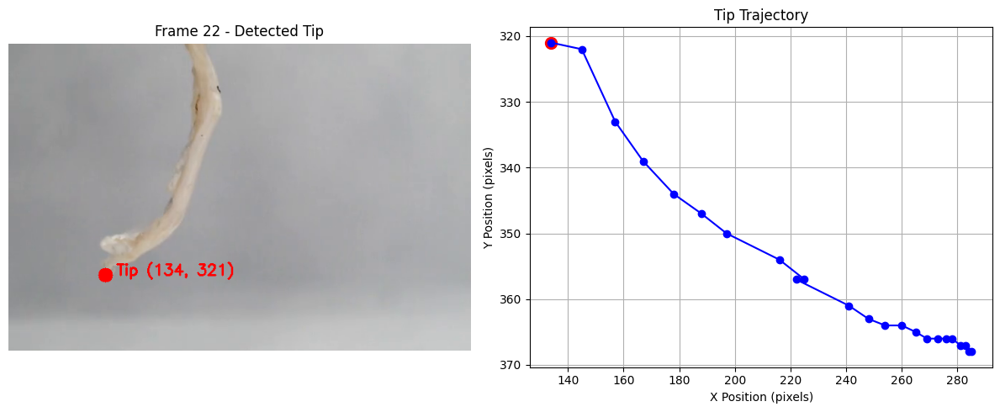


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_046.png: 1024x1024 1 0, 8574.1ms
Speed: 22.3ms preprocess, 8574.1ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


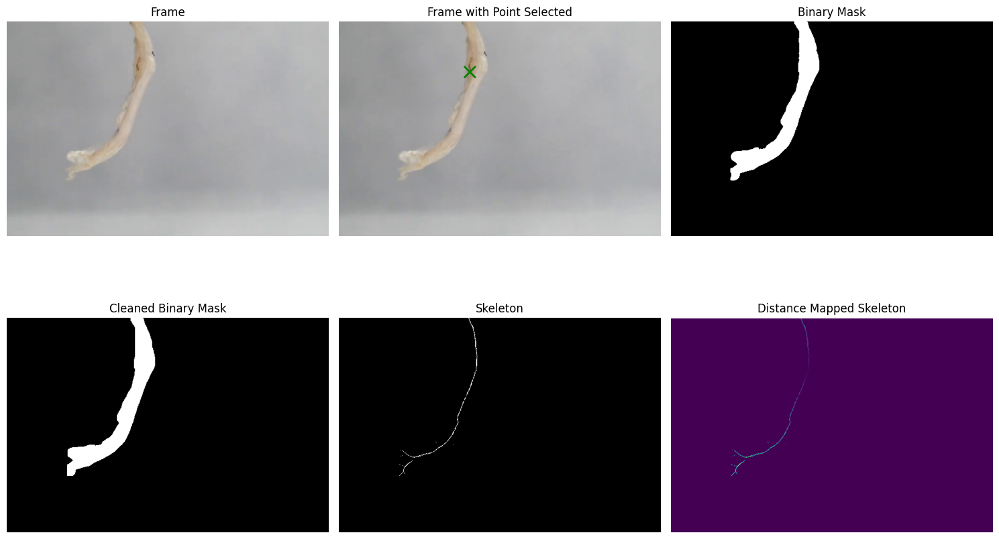

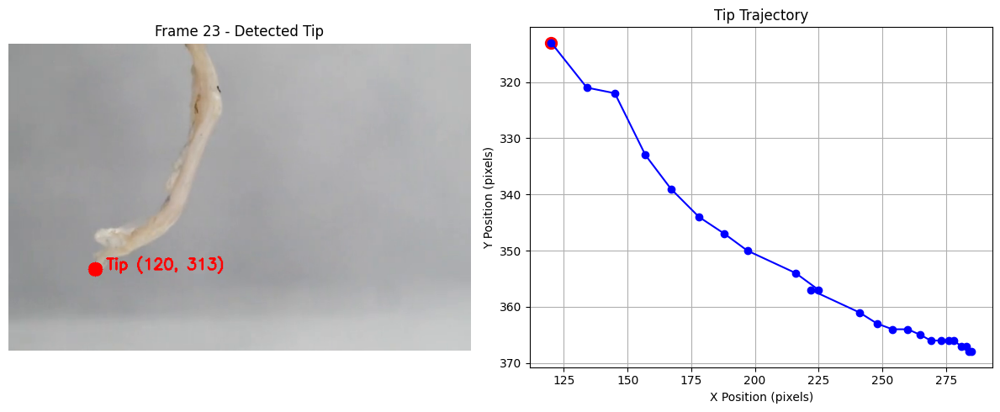


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_047.png: 1024x1024 1 0, 8745.3ms
Speed: 22.3ms preprocess, 8745.3ms inference, 2.0ms postprocess per image at shape (1, 3, 1024, 1024)


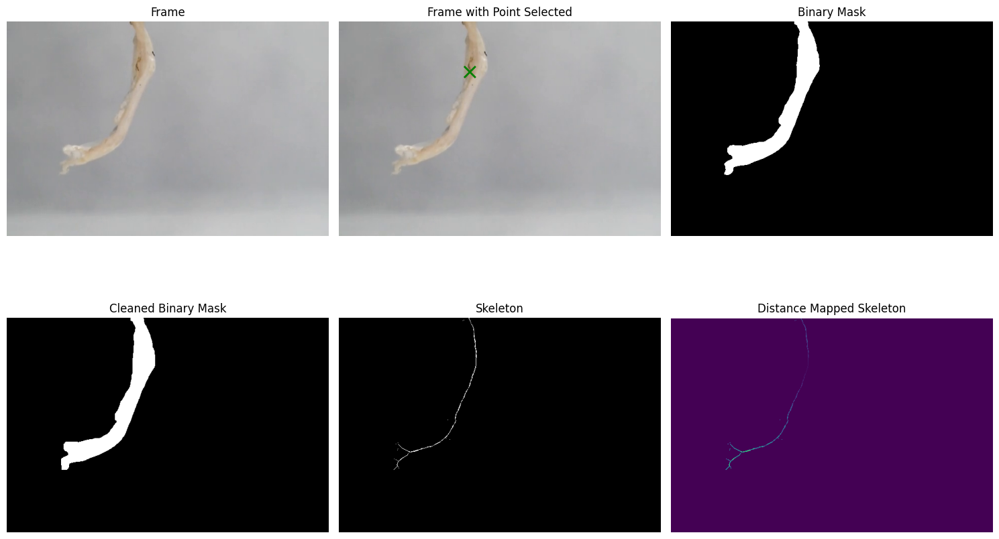

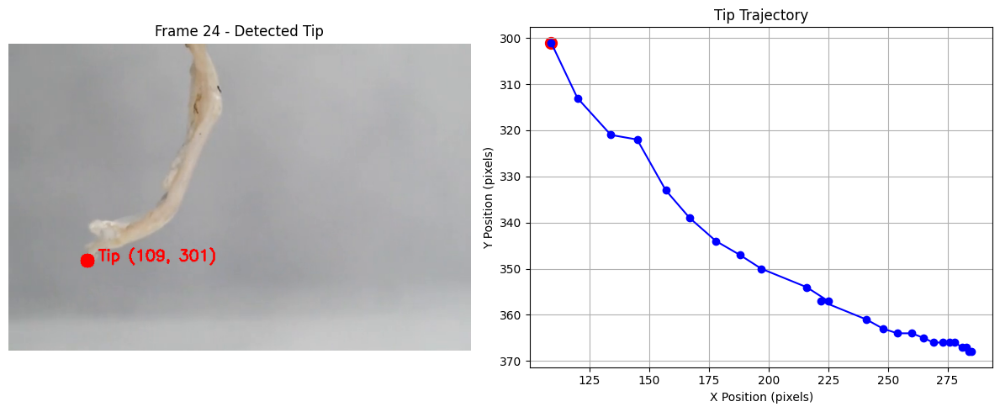


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_048.png: 1024x1024 1 0, 8295.6ms
Speed: 21.5ms preprocess, 8295.6ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


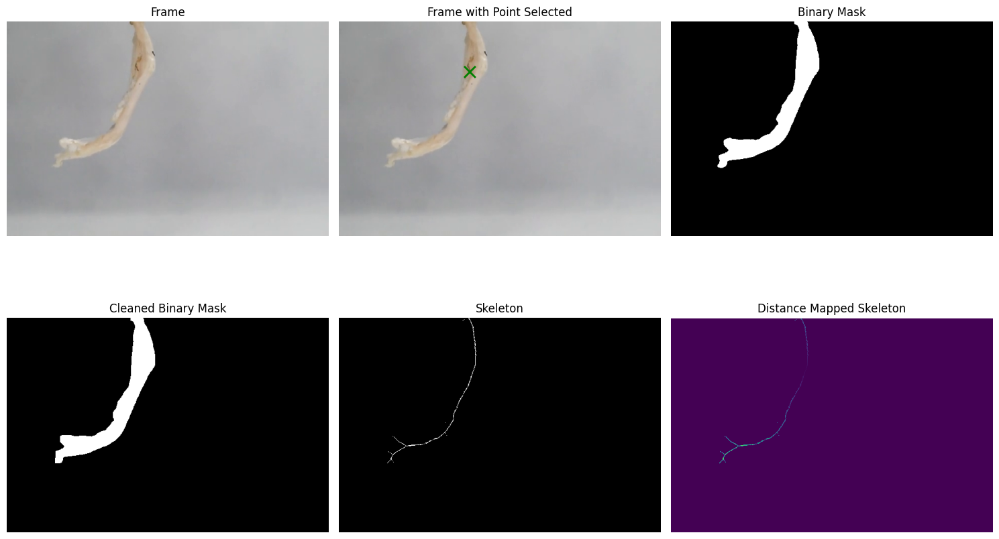

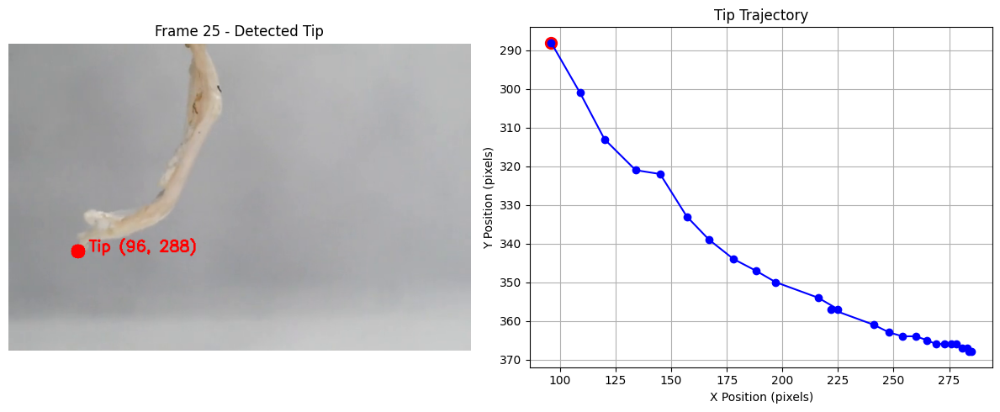


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_049.png: 1024x1024 1 0, 8594.1ms
Speed: 103.7ms preprocess, 8594.1ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)


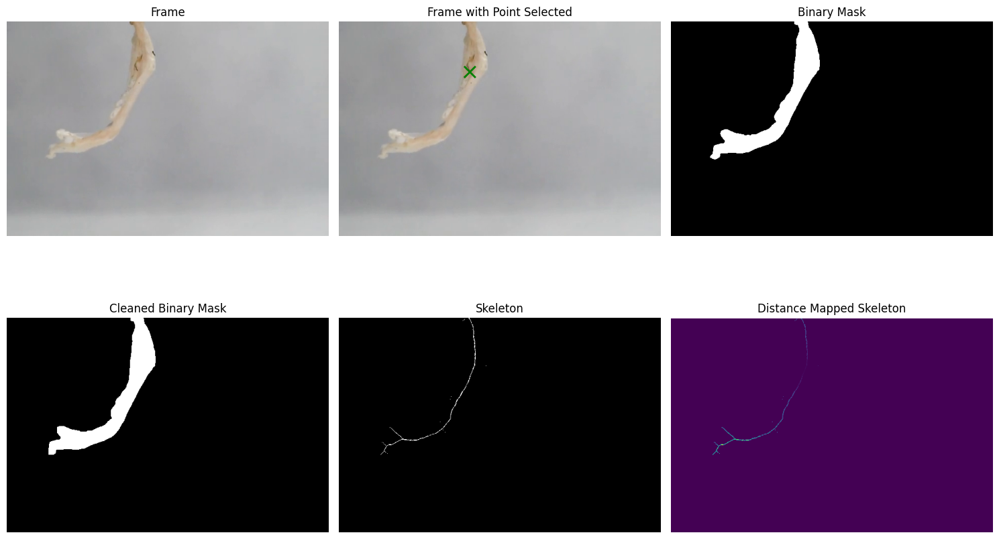

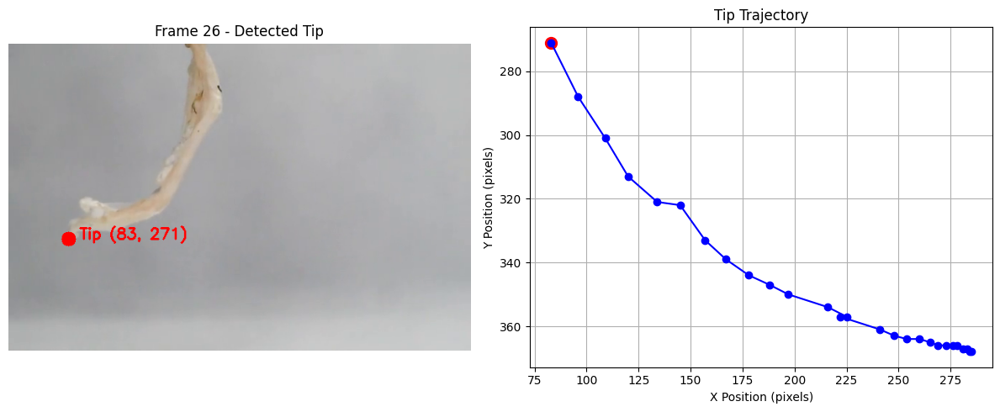


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_050.png: 1024x1024 1 0, 8204.1ms
Speed: 23.5ms preprocess, 8204.1ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


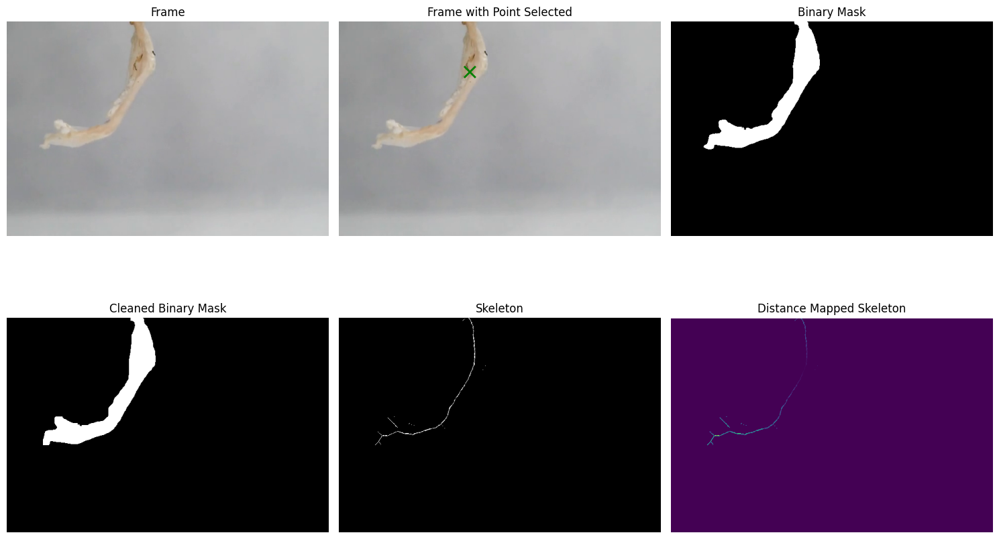

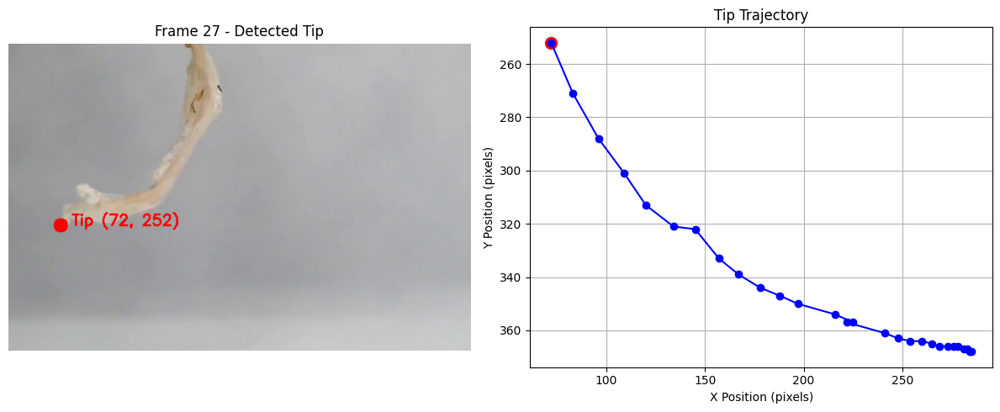


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_051.png: 1024x1024 1 0, 8523.4ms
Speed: 21.1ms preprocess, 8523.4ms inference, 1.5ms postprocess per image at shape (1, 3, 1024, 1024)


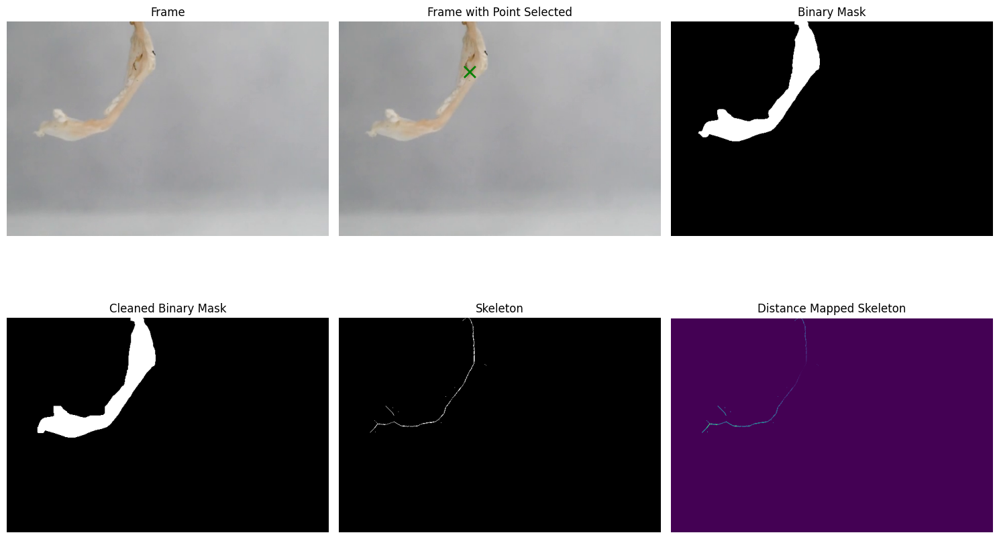

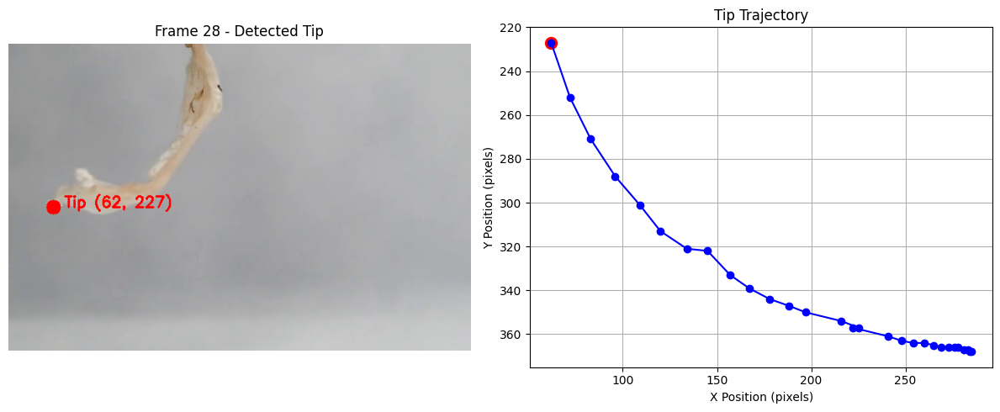


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_052.png: 1024x1024 1 0, 8537.9ms
Speed: 21.0ms preprocess, 8537.9ms inference, 2.5ms postprocess per image at shape (1, 3, 1024, 1024)


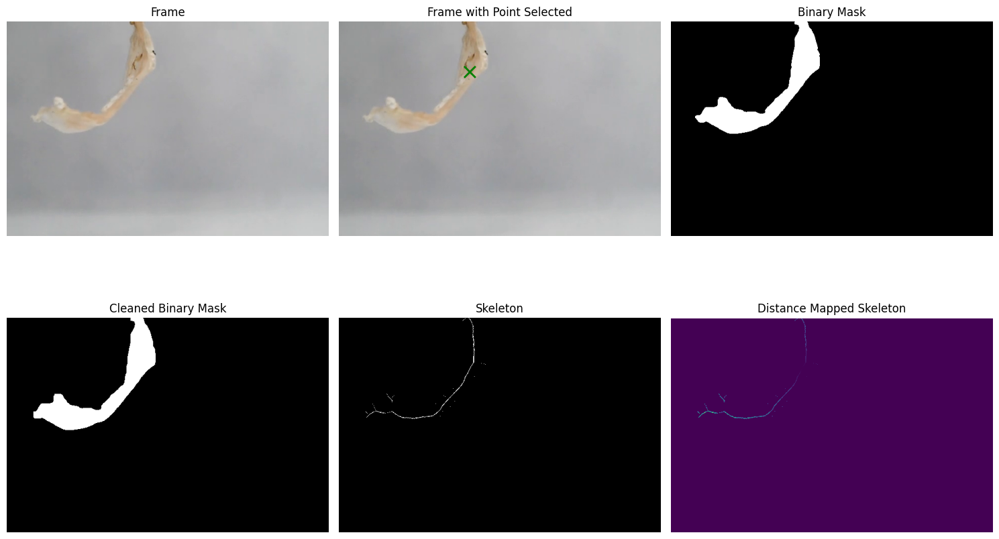

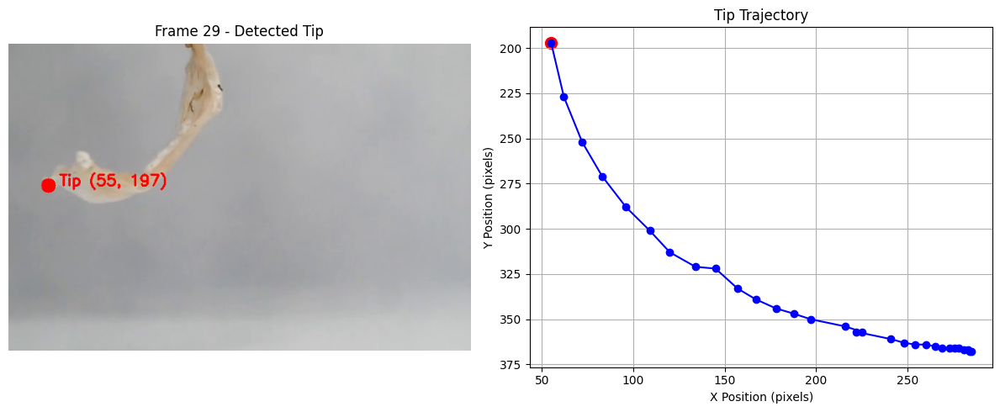


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_053.png: 1024x1024 1 0, 8597.4ms
Speed: 21.5ms preprocess, 8597.4ms inference, 1.9ms postprocess per image at shape (1, 3, 1024, 1024)


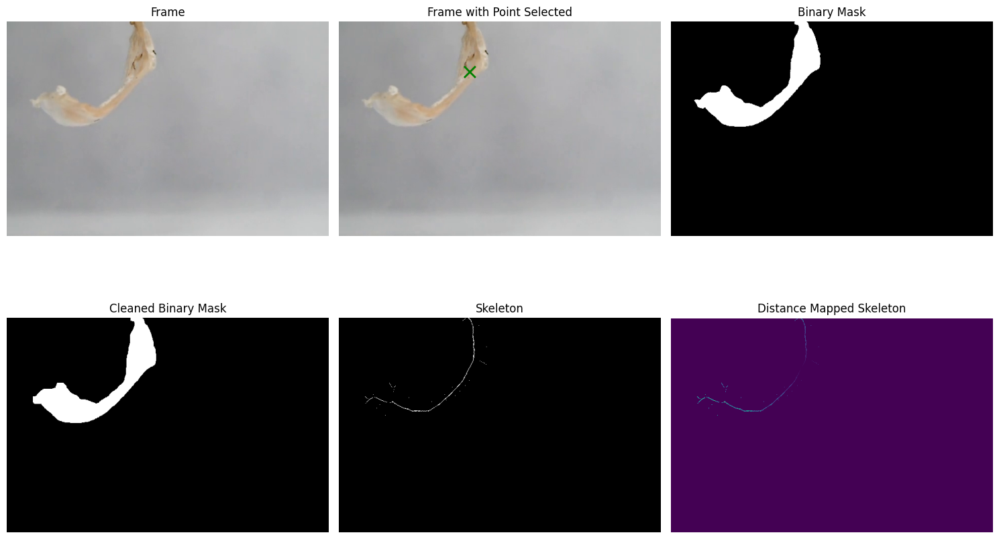

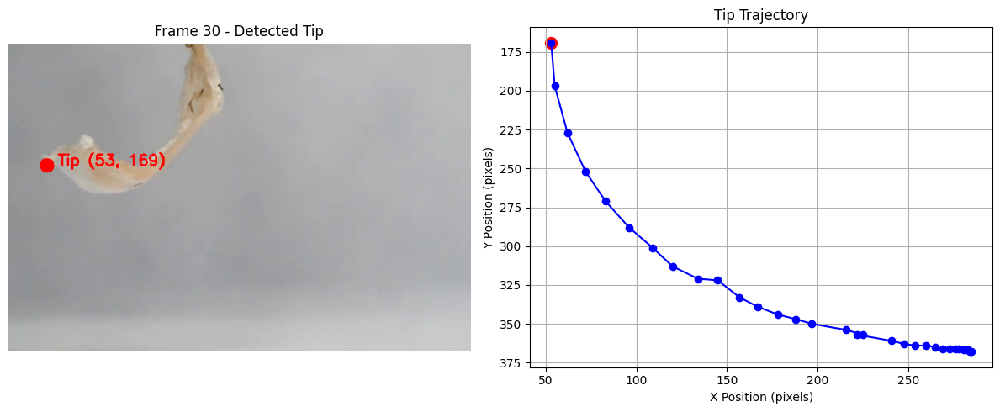


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_054.png: 1024x1024 1 0, 8930.8ms
Speed: 25.3ms preprocess, 8930.8ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


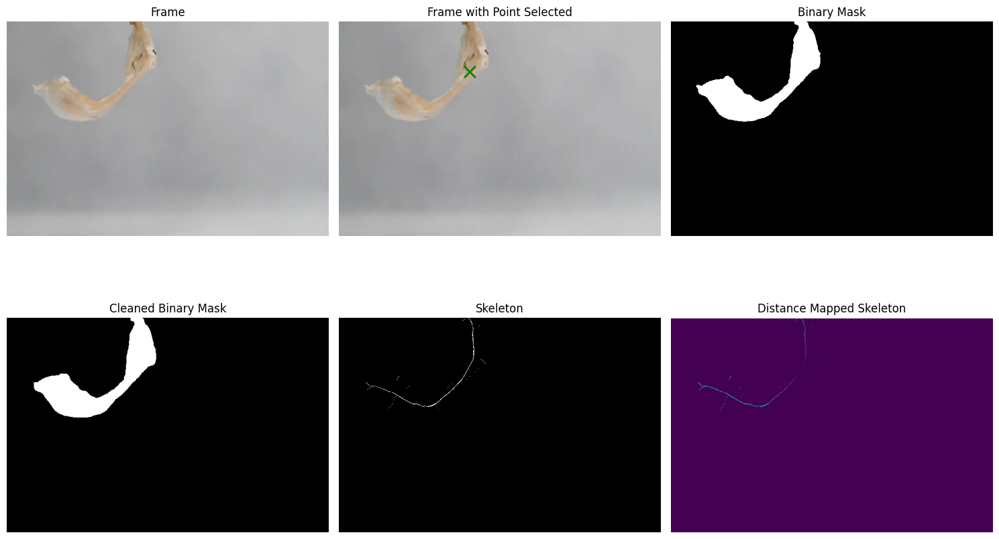

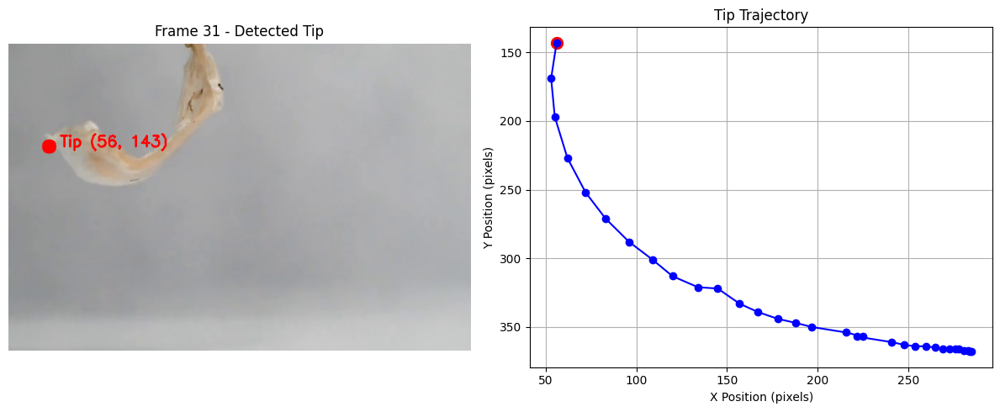


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_055.png: 1024x1024 1 0, 8553.6ms
Speed: 21.5ms preprocess, 8553.6ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


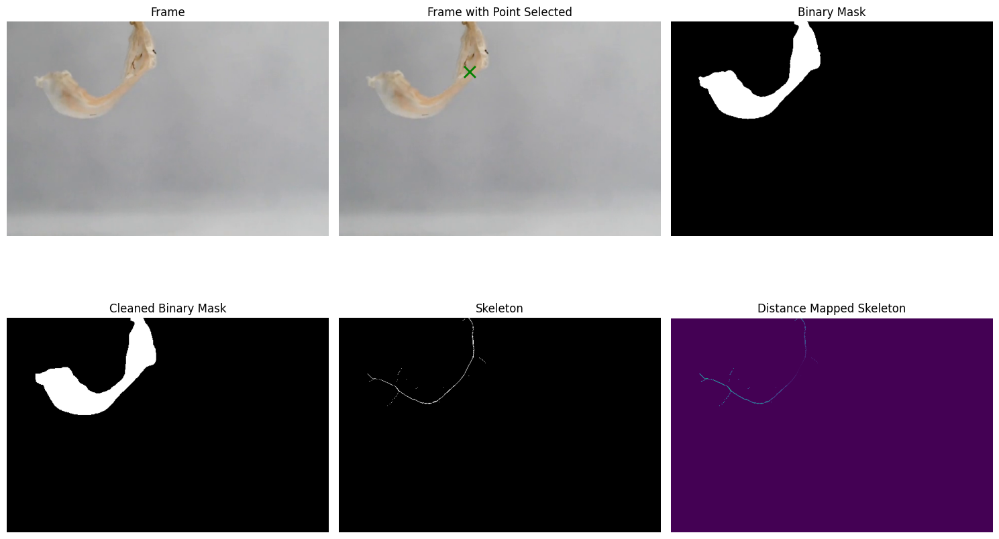

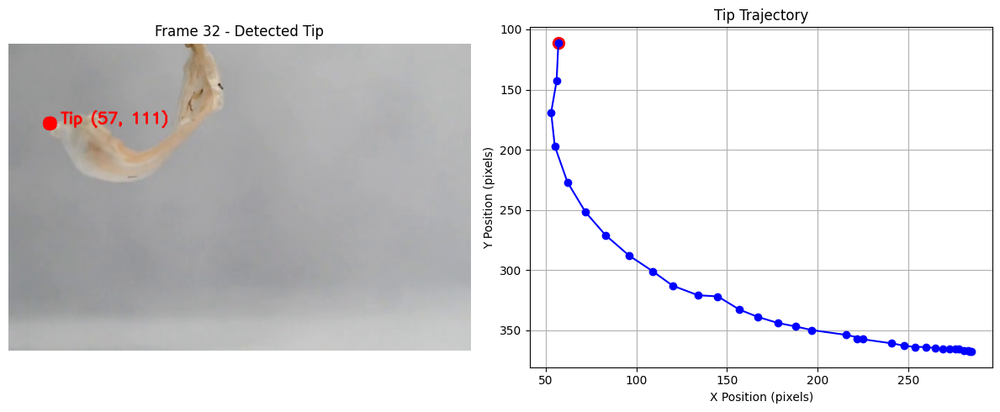


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_056.png: 1024x1024 1 0, 8810.5ms
Speed: 23.4ms preprocess, 8810.5ms inference, 1.7ms postprocess per image at shape (1, 3, 1024, 1024)


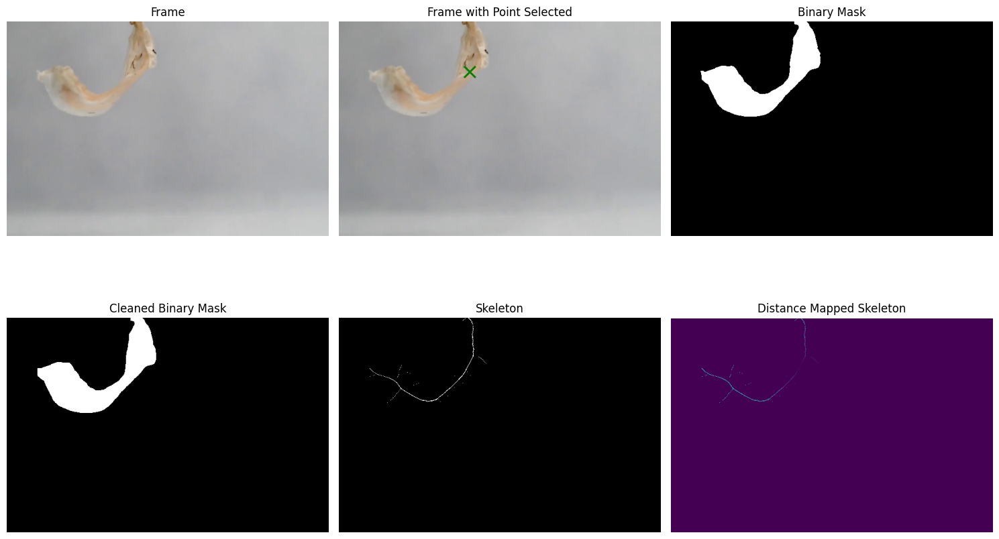

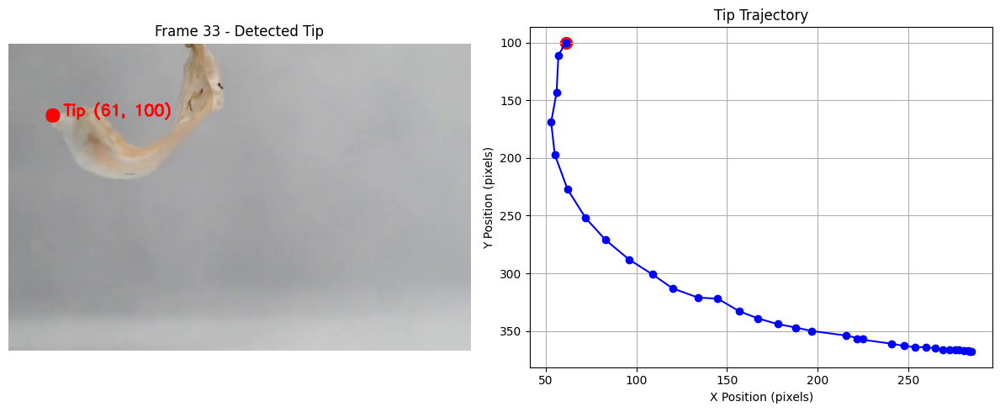


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_057.png: 1024x1024 1 0, 8794.6ms
Speed: 97.7ms preprocess, 8794.6ms inference, 1.6ms postprocess per image at shape (1, 3, 1024, 1024)


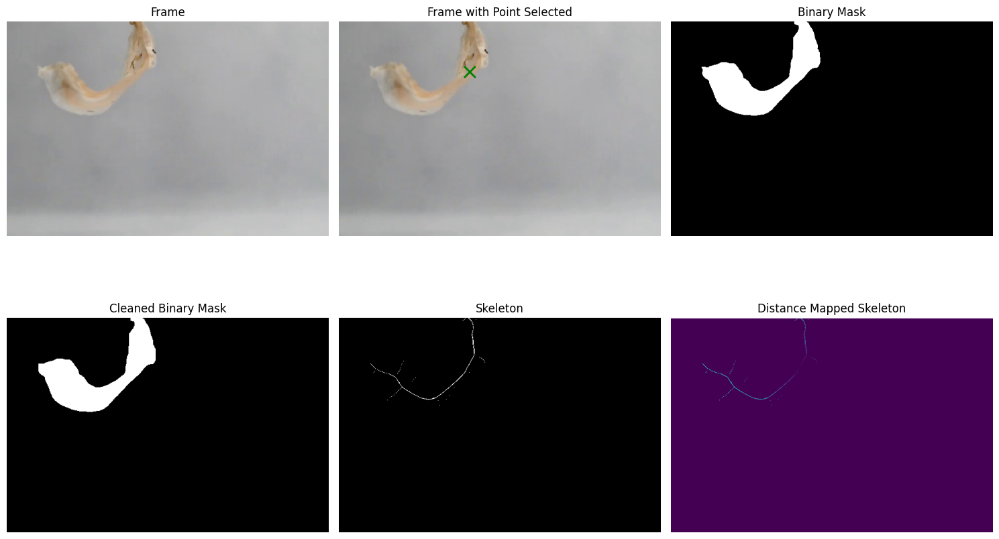

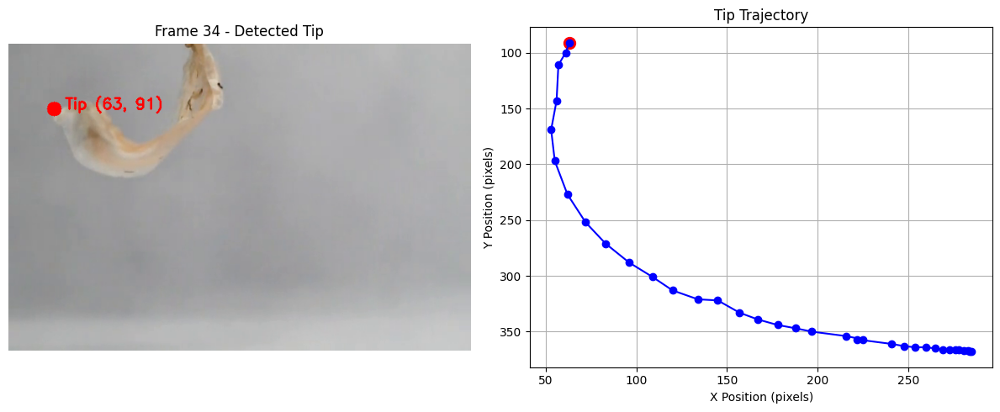


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_058.png: 1024x1024 1 0, 8688.7ms
Speed: 24.5ms preprocess, 8688.7ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


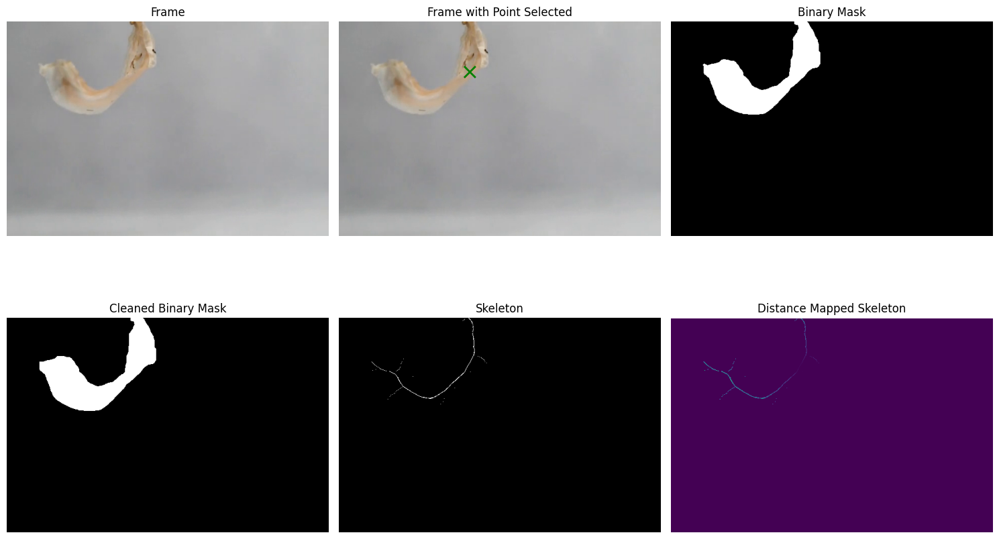

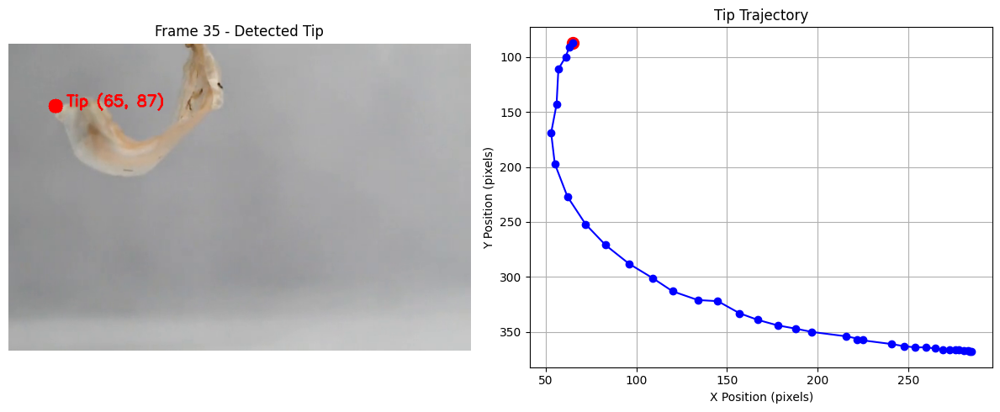


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_059.png: 1024x1024 1 0, 9649.5ms
Speed: 23.6ms preprocess, 9649.5ms inference, 1.8ms postprocess per image at shape (1, 3, 1024, 1024)


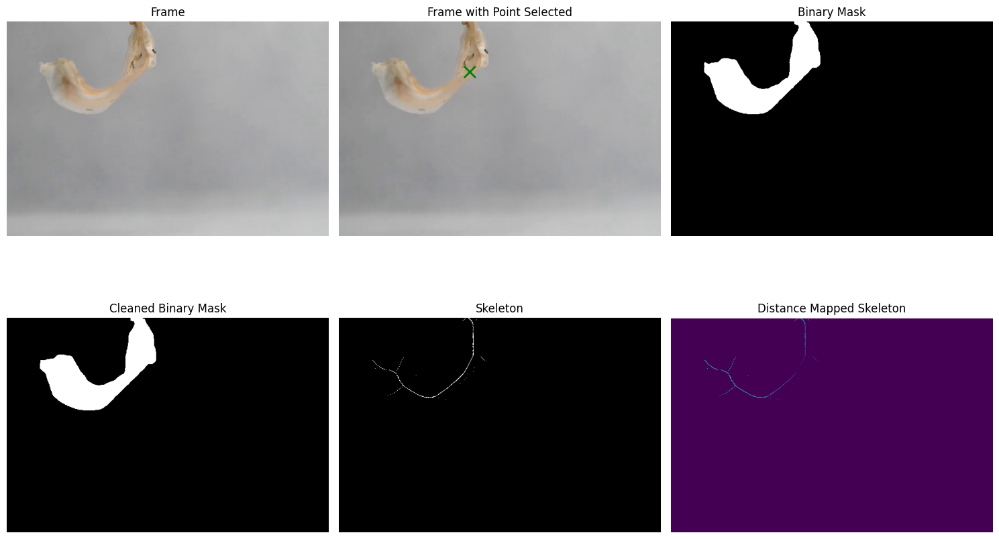

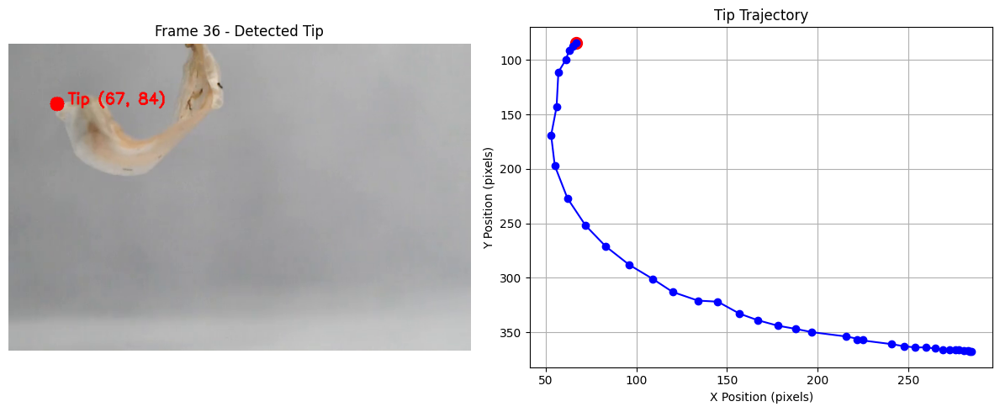


image 1/1 /Users/yitongtseo/Documents/GitHub/cellulose_origami/frames/frame_060.png: 1024x1024 1 0, 9939.5ms
Speed: 24.5ms preprocess, 9939.5ms inference, 1.9ms postprocess per image at shape (1, 3, 1024, 1024)


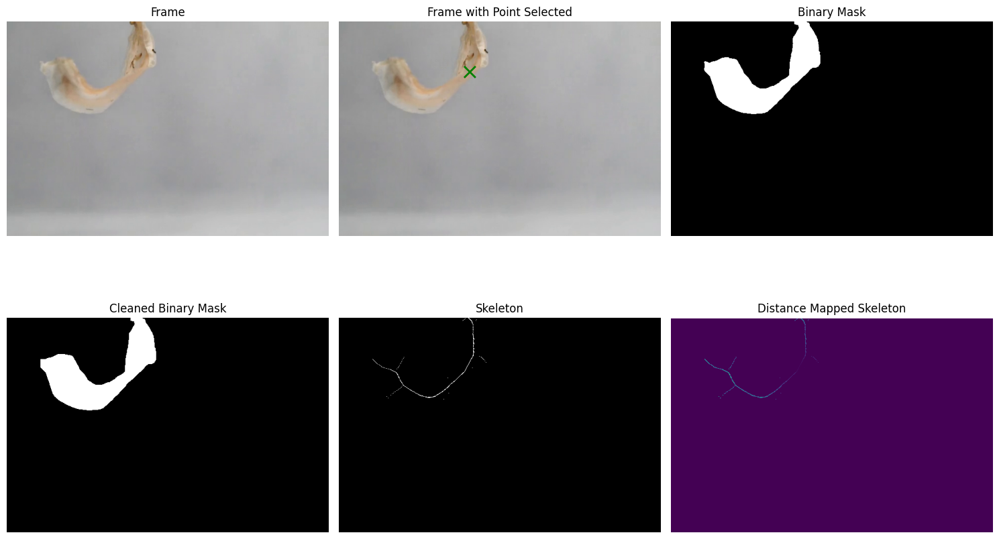

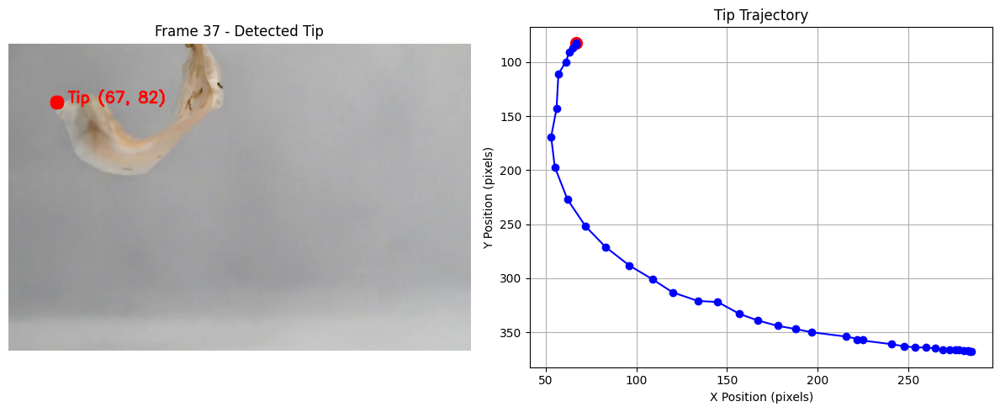

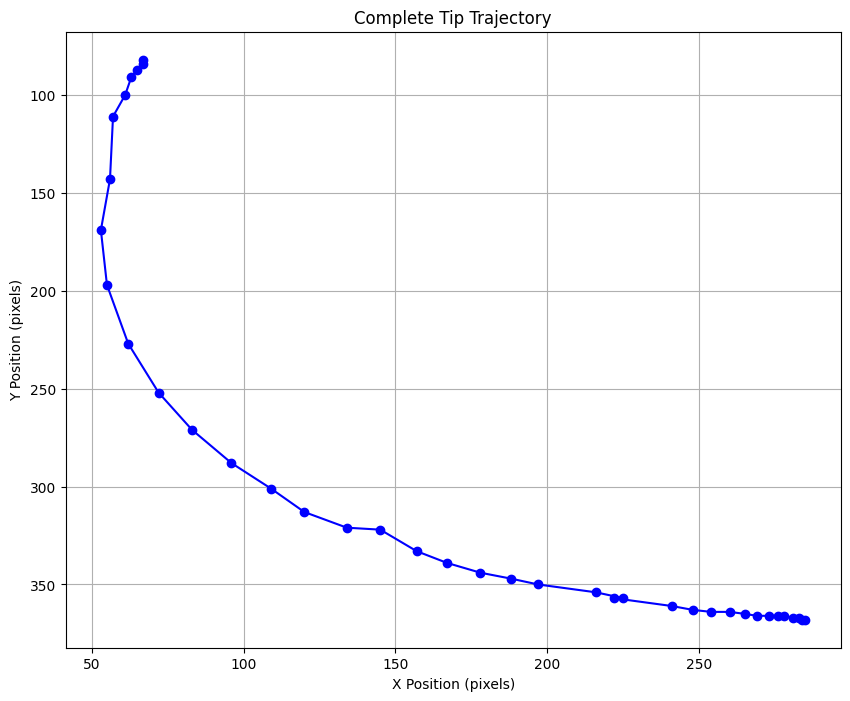

([(285, 368),
  (284, 368),
  (283, 367),
  (281, 367),
  (278, 366),
  (276, 366),
  (273, 366),
  (269, 366),
  (265, 365),
  (260, 364),
  (254, 364),
  (248, 363),
  (241, 361),
  (222, 357),
  (225, 357),
  (216, 354),
  (197, 350),
  (188, 347),
  (178, 344),
  (167, 339),
  (157, 333),
  (145, 322),
  (134, 321),
  (120, 313),
  (109, 301),
  (96, 288),
  (83, 271),
  (72, 252),
  (62, 227),
  (55, 197),
  (53, 169),
  (56, 143),
  (57, 111),
  (61, 100),
  (63, 91),
  (65, 87),
  (67, 84),
  (67, 82)],
 [0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29,
  30,
  31,
  32,
  33,
  34,
  35,
  36,
  37])

In [ ]:
# Set paths
video_name = f"03.21.25_idx1_100x" # without the .mov
video_path = f"bimorph_videos/{video_name}.mov"
temp_folder = "tracking_frames/"
start_frame = 22
end_frame = 60
frame_interval=0.6
point = (260, 100)

extract_frames(video_path, temp_folder, interval=frame_interval)

track_actuator_tip(
    frame_folder=temp_folder,
    start_frame=start_frame,
    end_frame=end_frame,
    output_file=f"tracked_trajectories/{video_name}_tracked.csv",
    anchor_point=point,
)


for filename in os.listdir(temp_folder):
    file_path = os.path.join(temp_folder, filename)
    if os.path.isdir(file_path):
        shutil.rmtree(file_path)
    else:
        os.remove(file_path)